# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: data: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

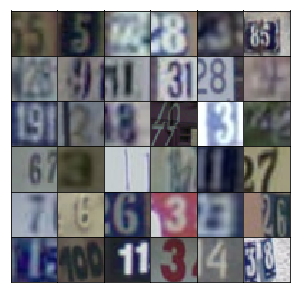

In [6]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [12]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [11]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [10]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [24]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        # 4x4x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        # 8x8x256 now
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        # 16x16x128 now
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        # 32x32x3 now
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [14]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(x1 * alpha, x1)
        # 16x16x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(bn2 * alpha, bn2)
        # 8x8x128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(bn3 * alpha, bn3)
        # 256
        
        # Flatten it
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [16]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [17]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [18]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [19]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [22]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [27]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 0.0786... Generator Loss: 21.1250
Epoch 1/25... Discriminator Loss: 0.6158... Generator Loss: 20.3431
Epoch 1/25... Discriminator Loss: 3.1592... Generator Loss: 0.4881
Epoch 1/25... Discriminator Loss: 1.3892... Generator Loss: 1.2397
Epoch 1/25... Discriminator Loss: 1.3052... Generator Loss: 2.2178
Epoch 1/25... Discriminator Loss: 0.7538... Generator Loss: 1.2110
Epoch 1/25... Discriminator Loss: 0.4999... Generator Loss: 1.6332
Epoch 1/25... Discriminator Loss: 0.8366... Generator Loss: 1.2615
Epoch 1/25... Discriminator Loss: 0.6858... Generator Loss: 1.3174
Epoch 1/25... Discriminator Loss: 3.5080... Generator Loss: 0.0606


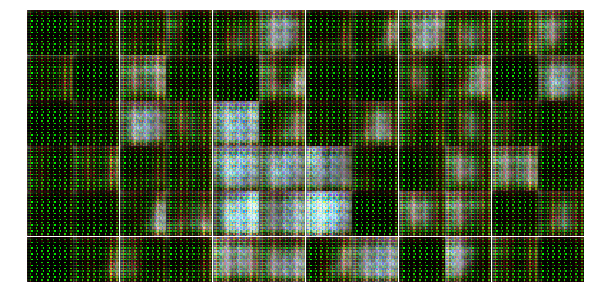

Epoch 1/25... Discriminator Loss: 1.2010... Generator Loss: 1.0438
Epoch 1/25... Discriminator Loss: 1.2029... Generator Loss: 1.1163
Epoch 1/25... Discriminator Loss: 1.3857... Generator Loss: 0.6998
Epoch 1/25... Discriminator Loss: 1.0764... Generator Loss: 1.0820
Epoch 1/25... Discriminator Loss: 1.5213... Generator Loss: 1.0590
Epoch 1/25... Discriminator Loss: 2.0052... Generator Loss: 2.7610
Epoch 1/25... Discriminator Loss: 0.8233... Generator Loss: 5.0501
Epoch 1/25... Discriminator Loss: 1.2160... Generator Loss: 1.0720
Epoch 1/25... Discriminator Loss: 1.2451... Generator Loss: 0.9865
Epoch 1/25... Discriminator Loss: 1.0917... Generator Loss: 3.1420


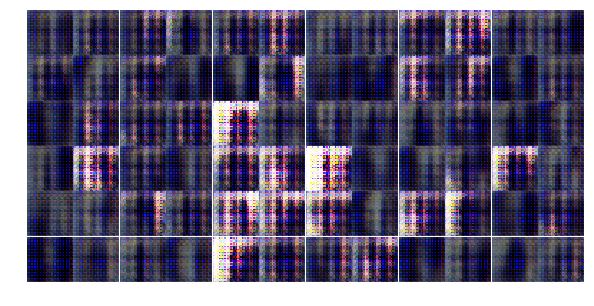

Epoch 1/25... Discriminator Loss: 1.7676... Generator Loss: 0.2351
Epoch 1/25... Discriminator Loss: 1.4492... Generator Loss: 0.5517
Epoch 1/25... Discriminator Loss: 0.7657... Generator Loss: 0.9813
Epoch 1/25... Discriminator Loss: 1.3222... Generator Loss: 1.0816
Epoch 1/25... Discriminator Loss: 0.6908... Generator Loss: 1.4801
Epoch 1/25... Discriminator Loss: 3.6238... Generator Loss: 3.7387
Epoch 1/25... Discriminator Loss: 1.0004... Generator Loss: 1.1562
Epoch 1/25... Discriminator Loss: 1.4370... Generator Loss: 0.6488
Epoch 1/25... Discriminator Loss: 1.0996... Generator Loss: 0.8997
Epoch 1/25... Discriminator Loss: 1.3747... Generator Loss: 1.0834


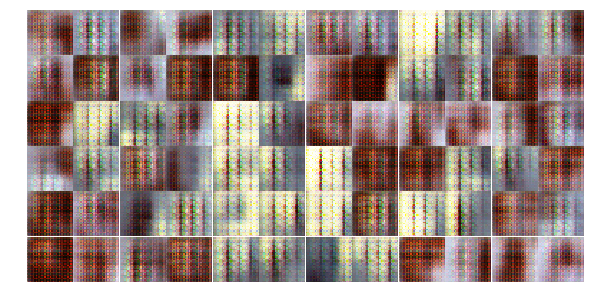

Epoch 1/25... Discriminator Loss: 1.1818... Generator Loss: 1.1889
Epoch 1/25... Discriminator Loss: 1.0758... Generator Loss: 0.8593
Epoch 1/25... Discriminator Loss: 2.1206... Generator Loss: 0.4993
Epoch 1/25... Discriminator Loss: 1.3298... Generator Loss: 1.1164
Epoch 1/25... Discriminator Loss: 1.2139... Generator Loss: 0.8126
Epoch 1/25... Discriminator Loss: 1.1510... Generator Loss: 0.8335
Epoch 1/25... Discriminator Loss: 1.0880... Generator Loss: 2.5094
Epoch 1/25... Discriminator Loss: 1.4444... Generator Loss: 0.8082
Epoch 1/25... Discriminator Loss: 0.9467... Generator Loss: 1.1540
Epoch 1/25... Discriminator Loss: 0.6886... Generator Loss: 1.3215


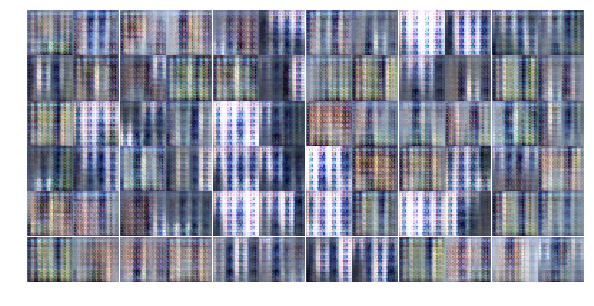

Epoch 1/25... Discriminator Loss: 1.7395... Generator Loss: 2.4947
Epoch 1/25... Discriminator Loss: 1.1655... Generator Loss: 1.0642
Epoch 1/25... Discriminator Loss: 1.1704... Generator Loss: 0.7434
Epoch 1/25... Discriminator Loss: 0.9819... Generator Loss: 0.8736
Epoch 1/25... Discriminator Loss: 1.0944... Generator Loss: 1.2358
Epoch 1/25... Discriminator Loss: 0.9914... Generator Loss: 0.9785
Epoch 1/25... Discriminator Loss: 1.5853... Generator Loss: 1.0155
Epoch 1/25... Discriminator Loss: 1.0940... Generator Loss: 1.1398
Epoch 1/25... Discriminator Loss: 1.1124... Generator Loss: 0.8625
Epoch 1/25... Discriminator Loss: 1.3645... Generator Loss: 0.9244


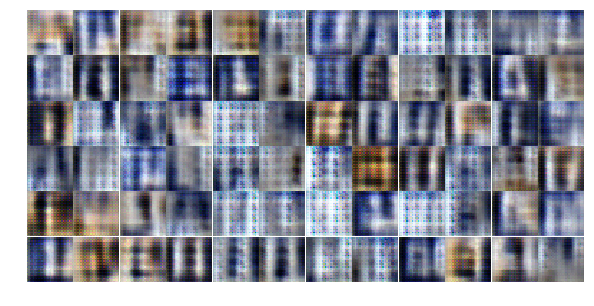

Epoch 1/25... Discriminator Loss: 1.4235... Generator Loss: 0.6535
Epoch 1/25... Discriminator Loss: 0.8825... Generator Loss: 1.4706
Epoch 1/25... Discriminator Loss: 1.0170... Generator Loss: 1.0529
Epoch 1/25... Discriminator Loss: 2.3243... Generator Loss: 0.1490
Epoch 1/25... Discriminator Loss: 1.2273... Generator Loss: 0.7339
Epoch 1/25... Discriminator Loss: 1.3474... Generator Loss: 0.6614
Epoch 1/25... Discriminator Loss: 1.2954... Generator Loss: 0.6562
Epoch 2/25... Discriminator Loss: 1.1847... Generator Loss: 1.0693
Epoch 2/25... Discriminator Loss: 1.3864... Generator Loss: 0.4095
Epoch 2/25... Discriminator Loss: 1.1694... Generator Loss: 1.1028


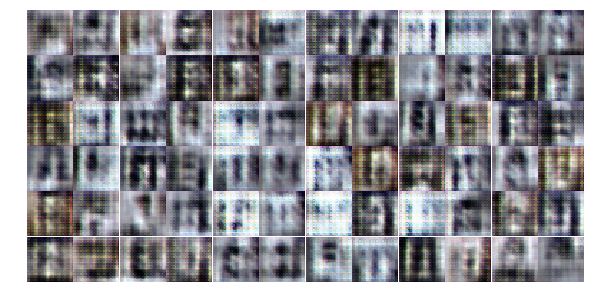

Epoch 2/25... Discriminator Loss: 1.1539... Generator Loss: 0.7489
Epoch 2/25... Discriminator Loss: 1.2042... Generator Loss: 0.9472
Epoch 2/25... Discriminator Loss: 1.0562... Generator Loss: 1.5153
Epoch 2/25... Discriminator Loss: 1.0379... Generator Loss: 0.7486
Epoch 2/25... Discriminator Loss: 1.2883... Generator Loss: 0.6035
Epoch 2/25... Discriminator Loss: 1.0674... Generator Loss: 0.9789
Epoch 2/25... Discriminator Loss: 1.2182... Generator Loss: 1.4725
Epoch 2/25... Discriminator Loss: 1.3663... Generator Loss: 0.8858
Epoch 2/25... Discriminator Loss: 0.9101... Generator Loss: 0.9099
Epoch 2/25... Discriminator Loss: 1.4708... Generator Loss: 0.5645


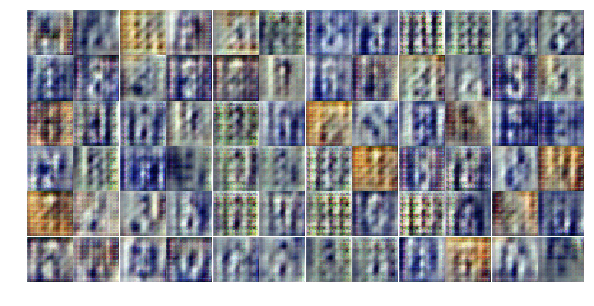

Epoch 2/25... Discriminator Loss: 1.2178... Generator Loss: 0.9428
Epoch 2/25... Discriminator Loss: 1.2739... Generator Loss: 0.8762
Epoch 2/25... Discriminator Loss: 1.1364... Generator Loss: 1.1589
Epoch 2/25... Discriminator Loss: 0.9684... Generator Loss: 1.0584
Epoch 2/25... Discriminator Loss: 0.7945... Generator Loss: 1.2000
Epoch 2/25... Discriminator Loss: 1.0552... Generator Loss: 0.9060
Epoch 2/25... Discriminator Loss: 2.0786... Generator Loss: 0.2253
Epoch 2/25... Discriminator Loss: 1.2797... Generator Loss: 0.9061
Epoch 2/25... Discriminator Loss: 1.3073... Generator Loss: 1.1592
Epoch 2/25... Discriminator Loss: 1.3093... Generator Loss: 0.7276


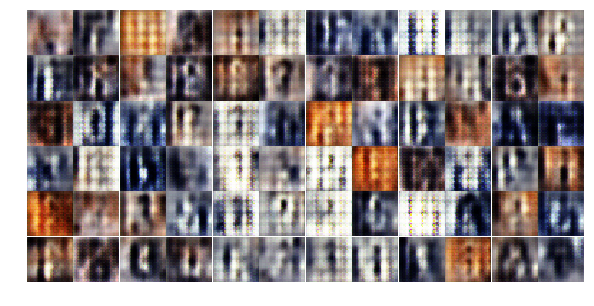

Epoch 2/25... Discriminator Loss: 1.5242... Generator Loss: 0.8506
Epoch 2/25... Discriminator Loss: 1.1428... Generator Loss: 1.1749
Epoch 2/25... Discriminator Loss: 1.3955... Generator Loss: 0.6981
Epoch 2/25... Discriminator Loss: 1.2015... Generator Loss: 0.6367
Epoch 2/25... Discriminator Loss: 1.2443... Generator Loss: 0.7824
Epoch 2/25... Discriminator Loss: 1.2277... Generator Loss: 1.2943
Epoch 2/25... Discriminator Loss: 1.4763... Generator Loss: 0.5380
Epoch 2/25... Discriminator Loss: 1.3937... Generator Loss: 1.1742
Epoch 2/25... Discriminator Loss: 1.3709... Generator Loss: 0.6777
Epoch 2/25... Discriminator Loss: 1.1015... Generator Loss: 0.9088


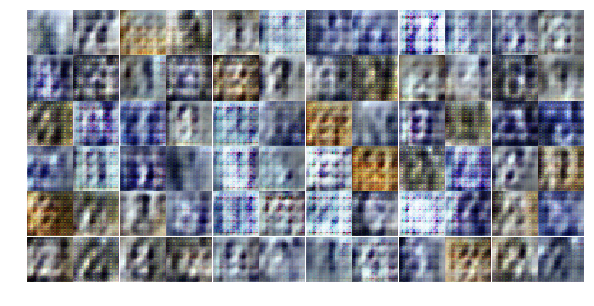

Epoch 2/25... Discriminator Loss: 1.2391... Generator Loss: 0.9974
Epoch 2/25... Discriminator Loss: 0.8882... Generator Loss: 1.2049
Epoch 2/25... Discriminator Loss: 1.2933... Generator Loss: 0.7701
Epoch 2/25... Discriminator Loss: 0.9642... Generator Loss: 0.9644
Epoch 2/25... Discriminator Loss: 1.0533... Generator Loss: 1.0365
Epoch 2/25... Discriminator Loss: 1.2047... Generator Loss: 0.8646
Epoch 2/25... Discriminator Loss: 1.2852... Generator Loss: 1.0983
Epoch 2/25... Discriminator Loss: 1.2775... Generator Loss: 1.1689
Epoch 2/25... Discriminator Loss: 1.0810... Generator Loss: 1.0025
Epoch 2/25... Discriminator Loss: 1.0930... Generator Loss: 1.2313


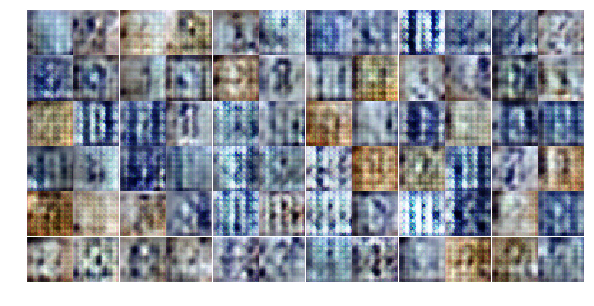

Epoch 2/25... Discriminator Loss: 1.0412... Generator Loss: 0.6123
Epoch 2/25... Discriminator Loss: 1.3680... Generator Loss: 0.9472
Epoch 2/25... Discriminator Loss: 1.0796... Generator Loss: 0.9594
Epoch 2/25... Discriminator Loss: 1.1818... Generator Loss: 1.0284
Epoch 2/25... Discriminator Loss: 1.2261... Generator Loss: 1.0462
Epoch 2/25... Discriminator Loss: 1.5250... Generator Loss: 0.5180
Epoch 2/25... Discriminator Loss: 1.2652... Generator Loss: 1.7599
Epoch 2/25... Discriminator Loss: 1.0955... Generator Loss: 0.8490
Epoch 2/25... Discriminator Loss: 1.1073... Generator Loss: 1.0131
Epoch 2/25... Discriminator Loss: 1.2484... Generator Loss: 0.9407


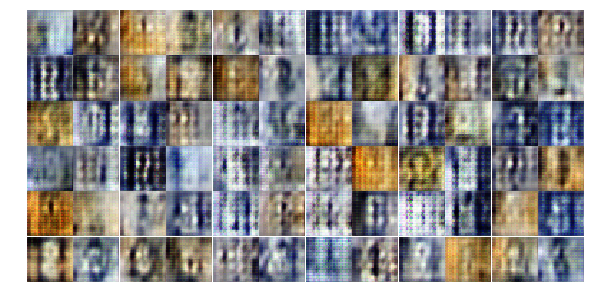

Epoch 2/25... Discriminator Loss: 1.0973... Generator Loss: 0.8562
Epoch 2/25... Discriminator Loss: 0.7132... Generator Loss: 1.0405
Epoch 2/25... Discriminator Loss: 1.8106... Generator Loss: 0.4846
Epoch 2/25... Discriminator Loss: 1.2222... Generator Loss: 1.0473
Epoch 3/25... Discriminator Loss: 0.9464... Generator Loss: 1.3370
Epoch 3/25... Discriminator Loss: 1.2403... Generator Loss: 1.0947
Epoch 3/25... Discriminator Loss: 1.5117... Generator Loss: 1.7556
Epoch 3/25... Discriminator Loss: 1.1639... Generator Loss: 0.7621
Epoch 3/25... Discriminator Loss: 1.2153... Generator Loss: 0.9888
Epoch 3/25... Discriminator Loss: 1.2059... Generator Loss: 1.2512


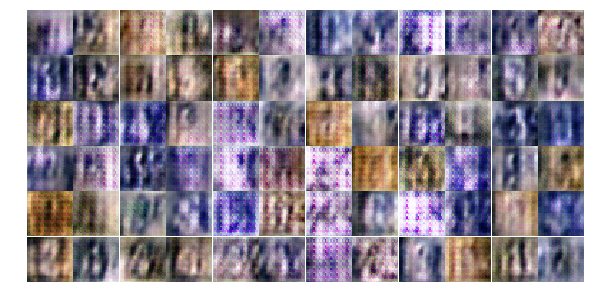

Epoch 3/25... Discriminator Loss: 1.4037... Generator Loss: 0.6073
Epoch 3/25... Discriminator Loss: 2.2683... Generator Loss: 2.3981
Epoch 3/25... Discriminator Loss: 1.3599... Generator Loss: 1.2109
Epoch 3/25... Discriminator Loss: 1.3139... Generator Loss: 0.7057
Epoch 3/25... Discriminator Loss: 1.1902... Generator Loss: 0.6028
Epoch 3/25... Discriminator Loss: 1.0853... Generator Loss: 1.1495
Epoch 3/25... Discriminator Loss: 0.8699... Generator Loss: 0.9737
Epoch 3/25... Discriminator Loss: 1.2004... Generator Loss: 0.7939
Epoch 3/25... Discriminator Loss: 1.1894... Generator Loss: 0.8274
Epoch 3/25... Discriminator Loss: 1.2398... Generator Loss: 1.2478


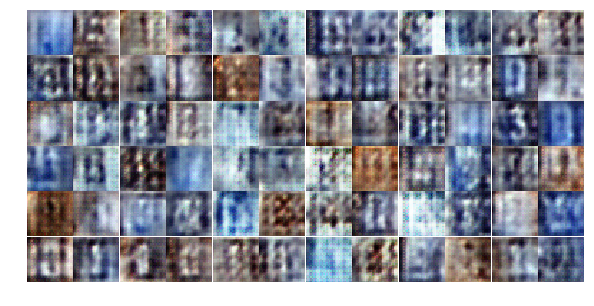

Epoch 3/25... Discriminator Loss: 1.4970... Generator Loss: 0.5661
Epoch 3/25... Discriminator Loss: 1.1874... Generator Loss: 0.6938
Epoch 3/25... Discriminator Loss: 1.2237... Generator Loss: 1.0402
Epoch 3/25... Discriminator Loss: 1.2449... Generator Loss: 0.7400
Epoch 3/25... Discriminator Loss: 0.9906... Generator Loss: 1.1649
Epoch 3/25... Discriminator Loss: 0.9973... Generator Loss: 1.3354
Epoch 3/25... Discriminator Loss: 1.0877... Generator Loss: 0.8810
Epoch 3/25... Discriminator Loss: 1.1050... Generator Loss: 0.9345
Epoch 3/25... Discriminator Loss: 1.2307... Generator Loss: 1.1152
Epoch 3/25... Discriminator Loss: 1.2923... Generator Loss: 0.7968


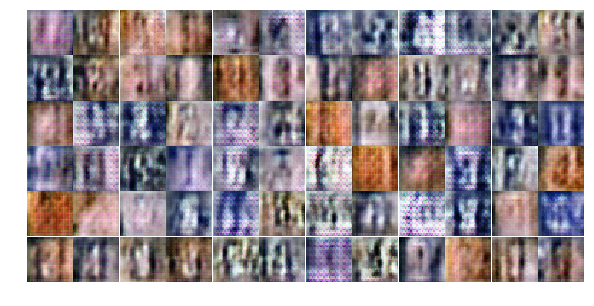

Epoch 3/25... Discriminator Loss: 1.2586... Generator Loss: 0.7640
Epoch 3/25... Discriminator Loss: 1.1183... Generator Loss: 0.9006
Epoch 3/25... Discriminator Loss: 1.1343... Generator Loss: 0.7768
Epoch 3/25... Discriminator Loss: 1.1180... Generator Loss: 0.9886
Epoch 3/25... Discriminator Loss: 1.3983... Generator Loss: 0.7515
Epoch 3/25... Discriminator Loss: 1.1680... Generator Loss: 0.6658
Epoch 3/25... Discriminator Loss: 1.3512... Generator Loss: 0.5686
Epoch 3/25... Discriminator Loss: 1.4626... Generator Loss: 0.7513
Epoch 3/25... Discriminator Loss: 1.0590... Generator Loss: 1.0441
Epoch 3/25... Discriminator Loss: 1.1783... Generator Loss: 0.8681


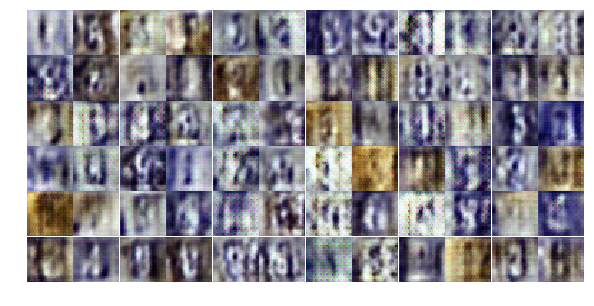

Epoch 3/25... Discriminator Loss: 1.2336... Generator Loss: 1.1699
Epoch 3/25... Discriminator Loss: 1.1473... Generator Loss: 0.9928
Epoch 3/25... Discriminator Loss: 1.1369... Generator Loss: 1.4478
Epoch 3/25... Discriminator Loss: 1.3464... Generator Loss: 1.0041
Epoch 3/25... Discriminator Loss: 1.2788... Generator Loss: 1.4468
Epoch 3/25... Discriminator Loss: 1.0439... Generator Loss: 0.8300
Epoch 3/25... Discriminator Loss: 0.9950... Generator Loss: 1.3883
Epoch 3/25... Discriminator Loss: 1.1187... Generator Loss: 1.0952
Epoch 3/25... Discriminator Loss: 1.1017... Generator Loss: 0.9781
Epoch 3/25... Discriminator Loss: 1.2076... Generator Loss: 0.7886


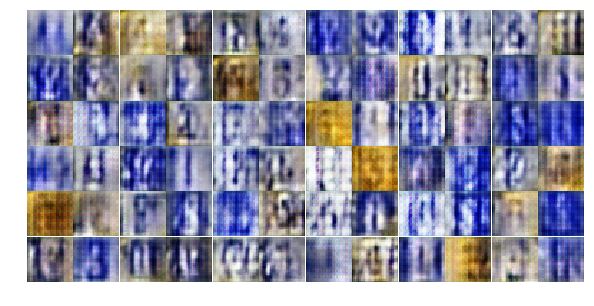

Epoch 3/25... Discriminator Loss: 1.1214... Generator Loss: 1.2446
Epoch 3/25... Discriminator Loss: 0.8714... Generator Loss: 0.9302
Epoch 3/25... Discriminator Loss: 1.2679... Generator Loss: 0.9204
Epoch 3/25... Discriminator Loss: 1.2156... Generator Loss: 0.9252
Epoch 3/25... Discriminator Loss: 1.3448... Generator Loss: 0.5373
Epoch 3/25... Discriminator Loss: 1.0487... Generator Loss: 0.9069
Epoch 3/25... Discriminator Loss: 1.0773... Generator Loss: 0.9661
Epoch 3/25... Discriminator Loss: 1.0238... Generator Loss: 0.8900
Epoch 3/25... Discriminator Loss: 1.1360... Generator Loss: 1.1586
Epoch 3/25... Discriminator Loss: 1.2041... Generator Loss: 0.9093


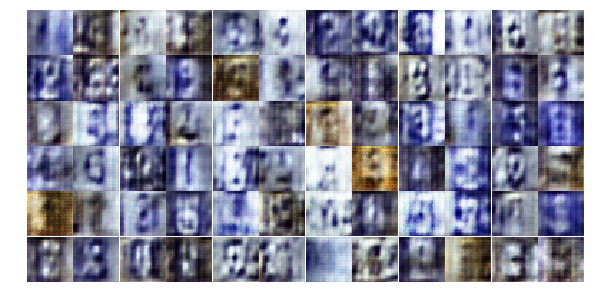

Epoch 3/25... Discriminator Loss: 1.2463... Generator Loss: 0.8729
Epoch 4/25... Discriminator Loss: 1.3015... Generator Loss: 0.5955
Epoch 4/25... Discriminator Loss: 1.1725... Generator Loss: 0.9695
Epoch 4/25... Discriminator Loss: 1.5153... Generator Loss: 0.3497
Epoch 4/25... Discriminator Loss: 1.0277... Generator Loss: 0.8170
Epoch 4/25... Discriminator Loss: 1.1359... Generator Loss: 1.3150
Epoch 4/25... Discriminator Loss: 1.1264... Generator Loss: 1.2098
Epoch 4/25... Discriminator Loss: 1.1972... Generator Loss: 0.6029
Epoch 4/25... Discriminator Loss: 1.0848... Generator Loss: 1.2180
Epoch 4/25... Discriminator Loss: 0.9122... Generator Loss: 1.0668


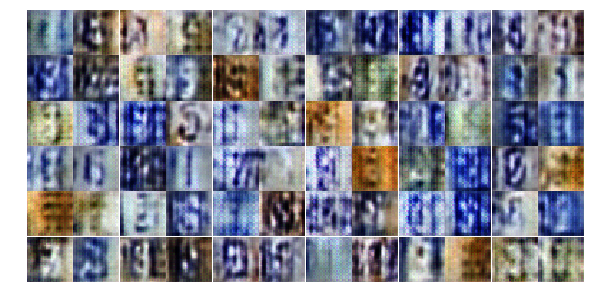

Epoch 4/25... Discriminator Loss: 1.4965... Generator Loss: 0.5539
Epoch 4/25... Discriminator Loss: 1.2478... Generator Loss: 0.6220
Epoch 4/25... Discriminator Loss: 1.0944... Generator Loss: 0.9343
Epoch 4/25... Discriminator Loss: 1.1435... Generator Loss: 1.1335
Epoch 4/25... Discriminator Loss: 0.9704... Generator Loss: 0.8763
Epoch 4/25... Discriminator Loss: 1.1934... Generator Loss: 0.6153
Epoch 4/25... Discriminator Loss: 1.0145... Generator Loss: 0.7687
Epoch 4/25... Discriminator Loss: 1.0041... Generator Loss: 1.1043
Epoch 4/25... Discriminator Loss: 1.0687... Generator Loss: 1.0574
Epoch 4/25... Discriminator Loss: 1.5363... Generator Loss: 0.3681


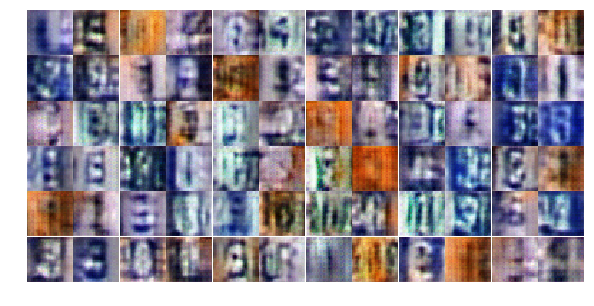

Epoch 4/25... Discriminator Loss: 1.2340... Generator Loss: 0.7753
Epoch 4/25... Discriminator Loss: 1.3566... Generator Loss: 1.1011
Epoch 4/25... Discriminator Loss: 0.9860... Generator Loss: 0.8845
Epoch 4/25... Discriminator Loss: 1.2704... Generator Loss: 0.9111
Epoch 4/25... Discriminator Loss: 1.0410... Generator Loss: 0.7604
Epoch 4/25... Discriminator Loss: 1.5345... Generator Loss: 2.0871
Epoch 4/25... Discriminator Loss: 1.2246... Generator Loss: 0.8328
Epoch 4/25... Discriminator Loss: 1.0422... Generator Loss: 1.2415
Epoch 4/25... Discriminator Loss: 1.4915... Generator Loss: 1.4843
Epoch 4/25... Discriminator Loss: 0.9829... Generator Loss: 1.0025


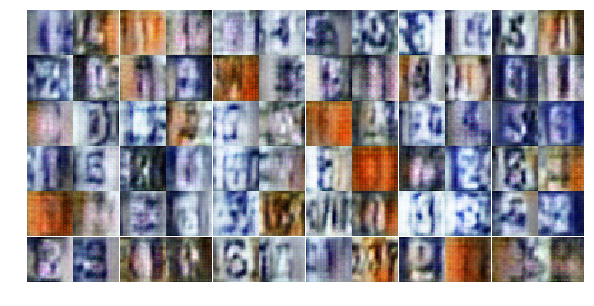

Epoch 4/25... Discriminator Loss: 1.0712... Generator Loss: 0.9148
Epoch 4/25... Discriminator Loss: 1.2990... Generator Loss: 1.0850
Epoch 4/25... Discriminator Loss: 1.0213... Generator Loss: 0.8217
Epoch 4/25... Discriminator Loss: 1.2541... Generator Loss: 1.3210
Epoch 4/25... Discriminator Loss: 1.1679... Generator Loss: 1.3414
Epoch 4/25... Discriminator Loss: 1.2671... Generator Loss: 0.8617
Epoch 4/25... Discriminator Loss: 1.7826... Generator Loss: 0.3147
Epoch 4/25... Discriminator Loss: 1.3743... Generator Loss: 0.7416
Epoch 4/25... Discriminator Loss: 1.2130... Generator Loss: 0.8377
Epoch 4/25... Discriminator Loss: 0.9270... Generator Loss: 1.1290


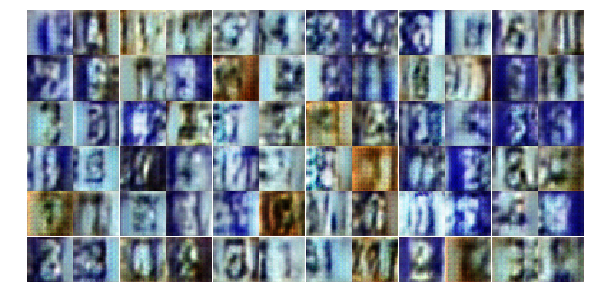

Epoch 4/25... Discriminator Loss: 1.1794... Generator Loss: 0.8094
Epoch 4/25... Discriminator Loss: 1.3261... Generator Loss: 0.5630
Epoch 4/25... Discriminator Loss: 1.4647... Generator Loss: 0.8725
Epoch 4/25... Discriminator Loss: 0.9715... Generator Loss: 1.1583
Epoch 4/25... Discriminator Loss: 0.9599... Generator Loss: 0.9481
Epoch 4/25... Discriminator Loss: 1.1033... Generator Loss: 0.7994
Epoch 4/25... Discriminator Loss: 1.1590... Generator Loss: 0.8248
Epoch 4/25... Discriminator Loss: 1.1594... Generator Loss: 1.1746
Epoch 4/25... Discriminator Loss: 0.9487... Generator Loss: 0.7751
Epoch 4/25... Discriminator Loss: 1.3350... Generator Loss: 0.8057


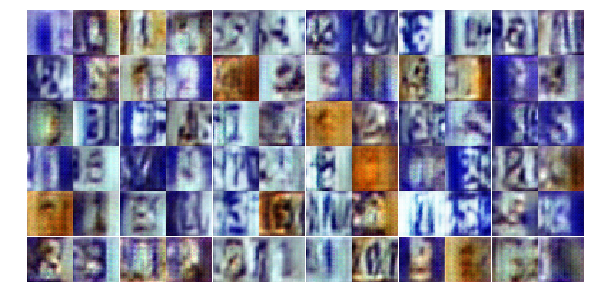

Epoch 4/25... Discriminator Loss: 1.3102... Generator Loss: 1.1972
Epoch 4/25... Discriminator Loss: 1.3881... Generator Loss: 0.8420
Epoch 4/25... Discriminator Loss: 1.0670... Generator Loss: 1.0644
Epoch 4/25... Discriminator Loss: 1.1725... Generator Loss: 0.8131
Epoch 4/25... Discriminator Loss: 1.5290... Generator Loss: 0.4886
Epoch 4/25... Discriminator Loss: 1.2517... Generator Loss: 1.4951
Epoch 4/25... Discriminator Loss: 1.0236... Generator Loss: 1.0424
Epoch 4/25... Discriminator Loss: 1.2507... Generator Loss: 1.3556
Epoch 4/25... Discriminator Loss: 1.2682... Generator Loss: 0.6576
Epoch 5/25... Discriminator Loss: 0.9151... Generator Loss: 1.0010


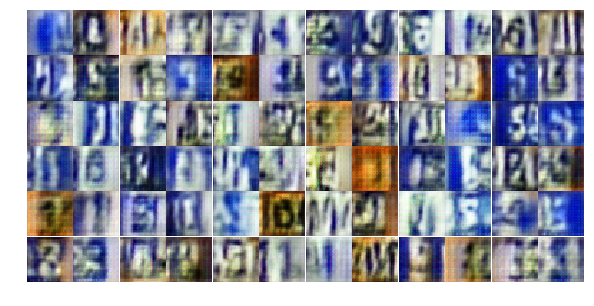

Epoch 5/25... Discriminator Loss: 1.6171... Generator Loss: 0.3651
Epoch 5/25... Discriminator Loss: 1.2818... Generator Loss: 0.5667
Epoch 5/25... Discriminator Loss: 1.1550... Generator Loss: 0.7816
Epoch 5/25... Discriminator Loss: 1.0679... Generator Loss: 1.1309
Epoch 5/25... Discriminator Loss: 1.2763... Generator Loss: 0.7534
Epoch 5/25... Discriminator Loss: 1.2765... Generator Loss: 0.8797
Epoch 5/25... Discriminator Loss: 1.1835... Generator Loss: 0.8515
Epoch 5/25... Discriminator Loss: 1.3237... Generator Loss: 0.6306
Epoch 5/25... Discriminator Loss: 1.4026... Generator Loss: 0.6459
Epoch 5/25... Discriminator Loss: 1.2863... Generator Loss: 0.7470


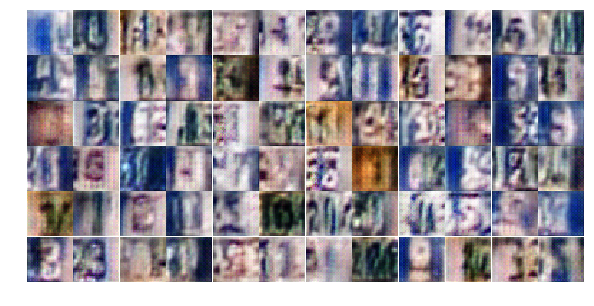

Epoch 5/25... Discriminator Loss: 1.0372... Generator Loss: 0.7761
Epoch 5/25... Discriminator Loss: 1.2378... Generator Loss: 0.6959
Epoch 5/25... Discriminator Loss: 0.8566... Generator Loss: 1.9647
Epoch 5/25... Discriminator Loss: 1.3510... Generator Loss: 0.7773
Epoch 5/25... Discriminator Loss: 1.2958... Generator Loss: 0.6967
Epoch 5/25... Discriminator Loss: 1.2437... Generator Loss: 0.7525
Epoch 5/25... Discriminator Loss: 1.3514... Generator Loss: 0.8137
Epoch 5/25... Discriminator Loss: 1.3372... Generator Loss: 0.8856
Epoch 5/25... Discriminator Loss: 1.2208... Generator Loss: 0.9451
Epoch 5/25... Discriminator Loss: 1.1393... Generator Loss: 0.7805


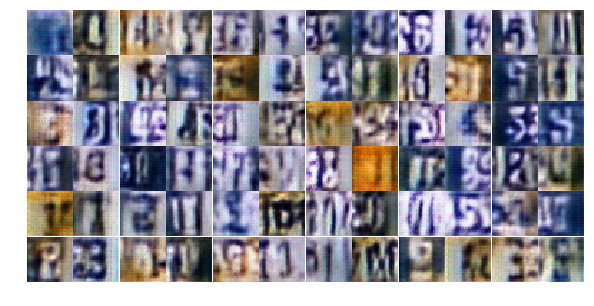

Epoch 5/25... Discriminator Loss: 1.1255... Generator Loss: 1.1913
Epoch 5/25... Discriminator Loss: 1.2640... Generator Loss: 0.8194
Epoch 5/25... Discriminator Loss: 1.2419... Generator Loss: 0.8908
Epoch 5/25... Discriminator Loss: 1.3367... Generator Loss: 0.7046
Epoch 5/25... Discriminator Loss: 1.2593... Generator Loss: 1.0131
Epoch 5/25... Discriminator Loss: 1.1285... Generator Loss: 0.7705
Epoch 5/25... Discriminator Loss: 1.2090... Generator Loss: 0.6761
Epoch 5/25... Discriminator Loss: 1.3780... Generator Loss: 0.5802
Epoch 5/25... Discriminator Loss: 1.1487... Generator Loss: 0.7581
Epoch 5/25... Discriminator Loss: 1.2160... Generator Loss: 1.3126


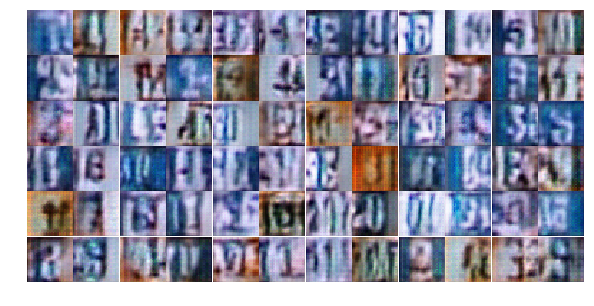

Epoch 5/25... Discriminator Loss: 1.2360... Generator Loss: 0.7314
Epoch 5/25... Discriminator Loss: 1.2545... Generator Loss: 1.4508
Epoch 5/25... Discriminator Loss: 1.0977... Generator Loss: 1.1493
Epoch 5/25... Discriminator Loss: 1.0769... Generator Loss: 1.2312
Epoch 5/25... Discriminator Loss: 1.2462... Generator Loss: 0.7615
Epoch 5/25... Discriminator Loss: 1.1676... Generator Loss: 1.0124
Epoch 5/25... Discriminator Loss: 0.9743... Generator Loss: 0.9550
Epoch 5/25... Discriminator Loss: 1.1765... Generator Loss: 0.6648
Epoch 5/25... Discriminator Loss: 1.0226... Generator Loss: 0.8688
Epoch 5/25... Discriminator Loss: 1.1824... Generator Loss: 0.8061


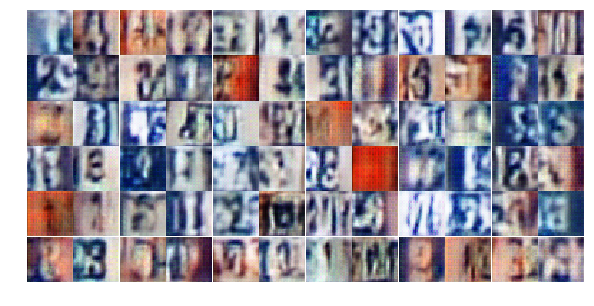

Epoch 5/25... Discriminator Loss: 1.1621... Generator Loss: 0.7652
Epoch 5/25... Discriminator Loss: 1.2524... Generator Loss: 0.5875
Epoch 5/25... Discriminator Loss: 1.2140... Generator Loss: 0.6731
Epoch 5/25... Discriminator Loss: 1.1779... Generator Loss: 1.4522
Epoch 5/25... Discriminator Loss: 1.1094... Generator Loss: 1.0246
Epoch 5/25... Discriminator Loss: 1.2262... Generator Loss: 1.0199
Epoch 5/25... Discriminator Loss: 1.4035... Generator Loss: 0.4433
Epoch 5/25... Discriminator Loss: 1.4372... Generator Loss: 1.1597
Epoch 5/25... Discriminator Loss: 1.0780... Generator Loss: 0.7242
Epoch 5/25... Discriminator Loss: 1.3221... Generator Loss: 1.5578


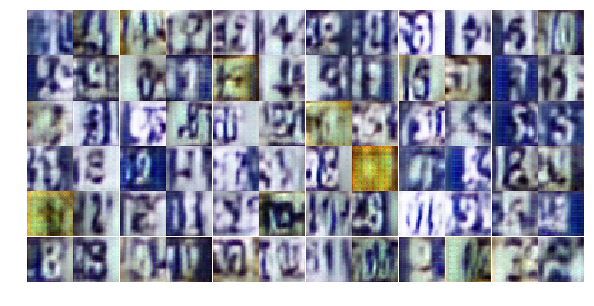

Epoch 5/25... Discriminator Loss: 1.2117... Generator Loss: 0.7418
Epoch 5/25... Discriminator Loss: 1.3345... Generator Loss: 0.4856
Epoch 5/25... Discriminator Loss: 1.2795... Generator Loss: 1.3614
Epoch 5/25... Discriminator Loss: 1.1923... Generator Loss: 0.7765
Epoch 5/25... Discriminator Loss: 1.1154... Generator Loss: 1.5793
Epoch 5/25... Discriminator Loss: 1.1800... Generator Loss: 0.7645
Epoch 6/25... Discriminator Loss: 1.4200... Generator Loss: 1.7671
Epoch 6/25... Discriminator Loss: 1.1569... Generator Loss: 0.7029
Epoch 6/25... Discriminator Loss: 1.3370... Generator Loss: 0.7722
Epoch 6/25... Discriminator Loss: 1.1387... Generator Loss: 0.8347


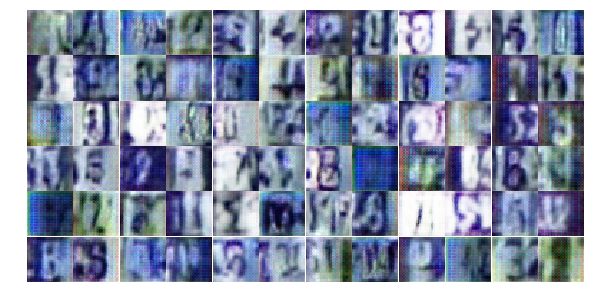

Epoch 6/25... Discriminator Loss: 1.2252... Generator Loss: 0.9740
Epoch 6/25... Discriminator Loss: 0.9114... Generator Loss: 0.9536
Epoch 6/25... Discriminator Loss: 1.1624... Generator Loss: 0.9840
Epoch 6/25... Discriminator Loss: 1.4645... Generator Loss: 0.7492
Epoch 6/25... Discriminator Loss: 1.0229... Generator Loss: 0.9603
Epoch 6/25... Discriminator Loss: 0.7825... Generator Loss: 0.8899
Epoch 6/25... Discriminator Loss: 1.0302... Generator Loss: 0.8634
Epoch 6/25... Discriminator Loss: 1.2301... Generator Loss: 0.6066
Epoch 6/25... Discriminator Loss: 1.2884... Generator Loss: 0.5678
Epoch 6/25... Discriminator Loss: 1.0768... Generator Loss: 1.1520


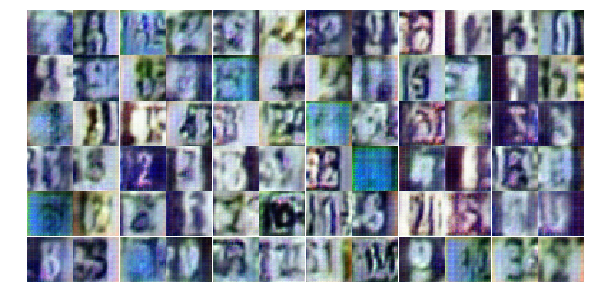

Epoch 6/25... Discriminator Loss: 1.3382... Generator Loss: 0.5225
Epoch 6/25... Discriminator Loss: 1.3174... Generator Loss: 0.9418
Epoch 6/25... Discriminator Loss: 1.2688... Generator Loss: 0.5022
Epoch 6/25... Discriminator Loss: 1.1738... Generator Loss: 0.7407
Epoch 6/25... Discriminator Loss: 0.9512... Generator Loss: 0.9234
Epoch 6/25... Discriminator Loss: 1.2630... Generator Loss: 0.5640
Epoch 6/25... Discriminator Loss: 1.1324... Generator Loss: 0.7390
Epoch 6/25... Discriminator Loss: 1.4006... Generator Loss: 0.4902
Epoch 6/25... Discriminator Loss: 0.9118... Generator Loss: 1.3272
Epoch 6/25... Discriminator Loss: 1.0748... Generator Loss: 0.8578


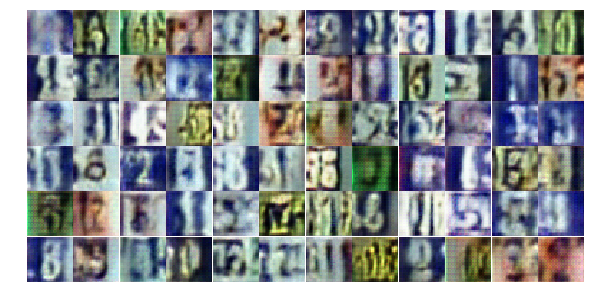

Epoch 6/25... Discriminator Loss: 0.9529... Generator Loss: 1.7467
Epoch 6/25... Discriminator Loss: 1.0219... Generator Loss: 0.9475
Epoch 6/25... Discriminator Loss: 1.1806... Generator Loss: 0.7657
Epoch 6/25... Discriminator Loss: 1.2952... Generator Loss: 0.8958
Epoch 6/25... Discriminator Loss: 1.3457... Generator Loss: 1.4117
Epoch 6/25... Discriminator Loss: 1.7168... Generator Loss: 0.2832
Epoch 6/25... Discriminator Loss: 1.2518... Generator Loss: 0.6746
Epoch 6/25... Discriminator Loss: 0.9503... Generator Loss: 1.2890
Epoch 6/25... Discriminator Loss: 1.1327... Generator Loss: 0.6646
Epoch 6/25... Discriminator Loss: 1.0814... Generator Loss: 1.2126


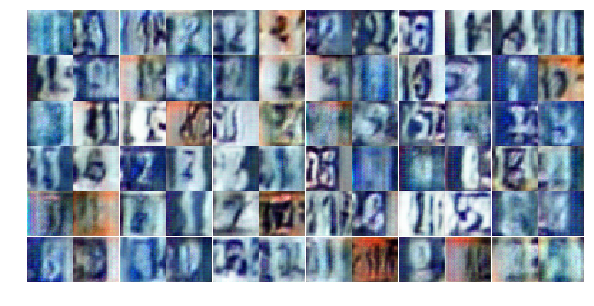

Epoch 6/25... Discriminator Loss: 1.2303... Generator Loss: 0.5469
Epoch 6/25... Discriminator Loss: 0.9930... Generator Loss: 1.0757
Epoch 6/25... Discriminator Loss: 1.2480... Generator Loss: 0.8422
Epoch 6/25... Discriminator Loss: 1.6847... Generator Loss: 0.3511
Epoch 6/25... Discriminator Loss: 1.2051... Generator Loss: 0.4951
Epoch 6/25... Discriminator Loss: 1.0410... Generator Loss: 0.8687
Epoch 6/25... Discriminator Loss: 1.3501... Generator Loss: 0.5774
Epoch 6/25... Discriminator Loss: 0.9802... Generator Loss: 1.1847
Epoch 6/25... Discriminator Loss: 1.1776... Generator Loss: 0.5868
Epoch 6/25... Discriminator Loss: 0.9860... Generator Loss: 1.3425


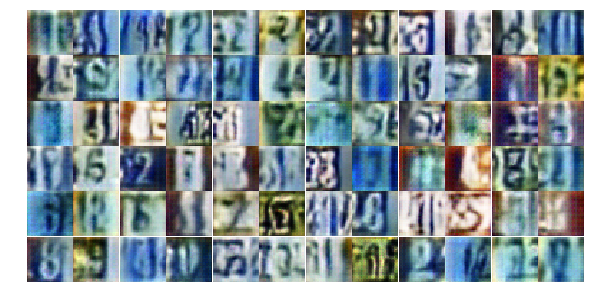

Epoch 6/25... Discriminator Loss: 1.6475... Generator Loss: 0.4763
Epoch 6/25... Discriminator Loss: 1.4216... Generator Loss: 0.7283
Epoch 6/25... Discriminator Loss: 1.4892... Generator Loss: 0.4643
Epoch 6/25... Discriminator Loss: 1.2723... Generator Loss: 1.1573
Epoch 6/25... Discriminator Loss: 1.1058... Generator Loss: 0.9171
Epoch 6/25... Discriminator Loss: 1.0300... Generator Loss: 0.9365
Epoch 6/25... Discriminator Loss: 1.1286... Generator Loss: 0.7725
Epoch 6/25... Discriminator Loss: 1.1439... Generator Loss: 0.9561
Epoch 6/25... Discriminator Loss: 1.0051... Generator Loss: 0.9826
Epoch 6/25... Discriminator Loss: 1.7358... Generator Loss: 0.3581


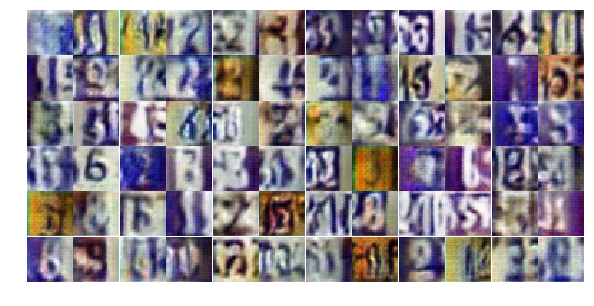

Epoch 6/25... Discriminator Loss: 1.0628... Generator Loss: 1.0179
Epoch 6/25... Discriminator Loss: 1.5505... Generator Loss: 1.9104
Epoch 6/25... Discriminator Loss: 1.1257... Generator Loss: 0.7623
Epoch 7/25... Discriminator Loss: 1.0848... Generator Loss: 0.7446
Epoch 7/25... Discriminator Loss: 1.3796... Generator Loss: 0.5609
Epoch 7/25... Discriminator Loss: 0.9921... Generator Loss: 0.9115
Epoch 7/25... Discriminator Loss: 1.3595... Generator Loss: 0.4848
Epoch 7/25... Discriminator Loss: 1.1064... Generator Loss: 0.6935
Epoch 7/25... Discriminator Loss: 1.0401... Generator Loss: 0.7367
Epoch 7/25... Discriminator Loss: 1.2809... Generator Loss: 0.6850


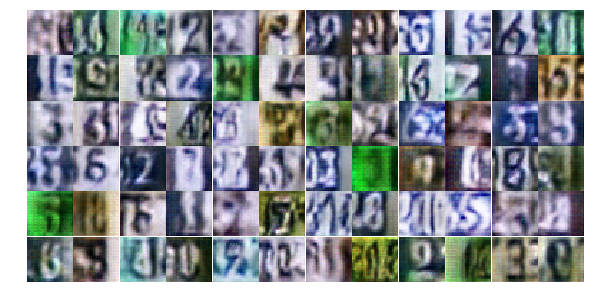

Epoch 7/25... Discriminator Loss: 1.2268... Generator Loss: 0.8018
Epoch 7/25... Discriminator Loss: 1.1027... Generator Loss: 0.9409
Epoch 7/25... Discriminator Loss: 1.4309... Generator Loss: 0.4357
Epoch 7/25... Discriminator Loss: 1.1577... Generator Loss: 1.6245
Epoch 7/25... Discriminator Loss: 1.2155... Generator Loss: 0.7405
Epoch 7/25... Discriminator Loss: 1.3264... Generator Loss: 0.5442
Epoch 7/25... Discriminator Loss: 1.1171... Generator Loss: 1.1457
Epoch 7/25... Discriminator Loss: 1.5007... Generator Loss: 1.5875
Epoch 7/25... Discriminator Loss: 1.2630... Generator Loss: 0.7370
Epoch 7/25... Discriminator Loss: 0.8784... Generator Loss: 1.0424


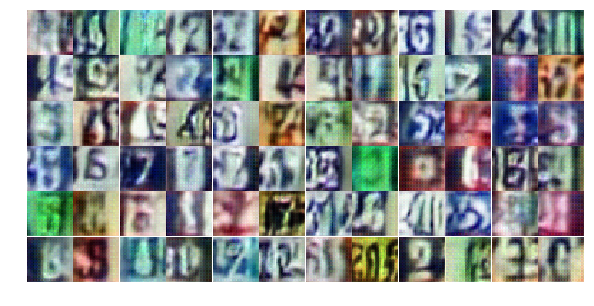

Epoch 7/25... Discriminator Loss: 1.2588... Generator Loss: 0.6013
Epoch 7/25... Discriminator Loss: 1.1718... Generator Loss: 0.6219
Epoch 7/25... Discriminator Loss: 1.1620... Generator Loss: 0.6481
Epoch 7/25... Discriminator Loss: 1.1612... Generator Loss: 0.7494
Epoch 7/25... Discriminator Loss: 0.8481... Generator Loss: 1.5856
Epoch 7/25... Discriminator Loss: 1.1002... Generator Loss: 1.0787
Epoch 7/25... Discriminator Loss: 1.0937... Generator Loss: 0.6644
Epoch 7/25... Discriminator Loss: 1.4317... Generator Loss: 0.3708
Epoch 7/25... Discriminator Loss: 1.1521... Generator Loss: 1.3381
Epoch 7/25... Discriminator Loss: 1.1484... Generator Loss: 1.1723


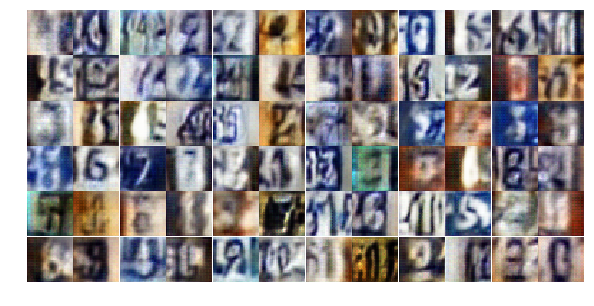

Epoch 7/25... Discriminator Loss: 1.4061... Generator Loss: 0.6194
Epoch 7/25... Discriminator Loss: 1.6634... Generator Loss: 0.2968
Epoch 7/25... Discriminator Loss: 1.1830... Generator Loss: 0.6443
Epoch 7/25... Discriminator Loss: 1.1256... Generator Loss: 0.7001
Epoch 7/25... Discriminator Loss: 0.9295... Generator Loss: 0.8978
Epoch 7/25... Discriminator Loss: 1.3002... Generator Loss: 0.5537
Epoch 7/25... Discriminator Loss: 1.1131... Generator Loss: 0.6029
Epoch 7/25... Discriminator Loss: 0.8929... Generator Loss: 0.8876
Epoch 7/25... Discriminator Loss: 1.3595... Generator Loss: 0.6285
Epoch 7/25... Discriminator Loss: 1.2402... Generator Loss: 1.2236


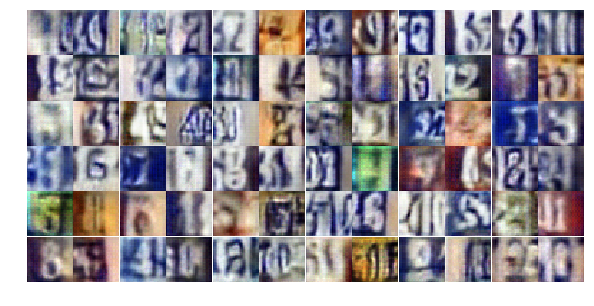

Epoch 7/25... Discriminator Loss: 1.2834... Generator Loss: 0.6982
Epoch 7/25... Discriminator Loss: 1.4191... Generator Loss: 1.2694
Epoch 7/25... Discriminator Loss: 1.1539... Generator Loss: 0.8302
Epoch 7/25... Discriminator Loss: 1.4469... Generator Loss: 0.3846
Epoch 7/25... Discriminator Loss: 0.9930... Generator Loss: 0.9639
Epoch 7/25... Discriminator Loss: 1.0057... Generator Loss: 0.9721
Epoch 7/25... Discriminator Loss: 0.9395... Generator Loss: 0.8565
Epoch 7/25... Discriminator Loss: 1.8423... Generator Loss: 0.8385
Epoch 7/25... Discriminator Loss: 1.1643... Generator Loss: 0.8648
Epoch 7/25... Discriminator Loss: 1.1016... Generator Loss: 0.6977


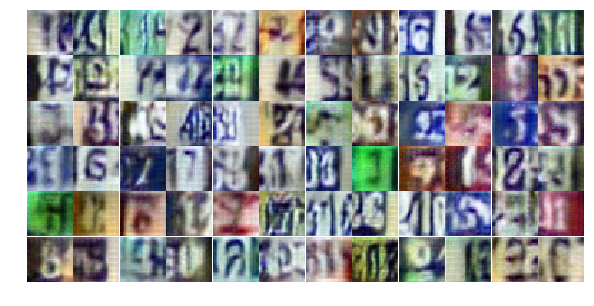

Epoch 7/25... Discriminator Loss: 0.8386... Generator Loss: 1.0057
Epoch 7/25... Discriminator Loss: 1.0954... Generator Loss: 0.7239
Epoch 7/25... Discriminator Loss: 1.0244... Generator Loss: 0.8530
Epoch 7/25... Discriminator Loss: 1.4059... Generator Loss: 0.7215
Epoch 7/25... Discriminator Loss: 1.1438... Generator Loss: 0.6532
Epoch 7/25... Discriminator Loss: 1.4284... Generator Loss: 0.3728
Epoch 7/25... Discriminator Loss: 1.0413... Generator Loss: 0.8569
Epoch 7/25... Discriminator Loss: 1.1882... Generator Loss: 0.7447
Epoch 7/25... Discriminator Loss: 1.1674... Generator Loss: 0.8937
Epoch 7/25... Discriminator Loss: 1.0012... Generator Loss: 0.8895


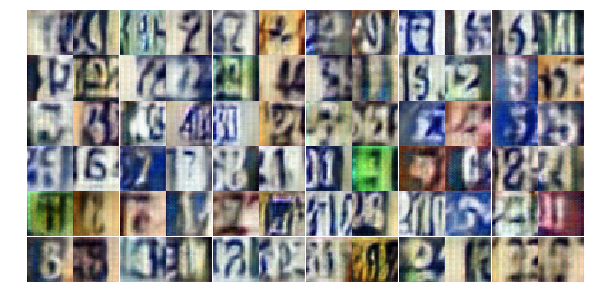

Epoch 7/25... Discriminator Loss: 1.0413... Generator Loss: 1.0079
Epoch 8/25... Discriminator Loss: 1.1011... Generator Loss: 0.8070
Epoch 8/25... Discriminator Loss: 1.2001... Generator Loss: 0.5503
Epoch 8/25... Discriminator Loss: 1.2067... Generator Loss: 0.6187
Epoch 8/25... Discriminator Loss: 0.9458... Generator Loss: 1.3086
Epoch 8/25... Discriminator Loss: 1.2974... Generator Loss: 0.8121
Epoch 8/25... Discriminator Loss: 1.3393... Generator Loss: 0.5230
Epoch 8/25... Discriminator Loss: 0.9855... Generator Loss: 1.8647
Epoch 8/25... Discriminator Loss: 1.4027... Generator Loss: 0.4050
Epoch 8/25... Discriminator Loss: 0.9661... Generator Loss: 0.7480


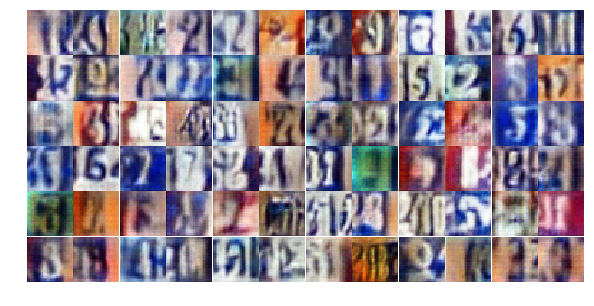

Epoch 8/25... Discriminator Loss: 1.3110... Generator Loss: 0.5054
Epoch 8/25... Discriminator Loss: 1.0897... Generator Loss: 0.6439
Epoch 8/25... Discriminator Loss: 1.5789... Generator Loss: 0.3378
Epoch 8/25... Discriminator Loss: 1.1122... Generator Loss: 0.9768
Epoch 8/25... Discriminator Loss: 0.8864... Generator Loss: 0.8236
Epoch 8/25... Discriminator Loss: 1.0875... Generator Loss: 0.6774
Epoch 8/25... Discriminator Loss: 1.1943... Generator Loss: 0.7350
Epoch 8/25... Discriminator Loss: 1.4053... Generator Loss: 0.4461
Epoch 8/25... Discriminator Loss: 1.0843... Generator Loss: 0.7289
Epoch 8/25... Discriminator Loss: 1.5698... Generator Loss: 0.3688


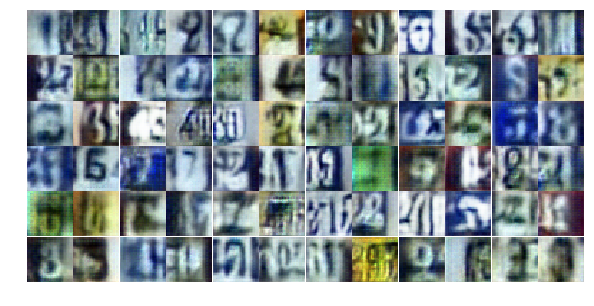

Epoch 8/25... Discriminator Loss: 0.9982... Generator Loss: 1.3703
Epoch 8/25... Discriminator Loss: 1.3552... Generator Loss: 0.4842
Epoch 8/25... Discriminator Loss: 1.5665... Generator Loss: 0.7340
Epoch 8/25... Discriminator Loss: 0.9982... Generator Loss: 0.8335
Epoch 8/25... Discriminator Loss: 1.0654... Generator Loss: 0.7329
Epoch 8/25... Discriminator Loss: 1.1129... Generator Loss: 0.7585
Epoch 8/25... Discriminator Loss: 1.2913... Generator Loss: 0.6854
Epoch 8/25... Discriminator Loss: 1.0874... Generator Loss: 0.7067
Epoch 8/25... Discriminator Loss: 1.7701... Generator Loss: 1.4346
Epoch 8/25... Discriminator Loss: 1.1475... Generator Loss: 0.8880


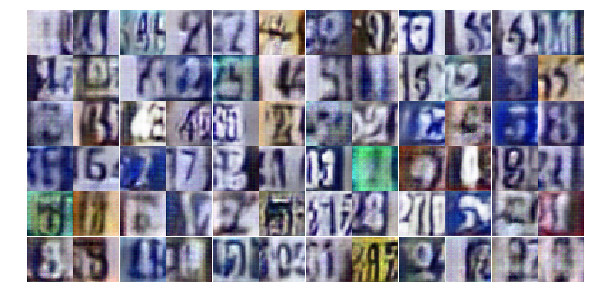

Epoch 8/25... Discriminator Loss: 1.3775... Generator Loss: 0.9994
Epoch 8/25... Discriminator Loss: 1.0447... Generator Loss: 0.8888
Epoch 8/25... Discriminator Loss: 0.9574... Generator Loss: 1.0580
Epoch 8/25... Discriminator Loss: 1.0211... Generator Loss: 0.8417
Epoch 8/25... Discriminator Loss: 1.2053... Generator Loss: 0.6125
Epoch 8/25... Discriminator Loss: 0.9948... Generator Loss: 0.9328
Epoch 8/25... Discriminator Loss: 0.9564... Generator Loss: 0.7877
Epoch 8/25... Discriminator Loss: 1.0391... Generator Loss: 1.0877
Epoch 8/25... Discriminator Loss: 1.0363... Generator Loss: 0.8870
Epoch 8/25... Discriminator Loss: 0.9608... Generator Loss: 0.8778


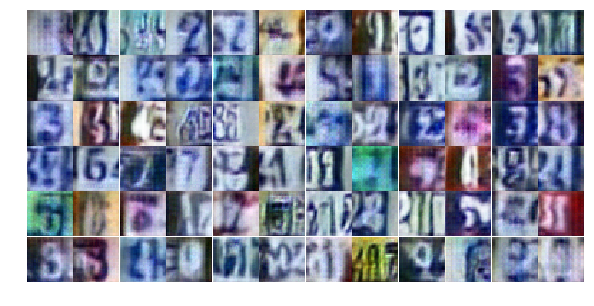

Epoch 8/25... Discriminator Loss: 1.0592... Generator Loss: 1.8532
Epoch 8/25... Discriminator Loss: 1.3122... Generator Loss: 0.6431
Epoch 8/25... Discriminator Loss: 0.7612... Generator Loss: 1.0047
Epoch 8/25... Discriminator Loss: 0.9576... Generator Loss: 0.8090
Epoch 8/25... Discriminator Loss: 1.6140... Generator Loss: 0.3191
Epoch 8/25... Discriminator Loss: 1.0119... Generator Loss: 0.8798
Epoch 8/25... Discriminator Loss: 0.9581... Generator Loss: 0.8821
Epoch 8/25... Discriminator Loss: 1.5668... Generator Loss: 0.3804
Epoch 8/25... Discriminator Loss: 1.0502... Generator Loss: 0.7673
Epoch 8/25... Discriminator Loss: 1.2988... Generator Loss: 2.2498


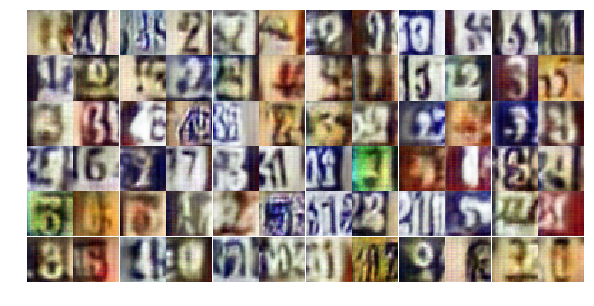

Epoch 8/25... Discriminator Loss: 1.7491... Generator Loss: 2.3216
Epoch 8/25... Discriminator Loss: 1.3507... Generator Loss: 0.4499
Epoch 8/25... Discriminator Loss: 1.0199... Generator Loss: 0.9492
Epoch 8/25... Discriminator Loss: 1.0715... Generator Loss: 1.0683
Epoch 8/25... Discriminator Loss: 0.6860... Generator Loss: 1.4035
Epoch 8/25... Discriminator Loss: 1.1828... Generator Loss: 0.7035
Epoch 8/25... Discriminator Loss: 0.9269... Generator Loss: 1.0689
Epoch 8/25... Discriminator Loss: 1.1454... Generator Loss: 2.1459
Epoch 9/25... Discriminator Loss: 0.9377... Generator Loss: 1.1280
Epoch 9/25... Discriminator Loss: 0.8972... Generator Loss: 1.0714


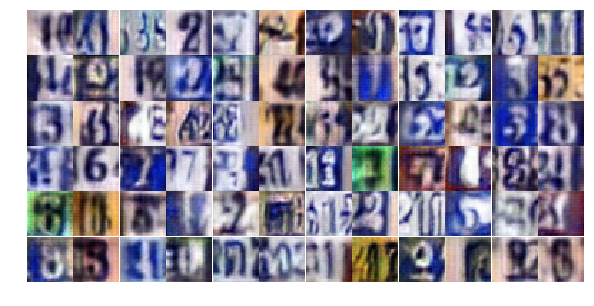

Epoch 9/25... Discriminator Loss: 1.1340... Generator Loss: 0.8368
Epoch 9/25... Discriminator Loss: 0.8962... Generator Loss: 1.0161
Epoch 9/25... Discriminator Loss: 1.5610... Generator Loss: 0.3473
Epoch 9/25... Discriminator Loss: 1.1522... Generator Loss: 0.8169
Epoch 9/25... Discriminator Loss: 1.1938... Generator Loss: 1.0407
Epoch 9/25... Discriminator Loss: 1.1342... Generator Loss: 0.8286
Epoch 9/25... Discriminator Loss: 0.7297... Generator Loss: 1.3119
Epoch 9/25... Discriminator Loss: 1.0813... Generator Loss: 0.9389
Epoch 9/25... Discriminator Loss: 1.3087... Generator Loss: 0.6286
Epoch 9/25... Discriminator Loss: 0.8053... Generator Loss: 1.8849


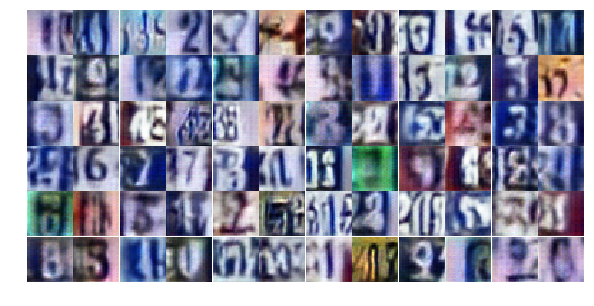

Epoch 9/25... Discriminator Loss: 0.9748... Generator Loss: 1.5185
Epoch 9/25... Discriminator Loss: 1.4374... Generator Loss: 0.3755
Epoch 9/25... Discriminator Loss: 1.0707... Generator Loss: 2.0291
Epoch 9/25... Discriminator Loss: 1.2138... Generator Loss: 0.7531
Epoch 9/25... Discriminator Loss: 0.7291... Generator Loss: 2.5305
Epoch 9/25... Discriminator Loss: 1.1656... Generator Loss: 0.7594
Epoch 9/25... Discriminator Loss: 1.1295... Generator Loss: 0.6456
Epoch 9/25... Discriminator Loss: 0.9810... Generator Loss: 0.6525
Epoch 9/25... Discriminator Loss: 1.4153... Generator Loss: 0.4364
Epoch 9/25... Discriminator Loss: 1.0929... Generator Loss: 1.2342


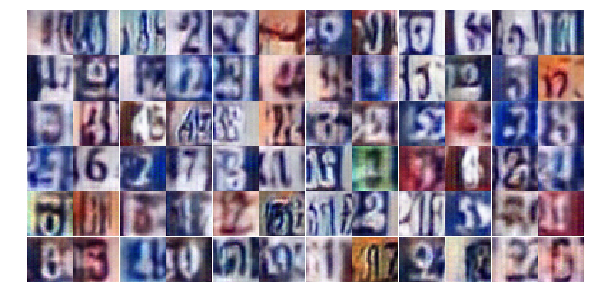

Epoch 9/25... Discriminator Loss: 1.5960... Generator Loss: 0.3650
Epoch 9/25... Discriminator Loss: 1.5773... Generator Loss: 0.3600
Epoch 9/25... Discriminator Loss: 0.8069... Generator Loss: 2.7364
Epoch 9/25... Discriminator Loss: 1.9349... Generator Loss: 0.2579
Epoch 9/25... Discriminator Loss: 1.0413... Generator Loss: 0.8843
Epoch 9/25... Discriminator Loss: 0.8578... Generator Loss: 1.1950
Epoch 9/25... Discriminator Loss: 1.5211... Generator Loss: 0.3929
Epoch 9/25... Discriminator Loss: 0.8303... Generator Loss: 1.3084
Epoch 9/25... Discriminator Loss: 1.2375... Generator Loss: 0.5494
Epoch 9/25... Discriminator Loss: 1.0177... Generator Loss: 0.7849


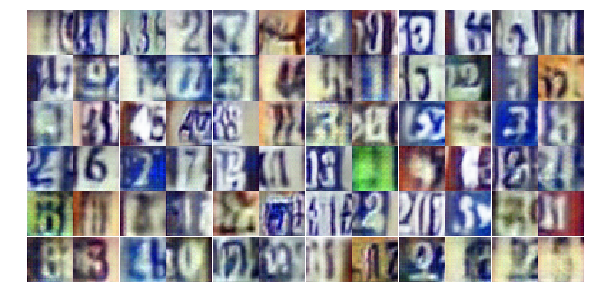

Epoch 9/25... Discriminator Loss: 0.8989... Generator Loss: 1.1127
Epoch 9/25... Discriminator Loss: 1.1093... Generator Loss: 0.8026
Epoch 9/25... Discriminator Loss: 1.3193... Generator Loss: 0.7436
Epoch 9/25... Discriminator Loss: 0.9503... Generator Loss: 1.0461
Epoch 9/25... Discriminator Loss: 1.2723... Generator Loss: 0.5501
Epoch 9/25... Discriminator Loss: 1.2841... Generator Loss: 0.4978
Epoch 9/25... Discriminator Loss: 0.8849... Generator Loss: 1.2058
Epoch 9/25... Discriminator Loss: 0.8295... Generator Loss: 1.3705
Epoch 9/25... Discriminator Loss: 1.5228... Generator Loss: 0.4105
Epoch 9/25... Discriminator Loss: 1.0755... Generator Loss: 0.6224


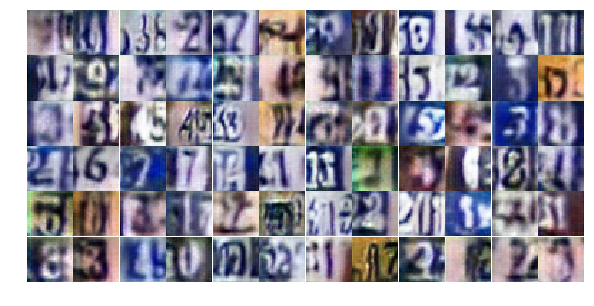

Epoch 9/25... Discriminator Loss: 0.6782... Generator Loss: 1.2080
Epoch 9/25... Discriminator Loss: 1.4129... Generator Loss: 0.4744
Epoch 9/25... Discriminator Loss: 0.7490... Generator Loss: 1.2455
Epoch 9/25... Discriminator Loss: 0.7090... Generator Loss: 1.5983
Epoch 9/25... Discriminator Loss: 0.5770... Generator Loss: 1.6914
Epoch 9/25... Discriminator Loss: 1.3620... Generator Loss: 0.5127
Epoch 9/25... Discriminator Loss: 1.2747... Generator Loss: 0.5169
Epoch 9/25... Discriminator Loss: 0.3780... Generator Loss: 1.8025
Epoch 9/25... Discriminator Loss: 1.1711... Generator Loss: 0.8777
Epoch 9/25... Discriminator Loss: 1.6370... Generator Loss: 0.4456


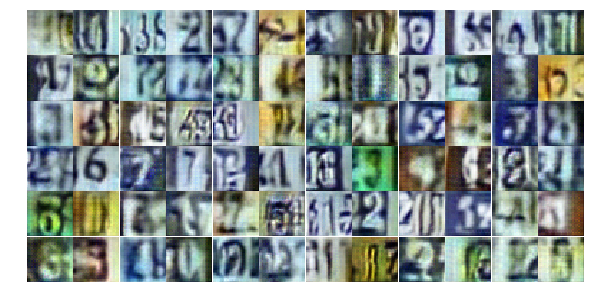

Epoch 9/25... Discriminator Loss: 0.9250... Generator Loss: 1.2006
Epoch 9/25... Discriminator Loss: 1.3610... Generator Loss: 0.6641
Epoch 9/25... Discriminator Loss: 1.4427... Generator Loss: 0.4307
Epoch 9/25... Discriminator Loss: 1.2106... Generator Loss: 0.6212
Epoch 9/25... Discriminator Loss: 0.7735... Generator Loss: 1.0912
Epoch 10/25... Discriminator Loss: 1.2091... Generator Loss: 0.6950
Epoch 10/25... Discriminator Loss: 1.2599... Generator Loss: 0.4690
Epoch 10/25... Discriminator Loss: 1.6001... Generator Loss: 0.3625
Epoch 10/25... Discriminator Loss: 1.3615... Generator Loss: 0.4625
Epoch 10/25... Discriminator Loss: 1.4874... Generator Loss: 0.3899


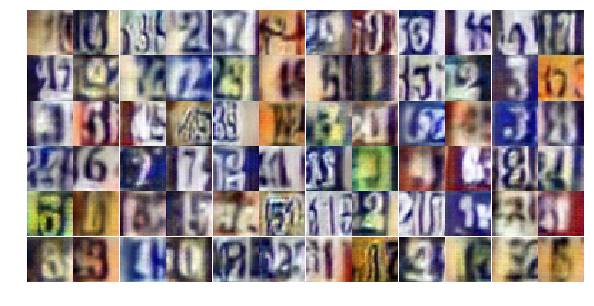

Epoch 10/25... Discriminator Loss: 1.2554... Generator Loss: 0.5968
Epoch 10/25... Discriminator Loss: 1.0106... Generator Loss: 0.7917
Epoch 10/25... Discriminator Loss: 0.9923... Generator Loss: 0.7132
Epoch 10/25... Discriminator Loss: 1.0716... Generator Loss: 0.7591
Epoch 10/25... Discriminator Loss: 1.0747... Generator Loss: 0.9215
Epoch 10/25... Discriminator Loss: 1.2620... Generator Loss: 0.5404
Epoch 10/25... Discriminator Loss: 0.5403... Generator Loss: 1.8810
Epoch 10/25... Discriminator Loss: 1.1098... Generator Loss: 0.5971
Epoch 10/25... Discriminator Loss: 1.6155... Generator Loss: 0.4332
Epoch 10/25... Discriminator Loss: 0.6139... Generator Loss: 2.2460


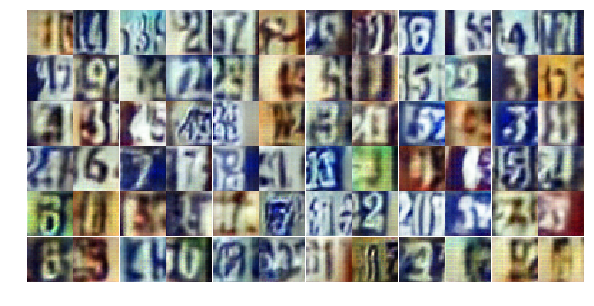

Epoch 10/25... Discriminator Loss: 1.0044... Generator Loss: 0.6972
Epoch 10/25... Discriminator Loss: 1.0812... Generator Loss: 0.6372
Epoch 10/25... Discriminator Loss: 0.8823... Generator Loss: 1.3517
Epoch 10/25... Discriminator Loss: 1.9227... Generator Loss: 0.2273
Epoch 10/25... Discriminator Loss: 0.9030... Generator Loss: 1.3041
Epoch 10/25... Discriminator Loss: 1.0823... Generator Loss: 0.7858
Epoch 10/25... Discriminator Loss: 1.1462... Generator Loss: 0.7256
Epoch 10/25... Discriminator Loss: 0.9952... Generator Loss: 0.6912
Epoch 10/25... Discriminator Loss: 1.2668... Generator Loss: 0.7938
Epoch 10/25... Discriminator Loss: 0.9197... Generator Loss: 1.0482


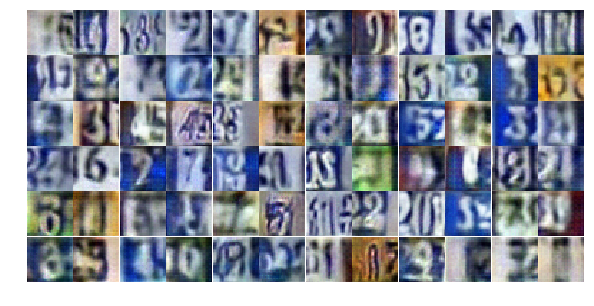

Epoch 10/25... Discriminator Loss: 1.0209... Generator Loss: 0.7929
Epoch 10/25... Discriminator Loss: 1.5023... Generator Loss: 0.4333
Epoch 10/25... Discriminator Loss: 0.4953... Generator Loss: 1.8675
Epoch 10/25... Discriminator Loss: 0.9994... Generator Loss: 2.3106
Epoch 10/25... Discriminator Loss: 1.2500... Generator Loss: 0.5202
Epoch 10/25... Discriminator Loss: 0.8109... Generator Loss: 1.1291
Epoch 10/25... Discriminator Loss: 0.9929... Generator Loss: 0.8410
Epoch 10/25... Discriminator Loss: 0.9689... Generator Loss: 1.9071
Epoch 10/25... Discriminator Loss: 1.2529... Generator Loss: 1.1950
Epoch 10/25... Discriminator Loss: 0.7579... Generator Loss: 1.6632


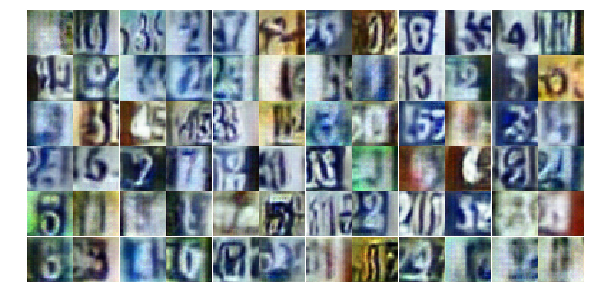

Epoch 10/25... Discriminator Loss: 1.0959... Generator Loss: 0.7817
Epoch 10/25... Discriminator Loss: 1.2054... Generator Loss: 0.5135
Epoch 10/25... Discriminator Loss: 0.5360... Generator Loss: 2.3341
Epoch 10/25... Discriminator Loss: 1.1112... Generator Loss: 1.4500
Epoch 10/25... Discriminator Loss: 0.5674... Generator Loss: 1.5762
Epoch 10/25... Discriminator Loss: 1.8994... Generator Loss: 0.2504
Epoch 10/25... Discriminator Loss: 1.2447... Generator Loss: 0.5669
Epoch 10/25... Discriminator Loss: 1.1000... Generator Loss: 0.6406
Epoch 10/25... Discriminator Loss: 0.8383... Generator Loss: 1.5753
Epoch 10/25... Discriminator Loss: 1.3526... Generator Loss: 1.1178


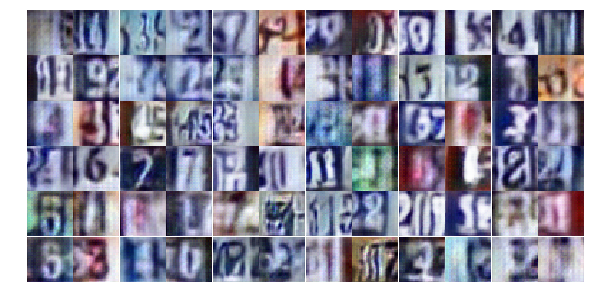

Epoch 10/25... Discriminator Loss: 1.5294... Generator Loss: 0.4487
Epoch 10/25... Discriminator Loss: 0.8119... Generator Loss: 0.9998
Epoch 10/25... Discriminator Loss: 1.3875... Generator Loss: 0.4491
Epoch 10/25... Discriminator Loss: 0.9597... Generator Loss: 1.2705
Epoch 10/25... Discriminator Loss: 0.9976... Generator Loss: 1.2893
Epoch 10/25... Discriminator Loss: 1.1494... Generator Loss: 0.8303
Epoch 10/25... Discriminator Loss: 1.1759... Generator Loss: 0.8473
Epoch 10/25... Discriminator Loss: 1.0789... Generator Loss: 3.0284
Epoch 10/25... Discriminator Loss: 0.6096... Generator Loss: 1.7255
Epoch 10/25... Discriminator Loss: 1.0630... Generator Loss: 0.6779


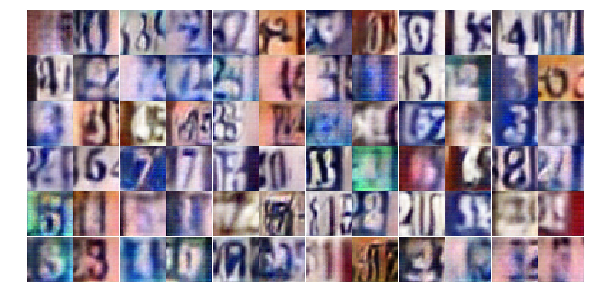

Epoch 10/25... Discriminator Loss: 1.1148... Generator Loss: 0.7081
Epoch 10/25... Discriminator Loss: 1.1844... Generator Loss: 0.5549
Epoch 10/25... Discriminator Loss: 1.3256... Generator Loss: 0.4499
Epoch 11/25... Discriminator Loss: 0.6903... Generator Loss: 1.5342
Epoch 11/25... Discriminator Loss: 1.3667... Generator Loss: 0.5287
Epoch 11/25... Discriminator Loss: 1.4056... Generator Loss: 0.4310
Epoch 11/25... Discriminator Loss: 1.3500... Generator Loss: 0.4792
Epoch 11/25... Discriminator Loss: 1.6384... Generator Loss: 0.3709
Epoch 11/25... Discriminator Loss: 1.6056... Generator Loss: 0.3553
Epoch 11/25... Discriminator Loss: 0.8171... Generator Loss: 0.9287


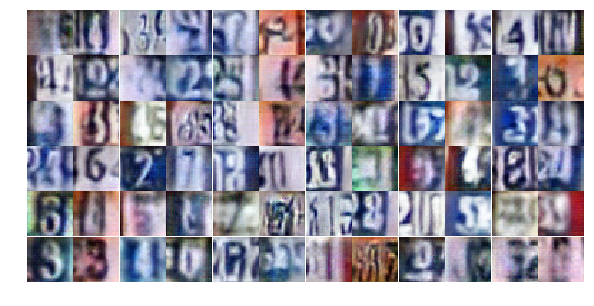

Epoch 11/25... Discriminator Loss: 0.7102... Generator Loss: 1.1609
Epoch 11/25... Discriminator Loss: 0.7359... Generator Loss: 1.1715
Epoch 11/25... Discriminator Loss: 1.0743... Generator Loss: 0.6222
Epoch 11/25... Discriminator Loss: 0.9052... Generator Loss: 1.0212
Epoch 11/25... Discriminator Loss: 0.8633... Generator Loss: 1.2356
Epoch 11/25... Discriminator Loss: 1.1040... Generator Loss: 0.7856
Epoch 11/25... Discriminator Loss: 1.0175... Generator Loss: 1.1342
Epoch 11/25... Discriminator Loss: 0.9321... Generator Loss: 1.1687
Epoch 11/25... Discriminator Loss: 0.5758... Generator Loss: 1.8450
Epoch 11/25... Discriminator Loss: 1.7794... Generator Loss: 0.3649


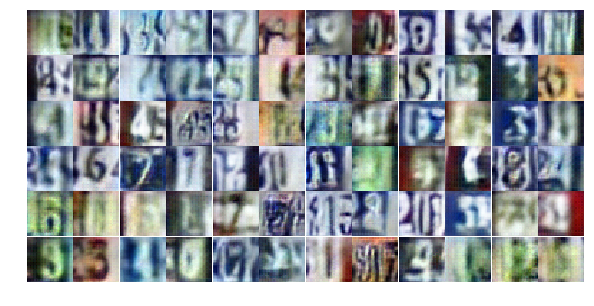

Epoch 11/25... Discriminator Loss: 0.6479... Generator Loss: 1.9066
Epoch 11/25... Discriminator Loss: 0.8540... Generator Loss: 1.9460
Epoch 11/25... Discriminator Loss: 1.4213... Generator Loss: 0.5068
Epoch 11/25... Discriminator Loss: 1.7353... Generator Loss: 0.3156
Epoch 11/25... Discriminator Loss: 0.9430... Generator Loss: 0.7984
Epoch 11/25... Discriminator Loss: 0.7873... Generator Loss: 1.0251
Epoch 11/25... Discriminator Loss: 1.6836... Generator Loss: 0.3487
Epoch 11/25... Discriminator Loss: 1.5786... Generator Loss: 0.4187
Epoch 11/25... Discriminator Loss: 0.8719... Generator Loss: 1.0509
Epoch 11/25... Discriminator Loss: 1.6499... Generator Loss: 0.3344


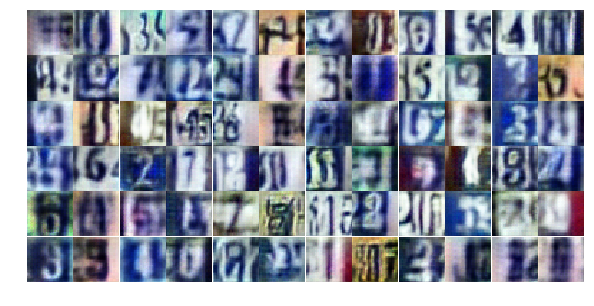

Epoch 11/25... Discriminator Loss: 1.1117... Generator Loss: 1.1077
Epoch 11/25... Discriminator Loss: 0.8832... Generator Loss: 0.7377
Epoch 11/25... Discriminator Loss: 1.2031... Generator Loss: 1.0207
Epoch 11/25... Discriminator Loss: 0.9880... Generator Loss: 0.8127
Epoch 11/25... Discriminator Loss: 1.1990... Generator Loss: 0.5866
Epoch 11/25... Discriminator Loss: 1.3399... Generator Loss: 0.5272
Epoch 11/25... Discriminator Loss: 1.3437... Generator Loss: 0.5317
Epoch 11/25... Discriminator Loss: 1.2754... Generator Loss: 0.6141
Epoch 11/25... Discriminator Loss: 1.1217... Generator Loss: 0.7247
Epoch 11/25... Discriminator Loss: 1.3034... Generator Loss: 0.5463


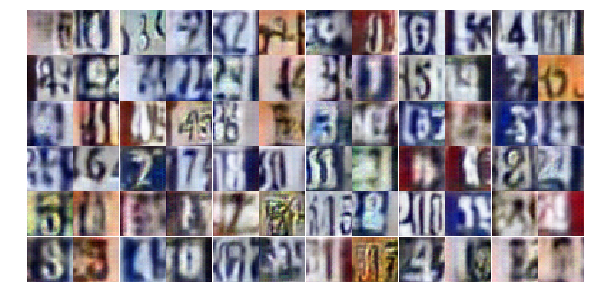

Epoch 11/25... Discriminator Loss: 1.1257... Generator Loss: 0.6569
Epoch 11/25... Discriminator Loss: 0.9818... Generator Loss: 0.7938
Epoch 11/25... Discriminator Loss: 1.0075... Generator Loss: 0.7417
Epoch 11/25... Discriminator Loss: 1.1578... Generator Loss: 0.6826
Epoch 11/25... Discriminator Loss: 1.3807... Generator Loss: 0.4437
Epoch 11/25... Discriminator Loss: 0.7361... Generator Loss: 0.9357
Epoch 11/25... Discriminator Loss: 1.0505... Generator Loss: 1.4556
Epoch 11/25... Discriminator Loss: 0.9681... Generator Loss: 0.8036
Epoch 11/25... Discriminator Loss: 1.1276... Generator Loss: 0.6778
Epoch 11/25... Discriminator Loss: 1.1262... Generator Loss: 0.7109


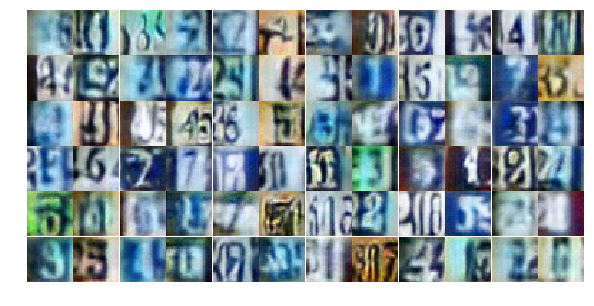

Epoch 11/25... Discriminator Loss: 1.2168... Generator Loss: 0.5511
Epoch 11/25... Discriminator Loss: 0.7463... Generator Loss: 0.9899
Epoch 11/25... Discriminator Loss: 0.6711... Generator Loss: 1.6408
Epoch 11/25... Discriminator Loss: 0.8220... Generator Loss: 0.8019
Epoch 11/25... Discriminator Loss: 1.5636... Generator Loss: 0.4612
Epoch 11/25... Discriminator Loss: 1.2383... Generator Loss: 0.5366
Epoch 11/25... Discriminator Loss: 0.8950... Generator Loss: 0.8658
Epoch 11/25... Discriminator Loss: 0.4810... Generator Loss: 2.4935
Epoch 11/25... Discriminator Loss: 1.3151... Generator Loss: 0.5025
Epoch 11/25... Discriminator Loss: 1.4541... Generator Loss: 0.4553


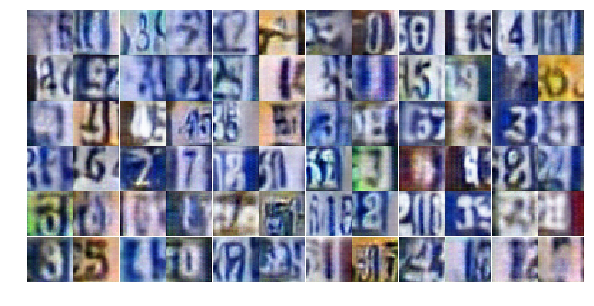

Epoch 12/25... Discriminator Loss: 1.2816... Generator Loss: 1.1394
Epoch 12/25... Discriminator Loss: 1.4122... Generator Loss: 0.4285
Epoch 12/25... Discriminator Loss: 1.2748... Generator Loss: 0.9844
Epoch 12/25... Discriminator Loss: 0.8346... Generator Loss: 1.5218
Epoch 12/25... Discriminator Loss: 0.9191... Generator Loss: 1.1449
Epoch 12/25... Discriminator Loss: 0.8385... Generator Loss: 0.9224
Epoch 12/25... Discriminator Loss: 0.7192... Generator Loss: 1.1203
Epoch 12/25... Discriminator Loss: 0.9285... Generator Loss: 1.0137
Epoch 12/25... Discriminator Loss: 0.9424... Generator Loss: 1.4654
Epoch 12/25... Discriminator Loss: 1.2482... Generator Loss: 0.6135


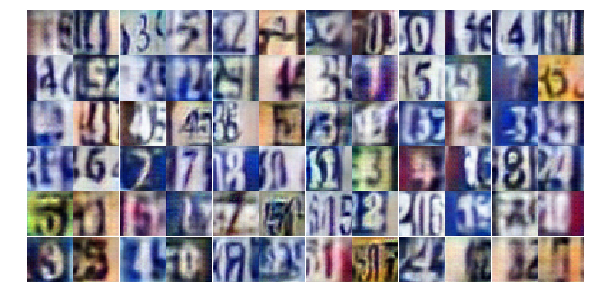

Epoch 12/25... Discriminator Loss: 0.7721... Generator Loss: 1.5957
Epoch 12/25... Discriminator Loss: 1.4078... Generator Loss: 0.4260
Epoch 12/25... Discriminator Loss: 1.0650... Generator Loss: 0.9315
Epoch 12/25... Discriminator Loss: 0.3890... Generator Loss: 3.6218
Epoch 12/25... Discriminator Loss: 1.4025... Generator Loss: 0.7339
Epoch 12/25... Discriminator Loss: 0.8588... Generator Loss: 0.9593
Epoch 12/25... Discriminator Loss: 2.4427... Generator Loss: 4.5936
Epoch 12/25... Discriminator Loss: 0.6385... Generator Loss: 1.4006
Epoch 12/25... Discriminator Loss: 0.5819... Generator Loss: 2.0283
Epoch 12/25... Discriminator Loss: 2.4053... Generator Loss: 0.6444


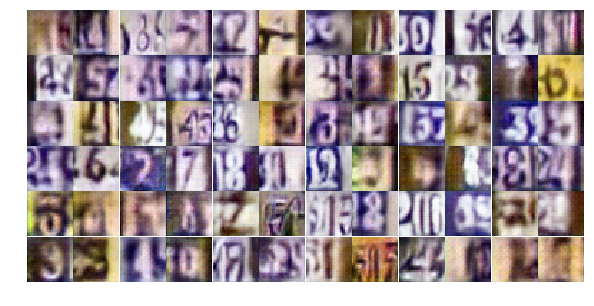

Epoch 12/25... Discriminator Loss: 1.0857... Generator Loss: 2.8568
Epoch 12/25... Discriminator Loss: 1.1557... Generator Loss: 1.2646
Epoch 12/25... Discriminator Loss: 1.5251... Generator Loss: 0.4198
Epoch 12/25... Discriminator Loss: 0.9085... Generator Loss: 1.7981
Epoch 12/25... Discriminator Loss: 0.2199... Generator Loss: 2.5134
Epoch 12/25... Discriminator Loss: 0.9803... Generator Loss: 0.6816
Epoch 12/25... Discriminator Loss: 1.1449... Generator Loss: 0.6598
Epoch 12/25... Discriminator Loss: 0.7070... Generator Loss: 1.2592
Epoch 12/25... Discriminator Loss: 0.9801... Generator Loss: 0.7486
Epoch 12/25... Discriminator Loss: 1.1224... Generator Loss: 0.9615


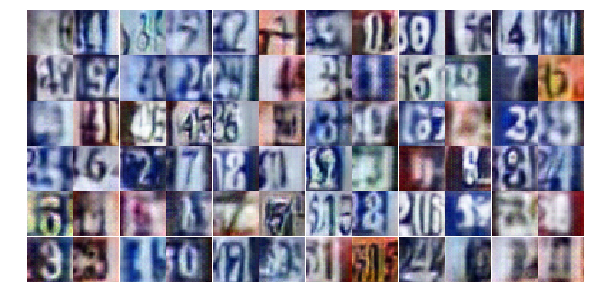

Epoch 12/25... Discriminator Loss: 0.8534... Generator Loss: 1.1072
Epoch 12/25... Discriminator Loss: 1.0029... Generator Loss: 0.8299
Epoch 12/25... Discriminator Loss: 1.1148... Generator Loss: 0.9604
Epoch 12/25... Discriminator Loss: 1.0770... Generator Loss: 0.7934
Epoch 12/25... Discriminator Loss: 0.6255... Generator Loss: 1.8847
Epoch 12/25... Discriminator Loss: 0.6383... Generator Loss: 1.1300
Epoch 12/25... Discriminator Loss: 1.8655... Generator Loss: 1.3895
Epoch 12/25... Discriminator Loss: 1.0645... Generator Loss: 0.7867
Epoch 12/25... Discriminator Loss: 1.1960... Generator Loss: 0.6556
Epoch 12/25... Discriminator Loss: 0.7990... Generator Loss: 0.9918


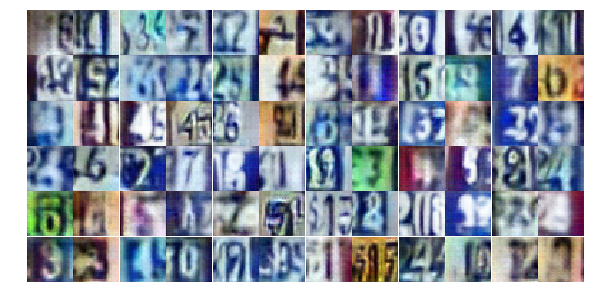

Epoch 12/25... Discriminator Loss: 0.8100... Generator Loss: 1.1627
Epoch 12/25... Discriminator Loss: 0.7920... Generator Loss: 1.1578
Epoch 12/25... Discriminator Loss: 0.5715... Generator Loss: 1.3297
Epoch 12/25... Discriminator Loss: 1.2748... Generator Loss: 0.5242
Epoch 12/25... Discriminator Loss: 0.8504... Generator Loss: 0.8766
Epoch 12/25... Discriminator Loss: 1.3102... Generator Loss: 0.5311
Epoch 12/25... Discriminator Loss: 1.0651... Generator Loss: 0.6694
Epoch 12/25... Discriminator Loss: 0.9867... Generator Loss: 0.8688
Epoch 12/25... Discriminator Loss: 1.0542... Generator Loss: 0.8022
Epoch 12/25... Discriminator Loss: 0.7065... Generator Loss: 2.5588


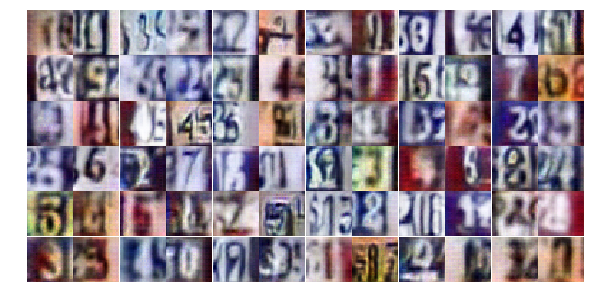

Epoch 12/25... Discriminator Loss: 1.6325... Generator Loss: 0.4405
Epoch 12/25... Discriminator Loss: 1.1015... Generator Loss: 0.7205
Epoch 12/25... Discriminator Loss: 1.0195... Generator Loss: 0.6730
Epoch 12/25... Discriminator Loss: 1.2038... Generator Loss: 0.8505
Epoch 12/25... Discriminator Loss: 0.6153... Generator Loss: 1.5109
Epoch 12/25... Discriminator Loss: 0.8566... Generator Loss: 0.9927
Epoch 12/25... Discriminator Loss: 0.6059... Generator Loss: 1.0723
Epoch 13/25... Discriminator Loss: 0.4653... Generator Loss: 1.5992
Epoch 13/25... Discriminator Loss: 1.1782... Generator Loss: 0.9499
Epoch 13/25... Discriminator Loss: 1.1022... Generator Loss: 0.6954


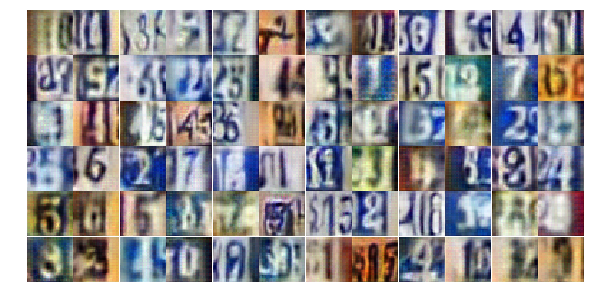

Epoch 13/25... Discriminator Loss: 1.1749... Generator Loss: 1.8781
Epoch 13/25... Discriminator Loss: 0.9770... Generator Loss: 1.2471
Epoch 13/25... Discriminator Loss: 1.7046... Generator Loss: 0.3225
Epoch 13/25... Discriminator Loss: 1.3904... Generator Loss: 0.5028
Epoch 13/25... Discriminator Loss: 0.9855... Generator Loss: 0.7993
Epoch 13/25... Discriminator Loss: 0.9139... Generator Loss: 0.7876
Epoch 13/25... Discriminator Loss: 0.9474... Generator Loss: 1.1718
Epoch 13/25... Discriminator Loss: 1.1431... Generator Loss: 0.5858
Epoch 13/25... Discriminator Loss: 0.5246... Generator Loss: 1.9218
Epoch 13/25... Discriminator Loss: 0.7926... Generator Loss: 0.9722


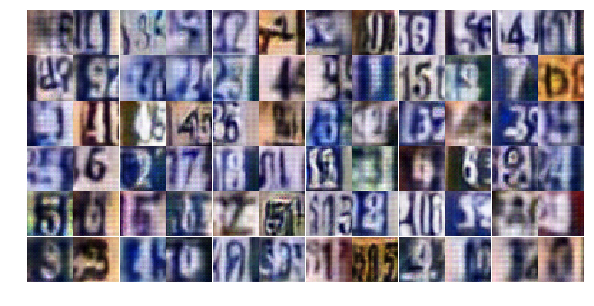

Epoch 13/25... Discriminator Loss: 1.3534... Generator Loss: 0.9942
Epoch 13/25... Discriminator Loss: 0.7123... Generator Loss: 0.9798
Epoch 13/25... Discriminator Loss: 1.3168... Generator Loss: 0.5614
Epoch 13/25... Discriminator Loss: 1.1556... Generator Loss: 0.8423
Epoch 13/25... Discriminator Loss: 0.9566... Generator Loss: 0.9929
Epoch 13/25... Discriminator Loss: 1.2405... Generator Loss: 0.5970
Epoch 13/25... Discriminator Loss: 1.2384... Generator Loss: 0.5529
Epoch 13/25... Discriminator Loss: 1.4184... Generator Loss: 0.4423
Epoch 13/25... Discriminator Loss: 0.8415... Generator Loss: 0.9773
Epoch 13/25... Discriminator Loss: 1.4899... Generator Loss: 0.4014


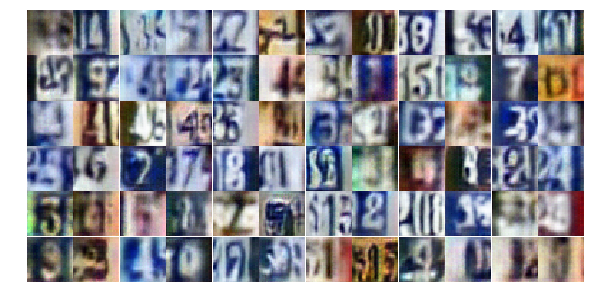

Epoch 13/25... Discriminator Loss: 1.0615... Generator Loss: 0.9363
Epoch 13/25... Discriminator Loss: 1.0782... Generator Loss: 0.6811
Epoch 13/25... Discriminator Loss: 0.9519... Generator Loss: 0.8991
Epoch 13/25... Discriminator Loss: 0.8100... Generator Loss: 1.1409
Epoch 13/25... Discriminator Loss: 0.5607... Generator Loss: 1.2494
Epoch 13/25... Discriminator Loss: 1.7499... Generator Loss: 0.3581
Epoch 13/25... Discriminator Loss: 1.3394... Generator Loss: 1.9683
Epoch 13/25... Discriminator Loss: 1.2395... Generator Loss: 0.5863
Epoch 13/25... Discriminator Loss: 0.7105... Generator Loss: 0.8938
Epoch 13/25... Discriminator Loss: 0.8460... Generator Loss: 0.9643


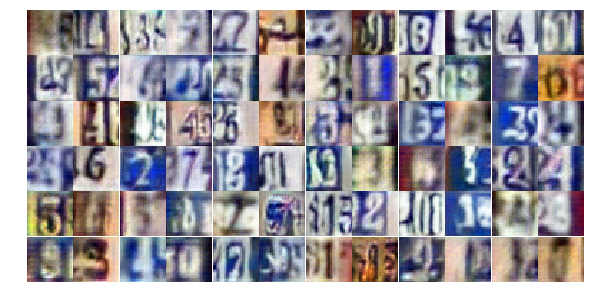

Epoch 13/25... Discriminator Loss: 1.2007... Generator Loss: 0.5720
Epoch 13/25... Discriminator Loss: 0.9833... Generator Loss: 1.2200
Epoch 13/25... Discriminator Loss: 1.4152... Generator Loss: 0.4153
Epoch 13/25... Discriminator Loss: 1.5264... Generator Loss: 0.4130
Epoch 13/25... Discriminator Loss: 0.7332... Generator Loss: 1.3533
Epoch 13/25... Discriminator Loss: 0.6113... Generator Loss: 1.0677
Epoch 13/25... Discriminator Loss: 0.8917... Generator Loss: 1.4704
Epoch 13/25... Discriminator Loss: 2.9097... Generator Loss: 3.6811
Epoch 13/25... Discriminator Loss: 0.9944... Generator Loss: 0.8999
Epoch 13/25... Discriminator Loss: 0.9787... Generator Loss: 0.8547


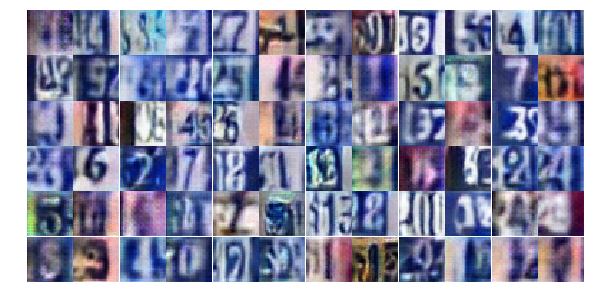

Epoch 13/25... Discriminator Loss: 0.7692... Generator Loss: 1.2629
Epoch 13/25... Discriminator Loss: 1.3129... Generator Loss: 0.5220
Epoch 13/25... Discriminator Loss: 1.1260... Generator Loss: 0.6475
Epoch 13/25... Discriminator Loss: 0.8682... Generator Loss: 0.9358
Epoch 13/25... Discriminator Loss: 1.8089... Generator Loss: 0.3065
Epoch 13/25... Discriminator Loss: 1.3256... Generator Loss: 0.7190
Epoch 13/25... Discriminator Loss: 0.6754... Generator Loss: 1.2177
Epoch 13/25... Discriminator Loss: 1.4601... Generator Loss: 0.4337
Epoch 13/25... Discriminator Loss: 1.8030... Generator Loss: 0.4253
Epoch 13/25... Discriminator Loss: 1.4621... Generator Loss: 0.4605


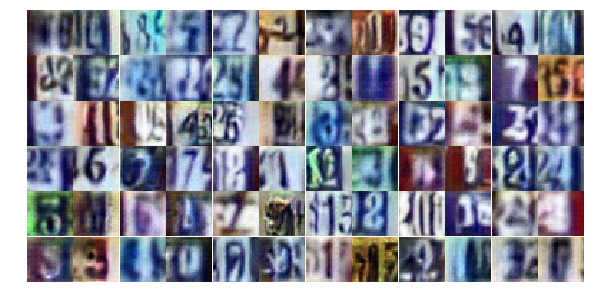

Epoch 13/25... Discriminator Loss: 0.7754... Generator Loss: 1.0525
Epoch 13/25... Discriminator Loss: 1.4634... Generator Loss: 0.4556
Epoch 13/25... Discriminator Loss: 1.1694... Generator Loss: 0.7411
Epoch 13/25... Discriminator Loss: 1.5789... Generator Loss: 0.3878
Epoch 14/25... Discriminator Loss: 0.7066... Generator Loss: 0.9561
Epoch 14/25... Discriminator Loss: 0.8733... Generator Loss: 1.7491
Epoch 14/25... Discriminator Loss: 1.1201... Generator Loss: 1.2043
Epoch 14/25... Discriminator Loss: 0.8651... Generator Loss: 1.6995
Epoch 14/25... Discriminator Loss: 1.0071... Generator Loss: 0.8417
Epoch 14/25... Discriminator Loss: 0.9088... Generator Loss: 0.9101


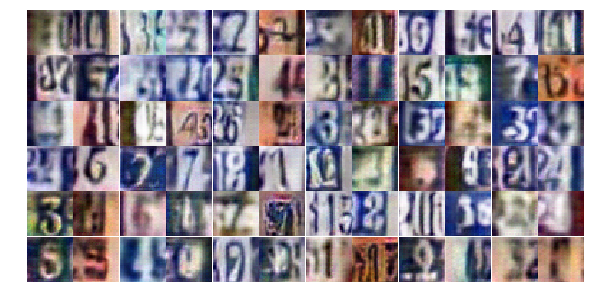

Epoch 14/25... Discriminator Loss: 0.7623... Generator Loss: 2.4850
Epoch 14/25... Discriminator Loss: 1.6298... Generator Loss: 0.4174
Epoch 14/25... Discriminator Loss: 1.3454... Generator Loss: 0.5092
Epoch 14/25... Discriminator Loss: 1.1441... Generator Loss: 0.8809
Epoch 14/25... Discriminator Loss: 1.6035... Generator Loss: 0.4380
Epoch 14/25... Discriminator Loss: 0.5075... Generator Loss: 1.5608
Epoch 14/25... Discriminator Loss: 0.7653... Generator Loss: 1.0020
Epoch 14/25... Discriminator Loss: 2.2111... Generator Loss: 0.1928
Epoch 14/25... Discriminator Loss: 1.2263... Generator Loss: 0.9129
Epoch 14/25... Discriminator Loss: 1.8592... Generator Loss: 0.2847


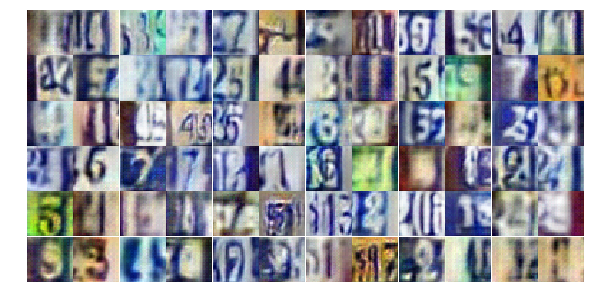

Epoch 14/25... Discriminator Loss: 1.4052... Generator Loss: 0.4161
Epoch 14/25... Discriminator Loss: 1.0445... Generator Loss: 1.3822
Epoch 14/25... Discriminator Loss: 1.0702... Generator Loss: 0.7591
Epoch 14/25... Discriminator Loss: 0.8334... Generator Loss: 0.9773
Epoch 14/25... Discriminator Loss: 0.6893... Generator Loss: 1.3252
Epoch 14/25... Discriminator Loss: 0.7792... Generator Loss: 0.9705
Epoch 14/25... Discriminator Loss: 1.6601... Generator Loss: 0.3201
Epoch 14/25... Discriminator Loss: 1.0613... Generator Loss: 0.7945
Epoch 14/25... Discriminator Loss: 0.5480... Generator Loss: 1.3274
Epoch 14/25... Discriminator Loss: 0.7420... Generator Loss: 0.9551


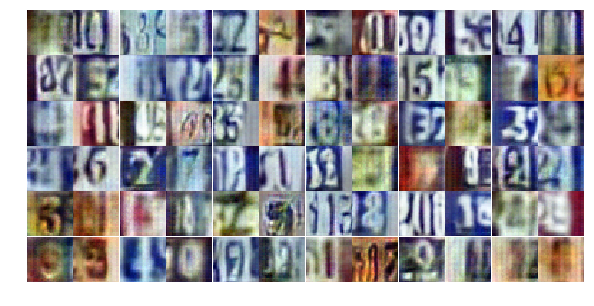

Epoch 14/25... Discriminator Loss: 2.1901... Generator Loss: 0.2266
Epoch 14/25... Discriminator Loss: 0.7495... Generator Loss: 1.0750
Epoch 14/25... Discriminator Loss: 0.8869... Generator Loss: 0.9462
Epoch 14/25... Discriminator Loss: 0.9184... Generator Loss: 1.1405
Epoch 14/25... Discriminator Loss: 0.9334... Generator Loss: 0.9132
Epoch 14/25... Discriminator Loss: 1.7126... Generator Loss: 0.3213
Epoch 14/25... Discriminator Loss: 1.0172... Generator Loss: 1.5159
Epoch 14/25... Discriminator Loss: 1.0526... Generator Loss: 1.2349
Epoch 14/25... Discriminator Loss: 0.6626... Generator Loss: 1.2823
Epoch 14/25... Discriminator Loss: 1.0311... Generator Loss: 0.9115


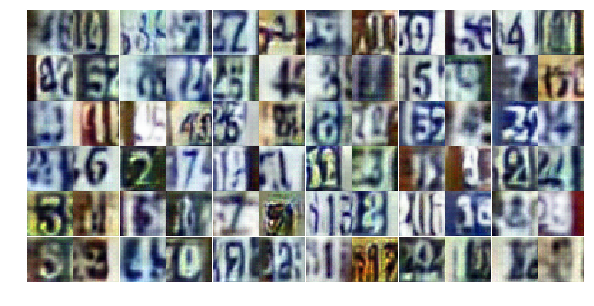

Epoch 14/25... Discriminator Loss: 1.8669... Generator Loss: 0.2885
Epoch 14/25... Discriminator Loss: 0.7825... Generator Loss: 0.9573
Epoch 14/25... Discriminator Loss: 0.2681... Generator Loss: 2.3590
Epoch 14/25... Discriminator Loss: 0.8935... Generator Loss: 0.7702
Epoch 14/25... Discriminator Loss: 1.3642... Generator Loss: 0.5230
Epoch 14/25... Discriminator Loss: 1.2020... Generator Loss: 0.6842
Epoch 14/25... Discriminator Loss: 1.2317... Generator Loss: 0.6902
Epoch 14/25... Discriminator Loss: 0.7880... Generator Loss: 0.9041
Epoch 14/25... Discriminator Loss: 1.6647... Generator Loss: 0.3742
Epoch 14/25... Discriminator Loss: 1.2822... Generator Loss: 0.5542


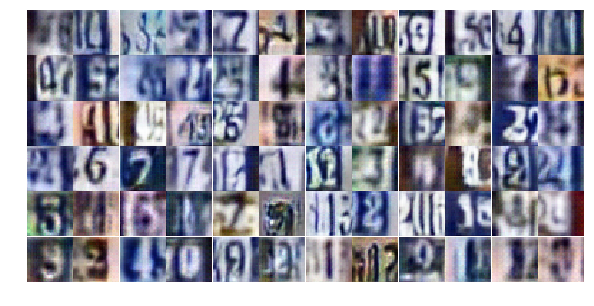

Epoch 14/25... Discriminator Loss: 1.1100... Generator Loss: 1.2286
Epoch 14/25... Discriminator Loss: 1.9047... Generator Loss: 0.2316
Epoch 14/25... Discriminator Loss: 0.8969... Generator Loss: 1.1107
Epoch 14/25... Discriminator Loss: 1.4068... Generator Loss: 0.4979
Epoch 14/25... Discriminator Loss: 1.2634... Generator Loss: 0.5204
Epoch 14/25... Discriminator Loss: 0.4964... Generator Loss: 1.2330
Epoch 14/25... Discriminator Loss: 1.1920... Generator Loss: 2.1389
Epoch 14/25... Discriminator Loss: 1.0660... Generator Loss: 0.8429
Epoch 14/25... Discriminator Loss: 1.5234... Generator Loss: 0.3968
Epoch 14/25... Discriminator Loss: 1.1109... Generator Loss: 0.6522


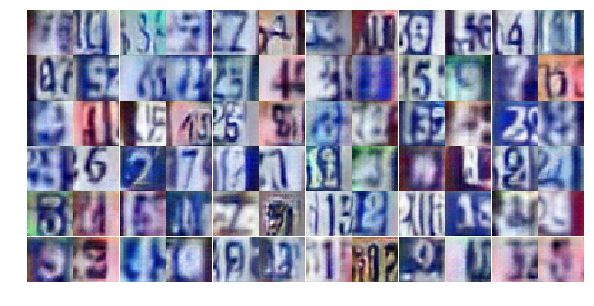

Epoch 14/25... Discriminator Loss: 0.9849... Generator Loss: 1.0803
Epoch 14/25... Discriminator Loss: 1.1727... Generator Loss: 0.5896
Epoch 15/25... Discriminator Loss: 0.7920... Generator Loss: 1.0376
Epoch 15/25... Discriminator Loss: 0.6805... Generator Loss: 1.3689
Epoch 15/25... Discriminator Loss: 1.2717... Generator Loss: 3.1229
Epoch 15/25... Discriminator Loss: 0.9977... Generator Loss: 0.7725
Epoch 15/25... Discriminator Loss: 1.1018... Generator Loss: 0.6348
Epoch 15/25... Discriminator Loss: 1.2553... Generator Loss: 0.5210
Epoch 15/25... Discriminator Loss: 1.5383... Generator Loss: 0.4476
Epoch 15/25... Discriminator Loss: 1.2829... Generator Loss: 0.5525


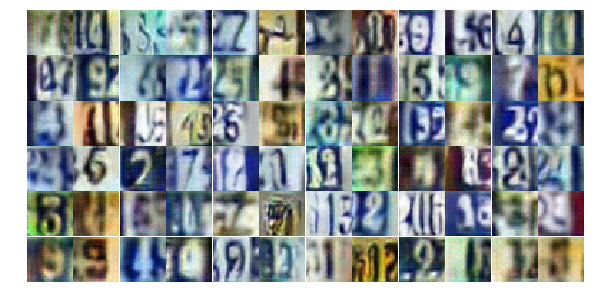

Epoch 15/25... Discriminator Loss: 1.2079... Generator Loss: 0.7076
Epoch 15/25... Discriminator Loss: 0.7610... Generator Loss: 1.2983
Epoch 15/25... Discriminator Loss: 1.6640... Generator Loss: 0.3614
Epoch 15/25... Discriminator Loss: 0.9082... Generator Loss: 0.9113
Epoch 15/25... Discriminator Loss: 1.8124... Generator Loss: 0.3099
Epoch 15/25... Discriminator Loss: 0.3754... Generator Loss: 1.7014
Epoch 15/25... Discriminator Loss: 1.4706... Generator Loss: 0.4392
Epoch 15/25... Discriminator Loss: 0.2157... Generator Loss: 3.9089
Epoch 15/25... Discriminator Loss: 0.6314... Generator Loss: 1.1108
Epoch 15/25... Discriminator Loss: 0.5808... Generator Loss: 2.0289


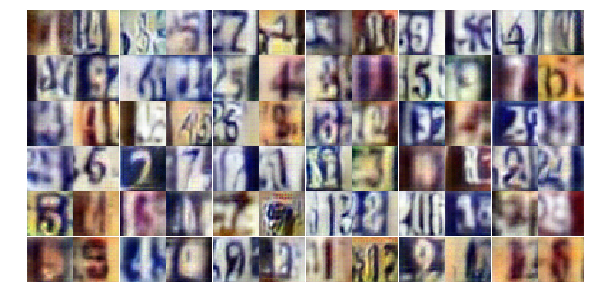

Epoch 15/25... Discriminator Loss: 1.4644... Generator Loss: 0.5232
Epoch 15/25... Discriminator Loss: 0.9226... Generator Loss: 1.1065
Epoch 15/25... Discriminator Loss: 0.9997... Generator Loss: 0.8099
Epoch 15/25... Discriminator Loss: 1.1666... Generator Loss: 0.6066
Epoch 15/25... Discriminator Loss: 1.0470... Generator Loss: 0.8351
Epoch 15/25... Discriminator Loss: 1.0267... Generator Loss: 0.8132
Epoch 15/25... Discriminator Loss: 1.5674... Generator Loss: 0.3587
Epoch 15/25... Discriminator Loss: 0.8732... Generator Loss: 0.9508
Epoch 15/25... Discriminator Loss: 0.8205... Generator Loss: 1.0318
Epoch 15/25... Discriminator Loss: 1.6675... Generator Loss: 0.3326


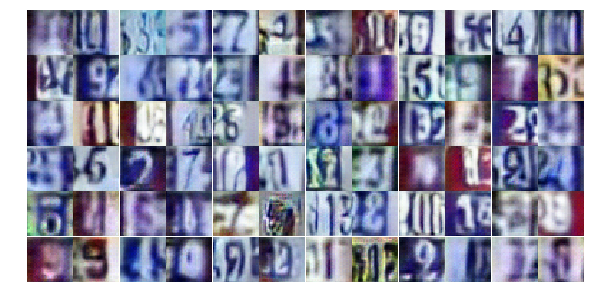

Epoch 15/25... Discriminator Loss: 0.9117... Generator Loss: 0.8378
Epoch 15/25... Discriminator Loss: 1.2490... Generator Loss: 0.6185
Epoch 15/25... Discriminator Loss: 0.6141... Generator Loss: 1.3874
Epoch 15/25... Discriminator Loss: 1.7313... Generator Loss: 0.3276
Epoch 15/25... Discriminator Loss: 0.7043... Generator Loss: 1.5683
Epoch 15/25... Discriminator Loss: 0.9122... Generator Loss: 0.8493
Epoch 15/25... Discriminator Loss: 0.6872... Generator Loss: 1.3692
Epoch 15/25... Discriminator Loss: 0.6422... Generator Loss: 2.0206
Epoch 15/25... Discriminator Loss: 0.5797... Generator Loss: 1.4525
Epoch 15/25... Discriminator Loss: 1.0029... Generator Loss: 0.8128


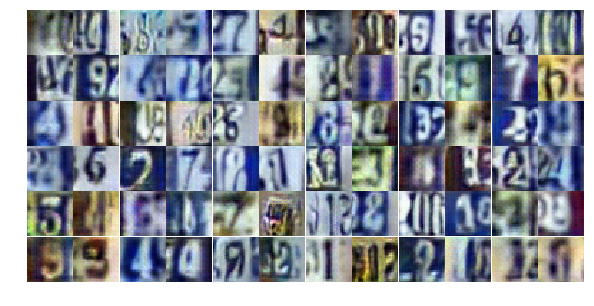

Epoch 15/25... Discriminator Loss: 0.8570... Generator Loss: 0.8514
Epoch 15/25... Discriminator Loss: 0.5424... Generator Loss: 2.2481
Epoch 15/25... Discriminator Loss: 0.5289... Generator Loss: 1.7738
Epoch 15/25... Discriminator Loss: 0.5810... Generator Loss: 1.3763
Epoch 15/25... Discriminator Loss: 1.4564... Generator Loss: 0.3996
Epoch 15/25... Discriminator Loss: 2.5141... Generator Loss: 0.2576
Epoch 15/25... Discriminator Loss: 0.8271... Generator Loss: 1.2994
Epoch 15/25... Discriminator Loss: 1.0400... Generator Loss: 2.2499
Epoch 15/25... Discriminator Loss: 0.6788... Generator Loss: 1.5231
Epoch 15/25... Discriminator Loss: 0.8308... Generator Loss: 0.9252


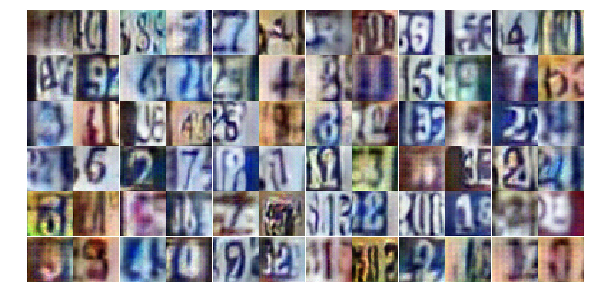

Epoch 15/25... Discriminator Loss: 1.5269... Generator Loss: 0.3766
Epoch 15/25... Discriminator Loss: 0.9873... Generator Loss: 0.8506
Epoch 15/25... Discriminator Loss: 0.5686... Generator Loss: 1.7422
Epoch 15/25... Discriminator Loss: 1.0650... Generator Loss: 0.7981
Epoch 15/25... Discriminator Loss: 1.0212... Generator Loss: 0.9004
Epoch 15/25... Discriminator Loss: 1.0561... Generator Loss: 0.7389
Epoch 15/25... Discriminator Loss: 1.2272... Generator Loss: 0.6243
Epoch 15/25... Discriminator Loss: 1.3752... Generator Loss: 0.5903
Epoch 15/25... Discriminator Loss: 1.7920... Generator Loss: 0.2715
Epoch 16/25... Discriminator Loss: 1.6788... Generator Loss: 0.4591


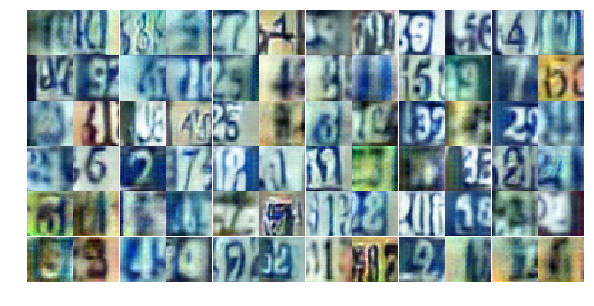

Epoch 16/25... Discriminator Loss: 1.1467... Generator Loss: 0.6320
Epoch 16/25... Discriminator Loss: 1.1056... Generator Loss: 0.6876
Epoch 16/25... Discriminator Loss: 1.1242... Generator Loss: 0.7647
Epoch 16/25... Discriminator Loss: 1.0411... Generator Loss: 0.7586
Epoch 16/25... Discriminator Loss: 0.6218... Generator Loss: 2.1170
Epoch 16/25... Discriminator Loss: 0.7877... Generator Loss: 1.1166
Epoch 16/25... Discriminator Loss: 1.9407... Generator Loss: 0.2457
Epoch 16/25... Discriminator Loss: 0.8502... Generator Loss: 0.9032
Epoch 16/25... Discriminator Loss: 1.1139... Generator Loss: 0.7057
Epoch 16/25... Discriminator Loss: 1.3135... Generator Loss: 0.5009


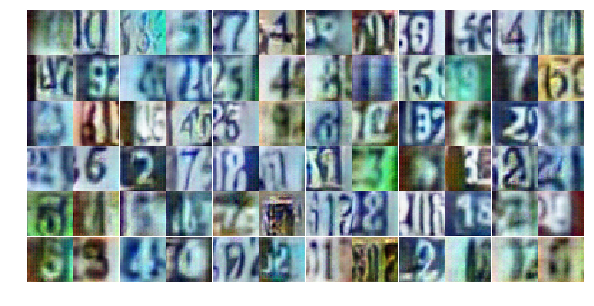

Epoch 16/25... Discriminator Loss: 1.3010... Generator Loss: 0.5283
Epoch 16/25... Discriminator Loss: 0.6557... Generator Loss: 1.3866
Epoch 16/25... Discriminator Loss: 0.6598... Generator Loss: 1.2486
Epoch 16/25... Discriminator Loss: 0.4850... Generator Loss: 1.7221
Epoch 16/25... Discriminator Loss: 0.7953... Generator Loss: 1.3749
Epoch 16/25... Discriminator Loss: 1.3229... Generator Loss: 0.6266
Epoch 16/25... Discriminator Loss: 1.6074... Generator Loss: 0.3731
Epoch 16/25... Discriminator Loss: 0.6356... Generator Loss: 2.0682
Epoch 16/25... Discriminator Loss: 0.6783... Generator Loss: 1.2560
Epoch 16/25... Discriminator Loss: 0.9544... Generator Loss: 0.8578


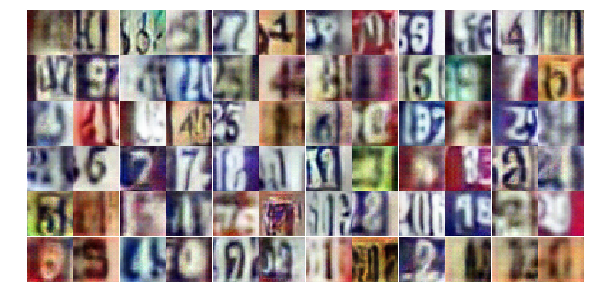

Epoch 16/25... Discriminator Loss: 1.2756... Generator Loss: 0.6787
Epoch 16/25... Discriminator Loss: 0.7562... Generator Loss: 1.4807
Epoch 16/25... Discriminator Loss: 1.0604... Generator Loss: 0.6829
Epoch 16/25... Discriminator Loss: 1.3642... Generator Loss: 0.5457
Epoch 16/25... Discriminator Loss: 0.5602... Generator Loss: 1.4588
Epoch 16/25... Discriminator Loss: 0.8836... Generator Loss: 0.8680
Epoch 16/25... Discriminator Loss: 0.6421... Generator Loss: 1.1198
Epoch 16/25... Discriminator Loss: 0.9283... Generator Loss: 0.7558
Epoch 16/25... Discriminator Loss: 1.0341... Generator Loss: 0.9425
Epoch 16/25... Discriminator Loss: 0.8568... Generator Loss: 0.9600


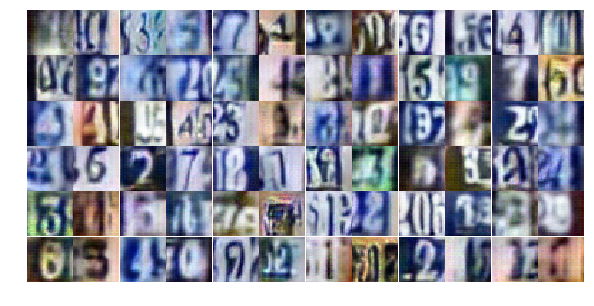

Epoch 16/25... Discriminator Loss: 0.9664... Generator Loss: 0.7511
Epoch 16/25... Discriminator Loss: 1.3774... Generator Loss: 0.5297
Epoch 16/25... Discriminator Loss: 0.8999... Generator Loss: 1.0772
Epoch 16/25... Discriminator Loss: 1.0337... Generator Loss: 0.9655
Epoch 16/25... Discriminator Loss: 1.1589... Generator Loss: 0.6425
Epoch 16/25... Discriminator Loss: 1.2544... Generator Loss: 0.5522
Epoch 16/25... Discriminator Loss: 0.7928... Generator Loss: 1.5174
Epoch 16/25... Discriminator Loss: 1.2208... Generator Loss: 0.5583
Epoch 16/25... Discriminator Loss: 1.6540... Generator Loss: 0.3239
Epoch 16/25... Discriminator Loss: 0.5725... Generator Loss: 1.5229


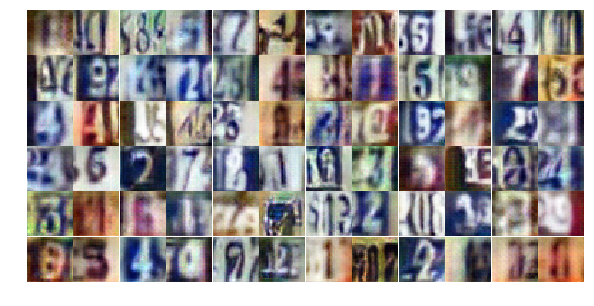

Epoch 16/25... Discriminator Loss: 0.7959... Generator Loss: 1.1099
Epoch 16/25... Discriminator Loss: 0.5716... Generator Loss: 1.7728
Epoch 16/25... Discriminator Loss: 1.7153... Generator Loss: 0.3770
Epoch 16/25... Discriminator Loss: 1.3078... Generator Loss: 0.7004
Epoch 16/25... Discriminator Loss: 0.7389... Generator Loss: 1.0407
Epoch 16/25... Discriminator Loss: 0.4088... Generator Loss: 1.7631
Epoch 16/25... Discriminator Loss: 1.4062... Generator Loss: 0.5483
Epoch 16/25... Discriminator Loss: 1.2209... Generator Loss: 0.6027
Epoch 16/25... Discriminator Loss: 0.5708... Generator Loss: 1.3147
Epoch 16/25... Discriminator Loss: 1.2151... Generator Loss: 0.5931


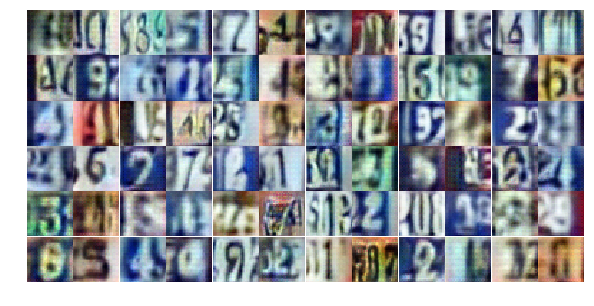

Epoch 16/25... Discriminator Loss: 1.5027... Generator Loss: 2.6556
Epoch 16/25... Discriminator Loss: 0.9309... Generator Loss: 1.9315
Epoch 16/25... Discriminator Loss: 1.4732... Generator Loss: 0.4561
Epoch 16/25... Discriminator Loss: 0.6084... Generator Loss: 1.3976
Epoch 16/25... Discriminator Loss: 0.3121... Generator Loss: 2.8568
Epoch 16/25... Discriminator Loss: 0.9108... Generator Loss: 2.4166
Epoch 17/25... Discriminator Loss: 1.7368... Generator Loss: 0.5105
Epoch 17/25... Discriminator Loss: 0.9417... Generator Loss: 0.9500
Epoch 17/25... Discriminator Loss: 0.7078... Generator Loss: 1.0781
Epoch 17/25... Discriminator Loss: 1.0913... Generator Loss: 0.7672


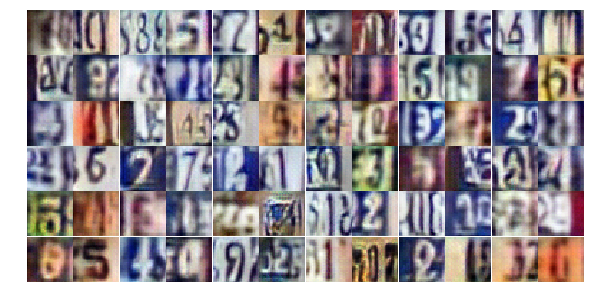

Epoch 17/25... Discriminator Loss: 1.0129... Generator Loss: 0.7866
Epoch 17/25... Discriminator Loss: 0.8862... Generator Loss: 0.8923
Epoch 17/25... Discriminator Loss: 1.6525... Generator Loss: 0.4598
Epoch 17/25... Discriminator Loss: 0.3063... Generator Loss: 2.3432
Epoch 17/25... Discriminator Loss: 1.6048... Generator Loss: 0.4482
Epoch 17/25... Discriminator Loss: 1.4876... Generator Loss: 0.5016
Epoch 17/25... Discriminator Loss: 0.9394... Generator Loss: 0.9291
Epoch 17/25... Discriminator Loss: 0.5415... Generator Loss: 1.4160
Epoch 17/25... Discriminator Loss: 1.1140... Generator Loss: 0.6678
Epoch 17/25... Discriminator Loss: 0.6343... Generator Loss: 2.3056


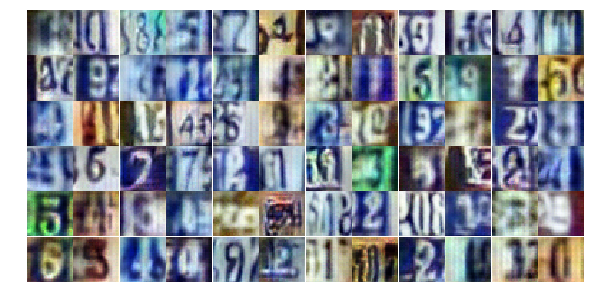

Epoch 17/25... Discriminator Loss: 0.9372... Generator Loss: 1.4200
Epoch 17/25... Discriminator Loss: 0.8971... Generator Loss: 2.8042
Epoch 17/25... Discriminator Loss: 1.0147... Generator Loss: 0.8155
Epoch 17/25... Discriminator Loss: 1.0036... Generator Loss: 1.0397
Epoch 17/25... Discriminator Loss: 0.9279... Generator Loss: 0.8286
Epoch 17/25... Discriminator Loss: 1.8034... Generator Loss: 0.3597
Epoch 17/25... Discriminator Loss: 0.8586... Generator Loss: 1.1025
Epoch 17/25... Discriminator Loss: 0.8731... Generator Loss: 1.0091
Epoch 17/25... Discriminator Loss: 0.8830... Generator Loss: 1.1933
Epoch 17/25... Discriminator Loss: 0.6015... Generator Loss: 1.6251


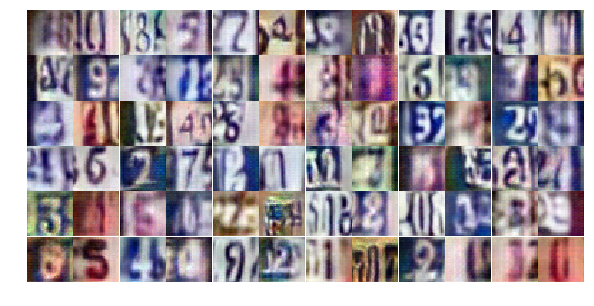

Epoch 17/25... Discriminator Loss: 2.2673... Generator Loss: 0.2069
Epoch 17/25... Discriminator Loss: 0.8486... Generator Loss: 1.0030
Epoch 17/25... Discriminator Loss: 0.3975... Generator Loss: 2.7836
Epoch 17/25... Discriminator Loss: 1.8114... Generator Loss: 0.3097
Epoch 17/25... Discriminator Loss: 1.7596... Generator Loss: 0.4126
Epoch 17/25... Discriminator Loss: 0.1331... Generator Loss: 3.2360
Epoch 17/25... Discriminator Loss: 0.6546... Generator Loss: 1.4846
Epoch 17/25... Discriminator Loss: 1.3140... Generator Loss: 0.4630
Epoch 17/25... Discriminator Loss: 1.0514... Generator Loss: 0.8080
Epoch 17/25... Discriminator Loss: 0.0984... Generator Loss: 3.7779


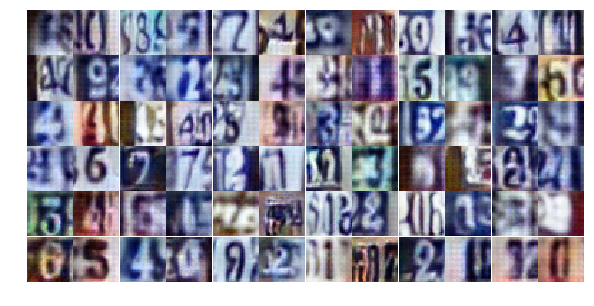

Epoch 17/25... Discriminator Loss: 1.4425... Generator Loss: 0.4812
Epoch 17/25... Discriminator Loss: 1.6220... Generator Loss: 0.3601
Epoch 17/25... Discriminator Loss: 0.5056... Generator Loss: 2.0768
Epoch 17/25... Discriminator Loss: 0.5929... Generator Loss: 1.8623
Epoch 17/25... Discriminator Loss: 1.0150... Generator Loss: 2.5263
Epoch 17/25... Discriminator Loss: 1.1206... Generator Loss: 0.6463
Epoch 17/25... Discriminator Loss: 1.1121... Generator Loss: 1.3719
Epoch 17/25... Discriminator Loss: 0.3651... Generator Loss: 1.8791
Epoch 17/25... Discriminator Loss: 0.6310... Generator Loss: 1.4294
Epoch 17/25... Discriminator Loss: 1.8064... Generator Loss: 0.3253


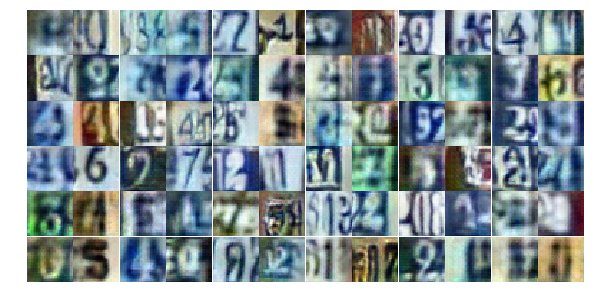

Epoch 17/25... Discriminator Loss: 1.2028... Generator Loss: 0.6387
Epoch 17/25... Discriminator Loss: 0.4415... Generator Loss: 1.8163
Epoch 17/25... Discriminator Loss: 1.4863... Generator Loss: 0.5584
Epoch 17/25... Discriminator Loss: 0.4736... Generator Loss: 1.9417
Epoch 17/25... Discriminator Loss: 1.3143... Generator Loss: 1.8443
Epoch 17/25... Discriminator Loss: 0.9851... Generator Loss: 1.0389
Epoch 17/25... Discriminator Loss: 1.0039... Generator Loss: 0.7232
Epoch 17/25... Discriminator Loss: 1.2017... Generator Loss: 0.5903
Epoch 17/25... Discriminator Loss: 6.8015... Generator Loss: 3.2367
Epoch 17/25... Discriminator Loss: 1.3633... Generator Loss: 0.9901


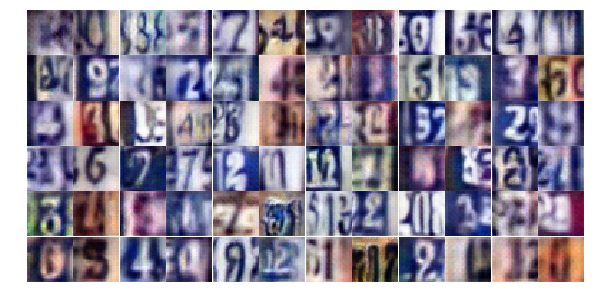

Epoch 17/25... Discriminator Loss: 1.0793... Generator Loss: 1.4750
Epoch 17/25... Discriminator Loss: 1.1460... Generator Loss: 0.6792
Epoch 17/25... Discriminator Loss: 0.8618... Generator Loss: 0.9522
Epoch 17/25... Discriminator Loss: 0.9889... Generator Loss: 1.6006
Epoch 18/25... Discriminator Loss: 1.3455... Generator Loss: 0.5784
Epoch 18/25... Discriminator Loss: 0.7823... Generator Loss: 1.0817
Epoch 18/25... Discriminator Loss: 1.2810... Generator Loss: 0.5532
Epoch 18/25... Discriminator Loss: 1.1456... Generator Loss: 0.5768
Epoch 18/25... Discriminator Loss: 1.0764... Generator Loss: 0.7996
Epoch 18/25... Discriminator Loss: 0.7514... Generator Loss: 1.2817


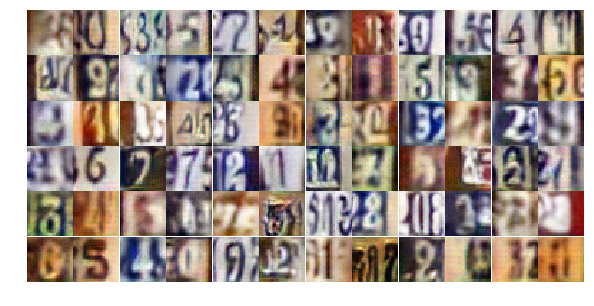

Epoch 18/25... Discriminator Loss: 0.7329... Generator Loss: 2.5670
Epoch 18/25... Discriminator Loss: 1.2196... Generator Loss: 0.5588
Epoch 18/25... Discriminator Loss: 0.7029... Generator Loss: 1.3949
Epoch 18/25... Discriminator Loss: 0.5240... Generator Loss: 1.6682
Epoch 18/25... Discriminator Loss: 0.9498... Generator Loss: 0.8896
Epoch 18/25... Discriminator Loss: 1.1957... Generator Loss: 0.5983
Epoch 18/25... Discriminator Loss: 1.5531... Generator Loss: 0.4039
Epoch 18/25... Discriminator Loss: 0.6228... Generator Loss: 1.1382
Epoch 18/25... Discriminator Loss: 0.6486... Generator Loss: 1.7219
Epoch 18/25... Discriminator Loss: 0.5013... Generator Loss: 1.5265


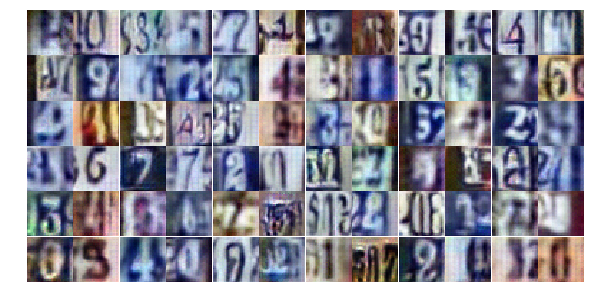

Epoch 18/25... Discriminator Loss: 1.6365... Generator Loss: 0.3626
Epoch 18/25... Discriminator Loss: 0.6146... Generator Loss: 1.4713
Epoch 18/25... Discriminator Loss: 1.4264... Generator Loss: 0.4881
Epoch 18/25... Discriminator Loss: 0.6610... Generator Loss: 1.7261
Epoch 18/25... Discriminator Loss: 1.8935... Generator Loss: 0.3973
Epoch 18/25... Discriminator Loss: 0.5454... Generator Loss: 1.3939
Epoch 18/25... Discriminator Loss: 0.7963... Generator Loss: 1.0799
Epoch 18/25... Discriminator Loss: 0.8053... Generator Loss: 1.1779
Epoch 18/25... Discriminator Loss: 0.7008... Generator Loss: 1.3150
Epoch 18/25... Discriminator Loss: 0.6145... Generator Loss: 1.3642


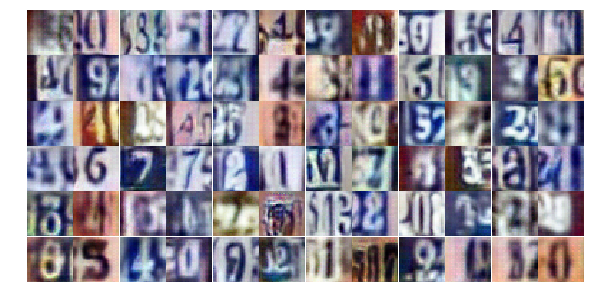

Epoch 18/25... Discriminator Loss: 0.6865... Generator Loss: 1.5789
Epoch 18/25... Discriminator Loss: 0.5064... Generator Loss: 1.6473
Epoch 18/25... Discriminator Loss: 1.5092... Generator Loss: 0.4899
Epoch 18/25... Discriminator Loss: 0.9095... Generator Loss: 1.2766
Epoch 18/25... Discriminator Loss: 1.1932... Generator Loss: 0.6353
Epoch 18/25... Discriminator Loss: 0.7851... Generator Loss: 1.5368
Epoch 18/25... Discriminator Loss: 0.8755... Generator Loss: 1.2466
Epoch 18/25... Discriminator Loss: 1.1233... Generator Loss: 0.7066
Epoch 18/25... Discriminator Loss: 0.9474... Generator Loss: 0.9609
Epoch 18/25... Discriminator Loss: 0.5162... Generator Loss: 1.5368


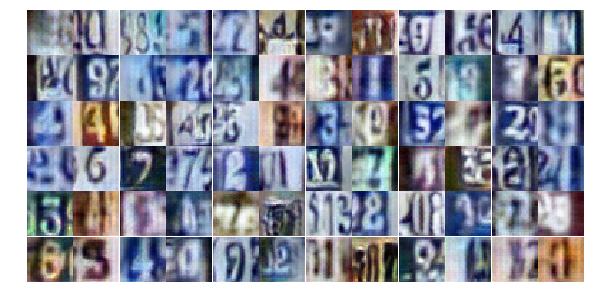

Epoch 18/25... Discriminator Loss: 0.7306... Generator Loss: 1.4632
Epoch 18/25... Discriminator Loss: 0.6849... Generator Loss: 2.0341
Epoch 18/25... Discriminator Loss: 0.9411... Generator Loss: 1.8634
Epoch 18/25... Discriminator Loss: 1.2004... Generator Loss: 0.6266
Epoch 18/25... Discriminator Loss: 1.1157... Generator Loss: 0.6734
Epoch 18/25... Discriminator Loss: 0.6557... Generator Loss: 1.4133
Epoch 18/25... Discriminator Loss: 0.8785... Generator Loss: 1.0739
Epoch 18/25... Discriminator Loss: 1.0323... Generator Loss: 1.5331
Epoch 18/25... Discriminator Loss: 0.7866... Generator Loss: 1.0691
Epoch 18/25... Discriminator Loss: 0.3974... Generator Loss: 1.8580


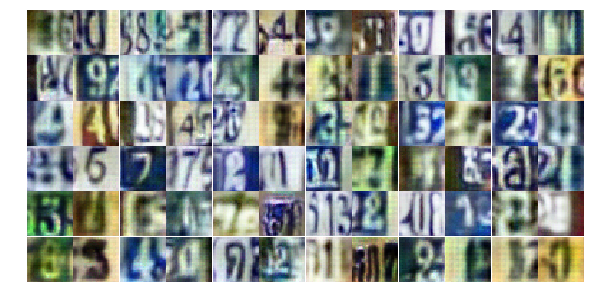

Epoch 18/25... Discriminator Loss: 0.5731... Generator Loss: 1.3348
Epoch 18/25... Discriminator Loss: 1.3498... Generator Loss: 0.5592
Epoch 18/25... Discriminator Loss: 0.7897... Generator Loss: 0.9397
Epoch 18/25... Discriminator Loss: 1.4287... Generator Loss: 0.4836
Epoch 18/25... Discriminator Loss: 0.7212... Generator Loss: 1.0978
Epoch 18/25... Discriminator Loss: 0.6759... Generator Loss: 1.1682
Epoch 18/25... Discriminator Loss: 0.5932... Generator Loss: 1.2347
Epoch 18/25... Discriminator Loss: 0.6386... Generator Loss: 1.6760
Epoch 18/25... Discriminator Loss: 2.0397... Generator Loss: 0.2497
Epoch 18/25... Discriminator Loss: 0.7696... Generator Loss: 1.0791


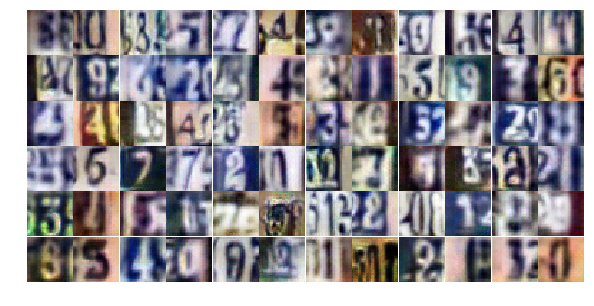

Epoch 18/25... Discriminator Loss: 0.7109... Generator Loss: 2.2746
Epoch 19/25... Discriminator Loss: 1.4686... Generator Loss: 0.5450
Epoch 19/25... Discriminator Loss: 2.1197... Generator Loss: 0.2634
Epoch 19/25... Discriminator Loss: 0.8321... Generator Loss: 2.4957
Epoch 19/25... Discriminator Loss: 0.8050... Generator Loss: 1.1443
Epoch 19/25... Discriminator Loss: 1.3132... Generator Loss: 0.6506
Epoch 19/25... Discriminator Loss: 1.1143... Generator Loss: 0.7424
Epoch 19/25... Discriminator Loss: 0.4021... Generator Loss: 1.5297
Epoch 19/25... Discriminator Loss: 2.0373... Generator Loss: 0.2864
Epoch 19/25... Discriminator Loss: 1.5158... Generator Loss: 0.4906


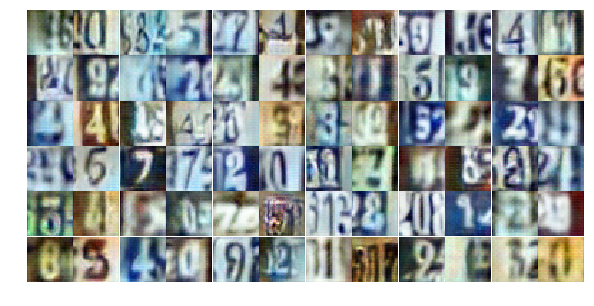

Epoch 19/25... Discriminator Loss: 0.5247... Generator Loss: 1.5074
Epoch 19/25... Discriminator Loss: 1.1986... Generator Loss: 0.5433
Epoch 19/25... Discriminator Loss: 1.1393... Generator Loss: 0.6001
Epoch 19/25... Discriminator Loss: 1.9750... Generator Loss: 0.2642
Epoch 19/25... Discriminator Loss: 1.0577... Generator Loss: 0.7209
Epoch 19/25... Discriminator Loss: 0.4379... Generator Loss: 2.2571
Epoch 19/25... Discriminator Loss: 1.1030... Generator Loss: 0.8330
Epoch 19/25... Discriminator Loss: 0.5112... Generator Loss: 1.8480
Epoch 19/25... Discriminator Loss: 0.3944... Generator Loss: 2.6680
Epoch 19/25... Discriminator Loss: 0.3658... Generator Loss: 2.5745


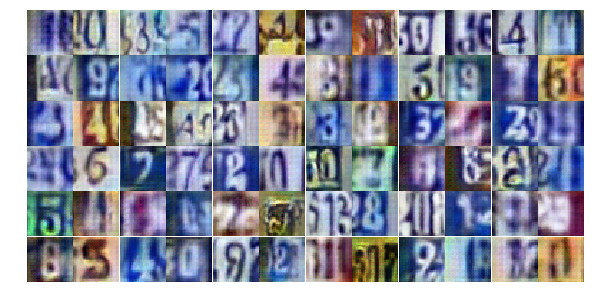

Epoch 19/25... Discriminator Loss: 0.4025... Generator Loss: 2.0815
Epoch 19/25... Discriminator Loss: 1.9086... Generator Loss: 0.3861
Epoch 19/25... Discriminator Loss: 1.6461... Generator Loss: 0.3898
Epoch 19/25... Discriminator Loss: 0.8778... Generator Loss: 2.4544
Epoch 19/25... Discriminator Loss: 0.9413... Generator Loss: 0.9758
Epoch 19/25... Discriminator Loss: 0.5467... Generator Loss: 1.6823
Epoch 19/25... Discriminator Loss: 0.9344... Generator Loss: 0.9680
Epoch 19/25... Discriminator Loss: 0.6157... Generator Loss: 2.1213
Epoch 19/25... Discriminator Loss: 0.8391... Generator Loss: 1.0011
Epoch 19/25... Discriminator Loss: 0.9763... Generator Loss: 1.0278


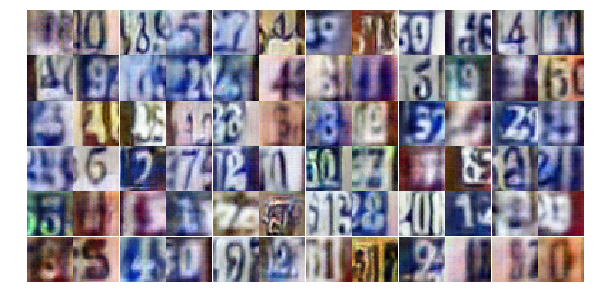

Epoch 19/25... Discriminator Loss: 1.2564... Generator Loss: 0.5930
Epoch 19/25... Discriminator Loss: 0.4850... Generator Loss: 1.3235
Epoch 19/25... Discriminator Loss: 0.9226... Generator Loss: 0.9919
Epoch 19/25... Discriminator Loss: 0.8510... Generator Loss: 1.0577
Epoch 19/25... Discriminator Loss: 0.9978... Generator Loss: 0.8476
Epoch 19/25... Discriminator Loss: 2.3408... Generator Loss: 0.2098
Epoch 19/25... Discriminator Loss: 0.8769... Generator Loss: 1.1222
Epoch 19/25... Discriminator Loss: 1.1644... Generator Loss: 0.7162
Epoch 19/25... Discriminator Loss: 0.9985... Generator Loss: 0.9425
Epoch 19/25... Discriminator Loss: 0.9151... Generator Loss: 0.8259


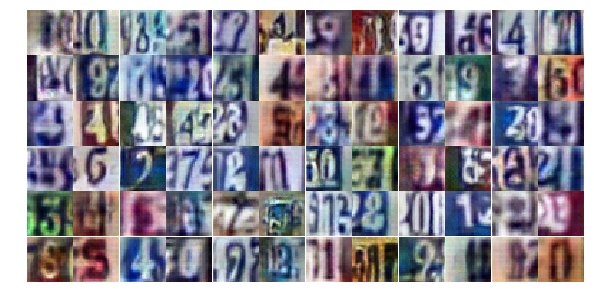

Epoch 19/25... Discriminator Loss: 0.8962... Generator Loss: 0.9164
Epoch 19/25... Discriminator Loss: 1.5946... Generator Loss: 0.4553
Epoch 19/25... Discriminator Loss: 1.8835... Generator Loss: 0.2722
Epoch 19/25... Discriminator Loss: 0.5359... Generator Loss: 1.4671
Epoch 19/25... Discriminator Loss: 0.4008... Generator Loss: 2.3839
Epoch 19/25... Discriminator Loss: 0.5946... Generator Loss: 2.2320
Epoch 19/25... Discriminator Loss: 1.2622... Generator Loss: 0.6459
Epoch 19/25... Discriminator Loss: 0.6295... Generator Loss: 1.4155
Epoch 19/25... Discriminator Loss: 0.8755... Generator Loss: 1.2687
Epoch 19/25... Discriminator Loss: 1.1936... Generator Loss: 0.7841


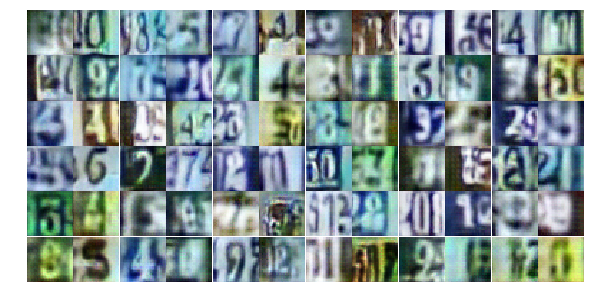

Epoch 19/25... Discriminator Loss: 1.2783... Generator Loss: 0.5930
Epoch 19/25... Discriminator Loss: 0.6520... Generator Loss: 1.4739
Epoch 19/25... Discriminator Loss: 0.9933... Generator Loss: 1.6891
Epoch 19/25... Discriminator Loss: 1.0317... Generator Loss: 1.9306
Epoch 19/25... Discriminator Loss: 0.5509... Generator Loss: 1.5598
Epoch 19/25... Discriminator Loss: 0.6073... Generator Loss: 2.2584
Epoch 19/25... Discriminator Loss: 3.5600... Generator Loss: 0.0743
Epoch 19/25... Discriminator Loss: 1.3890... Generator Loss: 2.0899
Epoch 20/25... Discriminator Loss: 1.4299... Generator Loss: 0.9523
Epoch 20/25... Discriminator Loss: 1.0557... Generator Loss: 1.0168


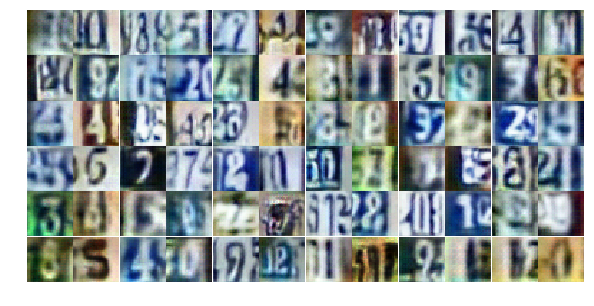

Epoch 20/25... Discriminator Loss: 1.2104... Generator Loss: 0.6096
Epoch 20/25... Discriminator Loss: 0.9971... Generator Loss: 0.8712
Epoch 20/25... Discriminator Loss: 1.2411... Generator Loss: 0.6667
Epoch 20/25... Discriminator Loss: 0.7843... Generator Loss: 0.9386
Epoch 20/25... Discriminator Loss: 0.4818... Generator Loss: 2.2618
Epoch 20/25... Discriminator Loss: 1.0370... Generator Loss: 0.7276
Epoch 20/25... Discriminator Loss: 0.8405... Generator Loss: 0.9629
Epoch 20/25... Discriminator Loss: 1.2198... Generator Loss: 0.5873
Epoch 20/25... Discriminator Loss: 1.3281... Generator Loss: 0.6060
Epoch 20/25... Discriminator Loss: 0.9844... Generator Loss: 0.6822


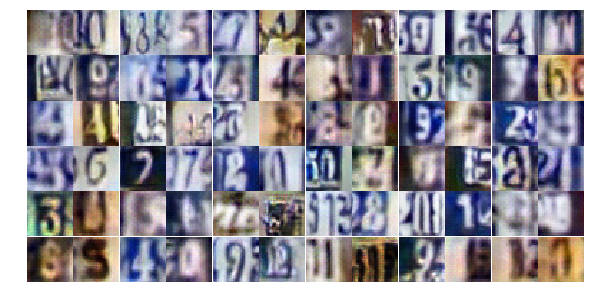

Epoch 20/25... Discriminator Loss: 1.2629... Generator Loss: 0.6951
Epoch 20/25... Discriminator Loss: 1.0355... Generator Loss: 0.9778
Epoch 20/25... Discriminator Loss: 1.4213... Generator Loss: 0.6092
Epoch 20/25... Discriminator Loss: 1.2268... Generator Loss: 0.5948
Epoch 20/25... Discriminator Loss: 1.0722... Generator Loss: 0.7405
Epoch 20/25... Discriminator Loss: 0.7551... Generator Loss: 1.0377
Epoch 20/25... Discriminator Loss: 1.3601... Generator Loss: 0.4785
Epoch 20/25... Discriminator Loss: 0.7416... Generator Loss: 1.3537
Epoch 20/25... Discriminator Loss: 0.6784... Generator Loss: 1.1406
Epoch 20/25... Discriminator Loss: 1.4321... Generator Loss: 0.5422


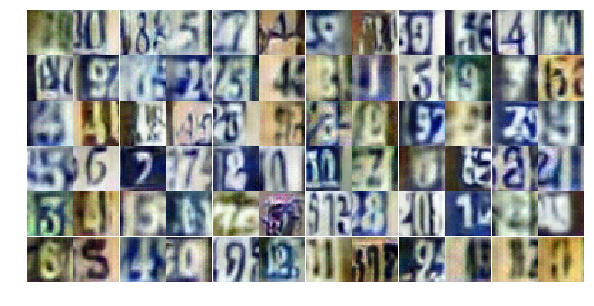

Epoch 20/25... Discriminator Loss: 0.7193... Generator Loss: 1.0650
Epoch 20/25... Discriminator Loss: 0.8092... Generator Loss: 0.9794
Epoch 20/25... Discriminator Loss: 0.2793... Generator Loss: 3.2380
Epoch 20/25... Discriminator Loss: 1.6959... Generator Loss: 0.3831
Epoch 20/25... Discriminator Loss: 1.3290... Generator Loss: 0.5903
Epoch 20/25... Discriminator Loss: 0.5977... Generator Loss: 1.4641
Epoch 20/25... Discriminator Loss: 0.7943... Generator Loss: 2.0399
Epoch 20/25... Discriminator Loss: 2.1612... Generator Loss: 0.3589
Epoch 20/25... Discriminator Loss: 1.5172... Generator Loss: 0.5359
Epoch 20/25... Discriminator Loss: 0.7968... Generator Loss: 0.9705


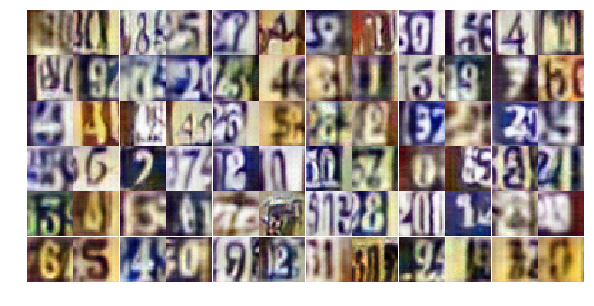

Epoch 20/25... Discriminator Loss: 0.6906... Generator Loss: 1.2440
Epoch 20/25... Discriminator Loss: 0.5229... Generator Loss: 1.4631
Epoch 20/25... Discriminator Loss: 0.8942... Generator Loss: 1.2020
Epoch 20/25... Discriminator Loss: 0.6813... Generator Loss: 1.2111
Epoch 20/25... Discriminator Loss: 1.7672... Generator Loss: 0.3420
Epoch 20/25... Discriminator Loss: 0.6064... Generator Loss: 2.9980
Epoch 20/25... Discriminator Loss: 0.9266... Generator Loss: 1.4512
Epoch 20/25... Discriminator Loss: 0.6400... Generator Loss: 2.0286
Epoch 20/25... Discriminator Loss: 1.0007... Generator Loss: 1.1506
Epoch 20/25... Discriminator Loss: 1.0572... Generator Loss: 0.7834


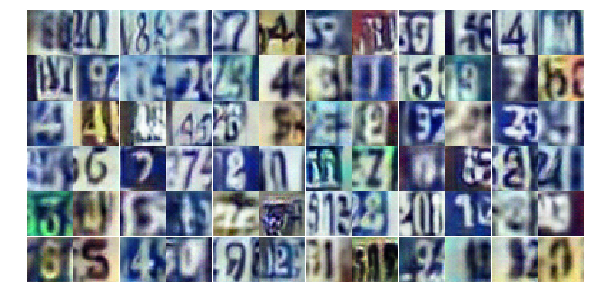

Epoch 20/25... Discriminator Loss: 0.8104... Generator Loss: 1.0927
Epoch 20/25... Discriminator Loss: 1.4067... Generator Loss: 0.5642
Epoch 20/25... Discriminator Loss: 1.1393... Generator Loss: 0.6815
Epoch 20/25... Discriminator Loss: 0.7106... Generator Loss: 1.1135
Epoch 20/25... Discriminator Loss: 1.3276... Generator Loss: 0.8799
Epoch 20/25... Discriminator Loss: 1.4094... Generator Loss: 0.6991
Epoch 20/25... Discriminator Loss: 1.3919... Generator Loss: 0.5490
Epoch 20/25... Discriminator Loss: 0.5532... Generator Loss: 1.3754
Epoch 20/25... Discriminator Loss: 0.8505... Generator Loss: 1.0507
Epoch 20/25... Discriminator Loss: 0.5778... Generator Loss: 1.3105


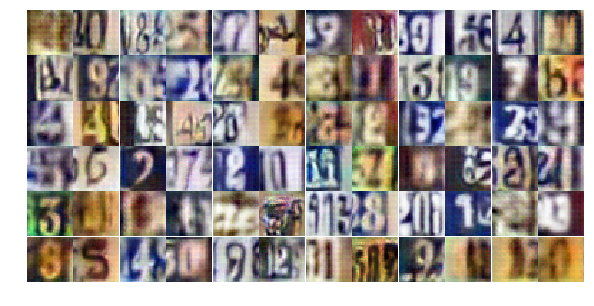

Epoch 20/25... Discriminator Loss: 0.6421... Generator Loss: 1.3311
Epoch 20/25... Discriminator Loss: 0.4954... Generator Loss: 1.4634
Epoch 20/25... Discriminator Loss: 0.8725... Generator Loss: 0.8335
Epoch 20/25... Discriminator Loss: 1.7029... Generator Loss: 3.0418
Epoch 20/25... Discriminator Loss: 1.0541... Generator Loss: 0.8916
Epoch 20/25... Discriminator Loss: 0.5727... Generator Loss: 1.4789
Epoch 21/25... Discriminator Loss: 2.1112... Generator Loss: 0.4207
Epoch 21/25... Discriminator Loss: 0.6729... Generator Loss: 1.4543
Epoch 21/25... Discriminator Loss: 1.6471... Generator Loss: 0.3642
Epoch 21/25... Discriminator Loss: 2.3570... Generator Loss: 0.2111


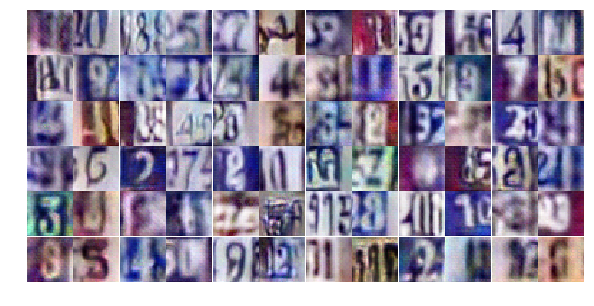

Epoch 21/25... Discriminator Loss: 1.3685... Generator Loss: 0.5392
Epoch 21/25... Discriminator Loss: 2.4741... Generator Loss: 0.2450
Epoch 21/25... Discriminator Loss: 0.4555... Generator Loss: 1.4868
Epoch 21/25... Discriminator Loss: 0.5753... Generator Loss: 1.3812
Epoch 21/25... Discriminator Loss: 0.8490... Generator Loss: 1.0637
Epoch 21/25... Discriminator Loss: 0.4605... Generator Loss: 1.6208
Epoch 21/25... Discriminator Loss: 0.7647... Generator Loss: 1.0116
Epoch 21/25... Discriminator Loss: 2.3641... Generator Loss: 0.2070
Epoch 21/25... Discriminator Loss: 1.8894... Generator Loss: 0.4146
Epoch 21/25... Discriminator Loss: 1.8277... Generator Loss: 0.3491


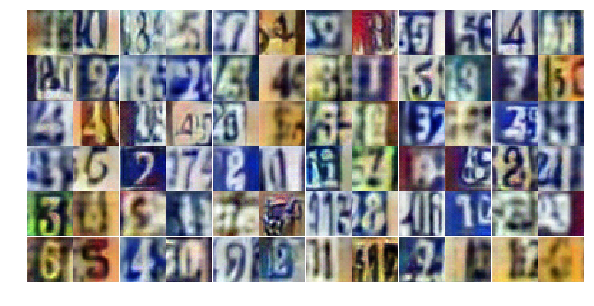

Epoch 21/25... Discriminator Loss: 0.3900... Generator Loss: 2.1231
Epoch 21/25... Discriminator Loss: 1.2014... Generator Loss: 0.7295
Epoch 21/25... Discriminator Loss: 2.0913... Generator Loss: 0.3981
Epoch 21/25... Discriminator Loss: 1.4647... Generator Loss: 0.5633
Epoch 21/25... Discriminator Loss: 0.5821... Generator Loss: 1.4155
Epoch 21/25... Discriminator Loss: 1.3875... Generator Loss: 0.5075
Epoch 21/25... Discriminator Loss: 1.1240... Generator Loss: 0.6267
Epoch 21/25... Discriminator Loss: 0.9992... Generator Loss: 0.7583
Epoch 21/25... Discriminator Loss: 0.2965... Generator Loss: 2.0078
Epoch 21/25... Discriminator Loss: 2.0506... Generator Loss: 0.2746


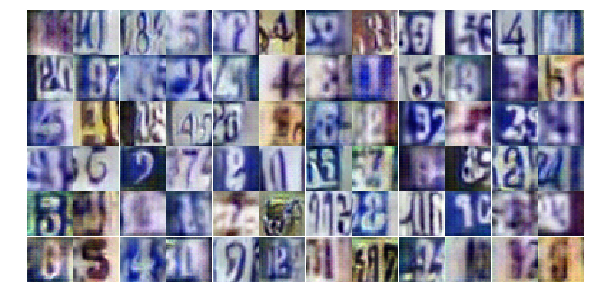

Epoch 21/25... Discriminator Loss: 2.0016... Generator Loss: 0.3879
Epoch 21/25... Discriminator Loss: 0.6731... Generator Loss: 1.1803
Epoch 21/25... Discriminator Loss: 1.2914... Generator Loss: 0.6083
Epoch 21/25... Discriminator Loss: 1.0697... Generator Loss: 0.7561
Epoch 21/25... Discriminator Loss: 0.7062... Generator Loss: 1.5299
Epoch 21/25... Discriminator Loss: 1.9428... Generator Loss: 0.3273
Epoch 21/25... Discriminator Loss: 0.4950... Generator Loss: 1.7725
Epoch 21/25... Discriminator Loss: 1.9694... Generator Loss: 0.4027
Epoch 21/25... Discriminator Loss: 1.5823... Generator Loss: 0.5022
Epoch 21/25... Discriminator Loss: 1.7471... Generator Loss: 0.4619


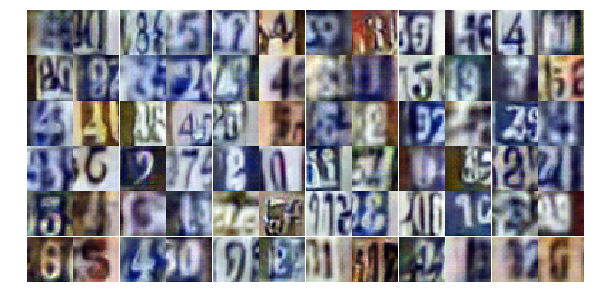

Epoch 21/25... Discriminator Loss: 1.4169... Generator Loss: 0.6734
Epoch 21/25... Discriminator Loss: 0.5367... Generator Loss: 2.1429
Epoch 21/25... Discriminator Loss: 1.8732... Generator Loss: 0.3781
Epoch 21/25... Discriminator Loss: 0.4694... Generator Loss: 1.7750
Epoch 21/25... Discriminator Loss: 0.5731... Generator Loss: 1.5172
Epoch 21/25... Discriminator Loss: 0.6871... Generator Loss: 1.1248
Epoch 21/25... Discriminator Loss: 0.4409... Generator Loss: 1.7747
Epoch 21/25... Discriminator Loss: 2.0358... Generator Loss: 0.3031
Epoch 21/25... Discriminator Loss: 0.7779... Generator Loss: 1.0458
Epoch 21/25... Discriminator Loss: 0.5110... Generator Loss: 2.1978


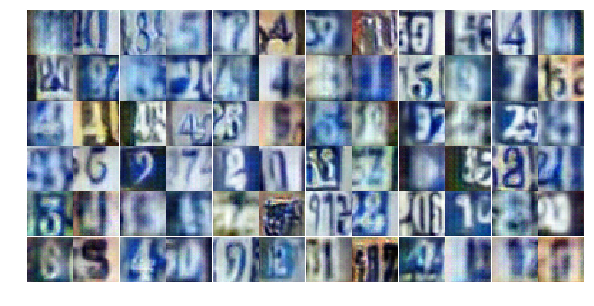

Epoch 21/25... Discriminator Loss: 1.6003... Generator Loss: 0.5117
Epoch 21/25... Discriminator Loss: 1.0375... Generator Loss: 0.9792
Epoch 21/25... Discriminator Loss: 0.9113... Generator Loss: 0.8697
Epoch 21/25... Discriminator Loss: 1.2274... Generator Loss: 0.6129
Epoch 21/25... Discriminator Loss: 0.5380... Generator Loss: 1.5138
Epoch 21/25... Discriminator Loss: 0.4105... Generator Loss: 1.9427
Epoch 21/25... Discriminator Loss: 0.7496... Generator Loss: 1.2512
Epoch 21/25... Discriminator Loss: 2.4085... Generator Loss: 0.1927
Epoch 21/25... Discriminator Loss: 1.3409... Generator Loss: 0.5784
Epoch 21/25... Discriminator Loss: 1.9659... Generator Loss: 0.4139


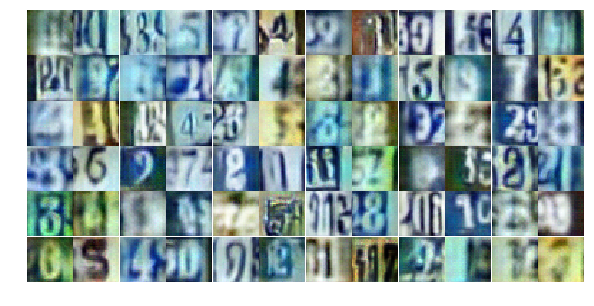

Epoch 21/25... Discriminator Loss: 0.8610... Generator Loss: 1.7618
Epoch 21/25... Discriminator Loss: 0.5824... Generator Loss: 1.7292
Epoch 21/25... Discriminator Loss: 0.8584... Generator Loss: 1.2734
Epoch 22/25... Discriminator Loss: 1.0411... Generator Loss: 0.8375
Epoch 22/25... Discriminator Loss: 1.4193... Generator Loss: 2.0500
Epoch 22/25... Discriminator Loss: 1.2656... Generator Loss: 0.8881
Epoch 22/25... Discriminator Loss: 0.6170... Generator Loss: 1.3209
Epoch 22/25... Discriminator Loss: 0.3851... Generator Loss: 3.2542
Epoch 22/25... Discriminator Loss: 0.8193... Generator Loss: 1.1723
Epoch 22/25... Discriminator Loss: 1.3987... Generator Loss: 0.5955


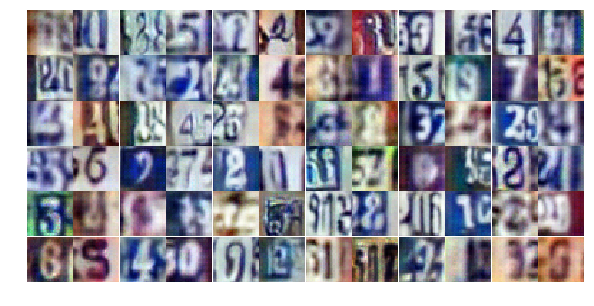

Epoch 22/25... Discriminator Loss: 0.7107... Generator Loss: 1.1713
Epoch 22/25... Discriminator Loss: 1.3393... Generator Loss: 0.5573
Epoch 22/25... Discriminator Loss: 1.5042... Generator Loss: 0.5071
Epoch 22/25... Discriminator Loss: 0.7679... Generator Loss: 1.0163
Epoch 22/25... Discriminator Loss: 1.0001... Generator Loss: 1.0321
Epoch 22/25... Discriminator Loss: 1.1781... Generator Loss: 0.7656
Epoch 22/25... Discriminator Loss: 0.8224... Generator Loss: 0.9905
Epoch 22/25... Discriminator Loss: 1.3161... Generator Loss: 0.5673
Epoch 22/25... Discriminator Loss: 1.0517... Generator Loss: 0.8789
Epoch 22/25... Discriminator Loss: 2.7926... Generator Loss: 0.2617


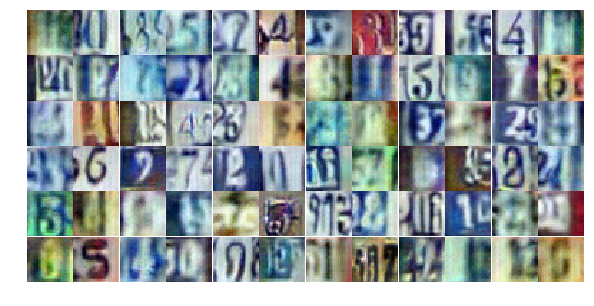

Epoch 22/25... Discriminator Loss: 0.5955... Generator Loss: 1.6525
Epoch 22/25... Discriminator Loss: 1.3190... Generator Loss: 0.6437
Epoch 22/25... Discriminator Loss: 1.0467... Generator Loss: 0.8172
Epoch 22/25... Discriminator Loss: 1.0519... Generator Loss: 0.7109
Epoch 22/25... Discriminator Loss: 0.8743... Generator Loss: 1.0202
Epoch 22/25... Discriminator Loss: 2.2977... Generator Loss: 0.6103
Epoch 22/25... Discriminator Loss: 0.5516... Generator Loss: 1.6337
Epoch 22/25... Discriminator Loss: 0.6003... Generator Loss: 1.3469
Epoch 22/25... Discriminator Loss: 0.7622... Generator Loss: 1.8786
Epoch 22/25... Discriminator Loss: 1.1338... Generator Loss: 0.7588


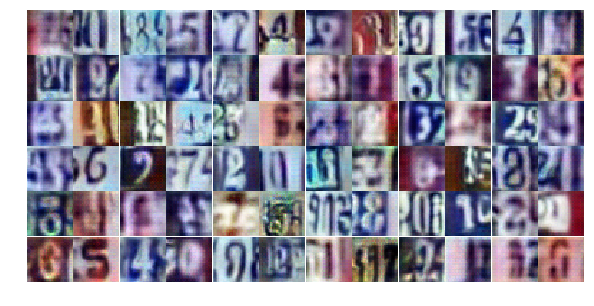

Epoch 22/25... Discriminator Loss: 0.7555... Generator Loss: 1.1726
Epoch 22/25... Discriminator Loss: 0.6504... Generator Loss: 2.2317
Epoch 22/25... Discriminator Loss: 1.6972... Generator Loss: 0.4551
Epoch 22/25... Discriminator Loss: 0.5947... Generator Loss: 1.4572
Epoch 22/25... Discriminator Loss: 0.9313... Generator Loss: 0.9385
Epoch 22/25... Discriminator Loss: 1.1050... Generator Loss: 0.6946
Epoch 22/25... Discriminator Loss: 1.6707... Generator Loss: 0.4137
Epoch 22/25... Discriminator Loss: 0.5596... Generator Loss: 1.3653
Epoch 22/25... Discriminator Loss: 1.3589... Generator Loss: 0.5958
Epoch 22/25... Discriminator Loss: 2.1847... Generator Loss: 0.3406


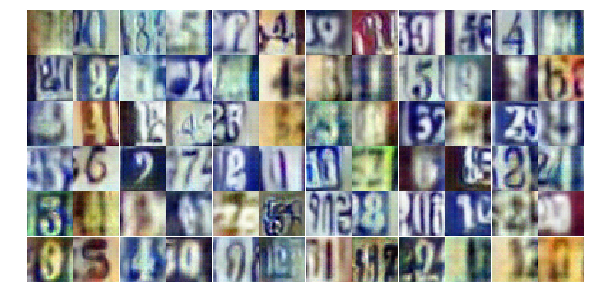

Epoch 22/25... Discriminator Loss: 0.9833... Generator Loss: 2.0656
Epoch 22/25... Discriminator Loss: 0.4374... Generator Loss: 1.7562
Epoch 22/25... Discriminator Loss: 0.5671... Generator Loss: 1.5805
Epoch 22/25... Discriminator Loss: 0.4221... Generator Loss: 1.6772
Epoch 22/25... Discriminator Loss: 0.3898... Generator Loss: 2.0326
Epoch 22/25... Discriminator Loss: 0.3916... Generator Loss: 1.8966
Epoch 22/25... Discriminator Loss: 0.4025... Generator Loss: 1.6325
Epoch 22/25... Discriminator Loss: 0.6294... Generator Loss: 1.2986
Epoch 22/25... Discriminator Loss: 0.7241... Generator Loss: 2.6968
Epoch 22/25... Discriminator Loss: 1.6428... Generator Loss: 0.4630


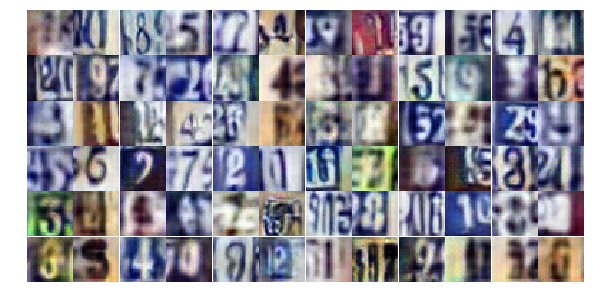

Epoch 22/25... Discriminator Loss: 0.7956... Generator Loss: 1.1192
Epoch 22/25... Discriminator Loss: 0.6249... Generator Loss: 1.6121
Epoch 22/25... Discriminator Loss: 0.3275... Generator Loss: 2.0101
Epoch 22/25... Discriminator Loss: 1.5366... Generator Loss: 0.4606
Epoch 22/25... Discriminator Loss: 1.5252... Generator Loss: 0.7081
Epoch 22/25... Discriminator Loss: 1.1732... Generator Loss: 2.2617
Epoch 22/25... Discriminator Loss: 0.9561... Generator Loss: 0.8931
Epoch 22/25... Discriminator Loss: 0.3626... Generator Loss: 2.5269
Epoch 22/25... Discriminator Loss: 1.8598... Generator Loss: 0.3978
Epoch 22/25... Discriminator Loss: 1.2011... Generator Loss: 0.6488


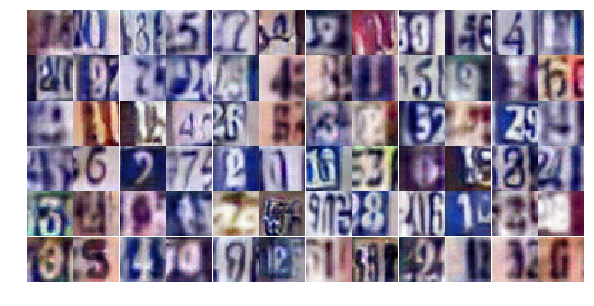

Epoch 23/25... Discriminator Loss: 0.9093... Generator Loss: 0.8876
Epoch 23/25... Discriminator Loss: 0.5323... Generator Loss: 1.6156
Epoch 23/25... Discriminator Loss: 1.4581... Generator Loss: 0.6596
Epoch 23/25... Discriminator Loss: 1.1822... Generator Loss: 1.1467
Epoch 23/25... Discriminator Loss: 0.8433... Generator Loss: 1.7812
Epoch 23/25... Discriminator Loss: 2.3795... Generator Loss: 0.2528
Epoch 23/25... Discriminator Loss: 1.5128... Generator Loss: 0.6587
Epoch 23/25... Discriminator Loss: 1.4810... Generator Loss: 0.4432
Epoch 23/25... Discriminator Loss: 0.9569... Generator Loss: 0.8688
Epoch 23/25... Discriminator Loss: 0.4861... Generator Loss: 1.7974


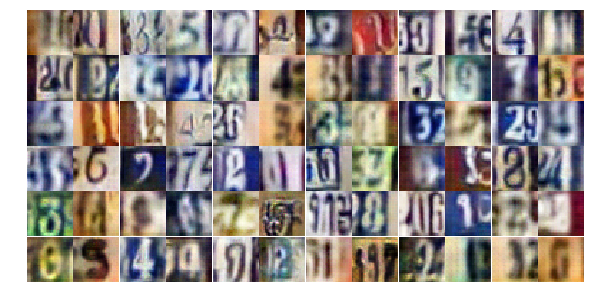

Epoch 23/25... Discriminator Loss: 1.0541... Generator Loss: 0.7877
Epoch 23/25... Discriminator Loss: 0.7174... Generator Loss: 1.0000
Epoch 23/25... Discriminator Loss: 0.7901... Generator Loss: 0.9128
Epoch 23/25... Discriminator Loss: 0.5800... Generator Loss: 1.4300
Epoch 23/25... Discriminator Loss: 0.4087... Generator Loss: 2.1461
Epoch 23/25... Discriminator Loss: 0.8942... Generator Loss: 0.8997
Epoch 23/25... Discriminator Loss: 0.9061... Generator Loss: 0.9055
Epoch 23/25... Discriminator Loss: 1.4237... Generator Loss: 0.5187
Epoch 23/25... Discriminator Loss: 1.3043... Generator Loss: 0.5892
Epoch 23/25... Discriminator Loss: 1.1815... Generator Loss: 0.6671


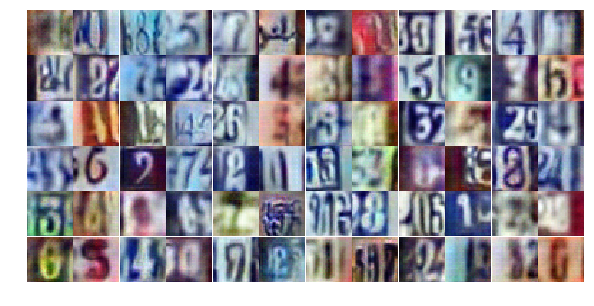

Epoch 23/25... Discriminator Loss: 1.7559... Generator Loss: 0.4327
Epoch 23/25... Discriminator Loss: 0.3931... Generator Loss: 2.1931
Epoch 23/25... Discriminator Loss: 2.2544... Generator Loss: 0.2807
Epoch 23/25... Discriminator Loss: 1.0326... Generator Loss: 0.8491
Epoch 23/25... Discriminator Loss: 1.3503... Generator Loss: 0.6789
Epoch 23/25... Discriminator Loss: 1.1573... Generator Loss: 0.7890
Epoch 23/25... Discriminator Loss: 1.8711... Generator Loss: 0.3973
Epoch 23/25... Discriminator Loss: 1.1760... Generator Loss: 0.7261
Epoch 23/25... Discriminator Loss: 0.7811... Generator Loss: 1.3943
Epoch 23/25... Discriminator Loss: 1.2385... Generator Loss: 2.5971


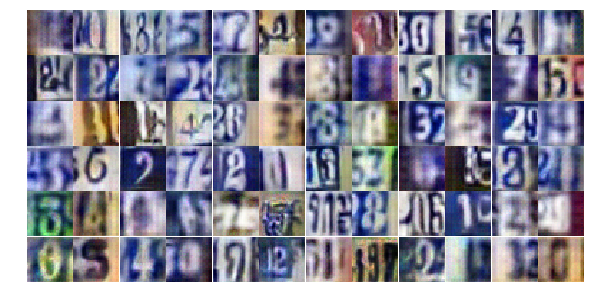

Epoch 23/25... Discriminator Loss: 1.3338... Generator Loss: 0.5952
Epoch 23/25... Discriminator Loss: 0.8212... Generator Loss: 1.1068
Epoch 23/25... Discriminator Loss: 0.5436... Generator Loss: 1.5038
Epoch 23/25... Discriminator Loss: 0.7754... Generator Loss: 1.4735
Epoch 23/25... Discriminator Loss: 0.8120... Generator Loss: 1.3906
Epoch 23/25... Discriminator Loss: 1.3493... Generator Loss: 0.5742
Epoch 23/25... Discriminator Loss: 1.3909... Generator Loss: 0.5236
Epoch 23/25... Discriminator Loss: 0.2067... Generator Loss: 2.6230
Epoch 23/25... Discriminator Loss: 0.5972... Generator Loss: 2.6825
Epoch 23/25... Discriminator Loss: 1.0319... Generator Loss: 0.9040


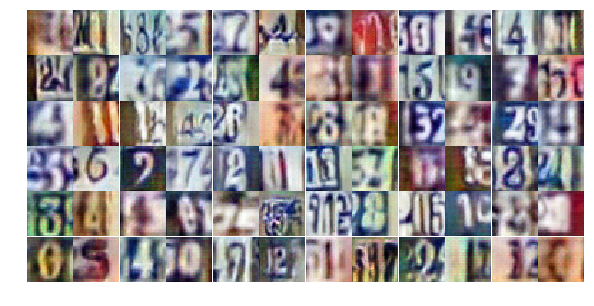

Epoch 23/25... Discriminator Loss: 0.8847... Generator Loss: 1.2465
Epoch 23/25... Discriminator Loss: 0.8307... Generator Loss: 1.0420
Epoch 23/25... Discriminator Loss: 0.7713... Generator Loss: 1.2953
Epoch 23/25... Discriminator Loss: 0.8130... Generator Loss: 1.1288
Epoch 23/25... Discriminator Loss: 1.0166... Generator Loss: 1.0136
Epoch 23/25... Discriminator Loss: 1.4708... Generator Loss: 0.6360
Epoch 23/25... Discriminator Loss: 0.3500... Generator Loss: 2.2966
Epoch 23/25... Discriminator Loss: 0.9019... Generator Loss: 1.1436
Epoch 23/25... Discriminator Loss: 0.7811... Generator Loss: 1.0482
Epoch 23/25... Discriminator Loss: 0.3197... Generator Loss: 2.4114


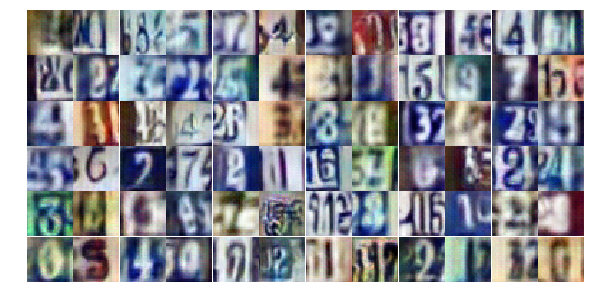

Epoch 23/25... Discriminator Loss: 1.0518... Generator Loss: 2.4024
Epoch 23/25... Discriminator Loss: 2.1919... Generator Loss: 0.2431
Epoch 23/25... Discriminator Loss: 1.8030... Generator Loss: 0.4408
Epoch 23/25... Discriminator Loss: 0.7691... Generator Loss: 1.0742
Epoch 23/25... Discriminator Loss: 0.9922... Generator Loss: 0.8849
Epoch 23/25... Discriminator Loss: 0.9413... Generator Loss: 0.8771
Epoch 23/25... Discriminator Loss: 1.0866... Generator Loss: 0.8192
Epoch 24/25... Discriminator Loss: 1.2953... Generator Loss: 0.6536
Epoch 24/25... Discriminator Loss: 0.9062... Generator Loss: 1.7337
Epoch 24/25... Discriminator Loss: 1.1206... Generator Loss: 0.8170


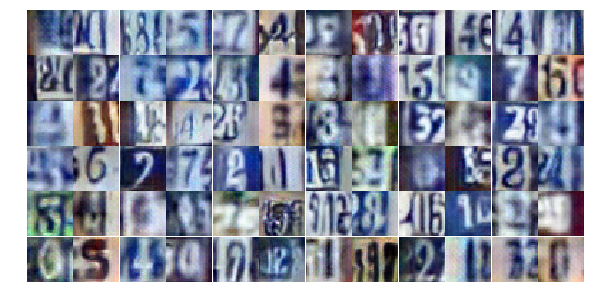

Epoch 24/25... Discriminator Loss: 0.7088... Generator Loss: 1.9853
Epoch 24/25... Discriminator Loss: 0.4835... Generator Loss: 1.6075
Epoch 24/25... Discriminator Loss: 0.5135... Generator Loss: 1.5312
Epoch 24/25... Discriminator Loss: 0.4706... Generator Loss: 2.9532
Epoch 24/25... Discriminator Loss: 0.9313... Generator Loss: 0.8893
Epoch 24/25... Discriminator Loss: 1.2525... Generator Loss: 0.7506
Epoch 24/25... Discriminator Loss: 0.7847... Generator Loss: 1.3325
Epoch 24/25... Discriminator Loss: 1.8647... Generator Loss: 0.4480
Epoch 24/25... Discriminator Loss: 0.2266... Generator Loss: 2.4003
Epoch 24/25... Discriminator Loss: 1.1835... Generator Loss: 0.6274


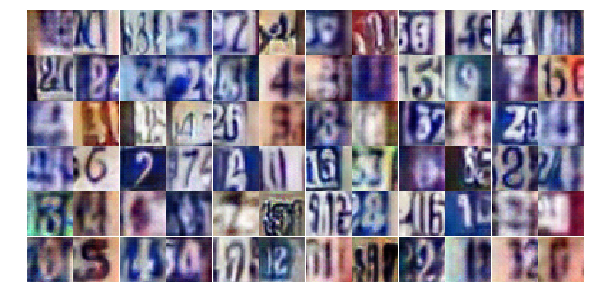

Epoch 24/25... Discriminator Loss: 2.2855... Generator Loss: 0.2843
Epoch 24/25... Discriminator Loss: 0.7768... Generator Loss: 1.7117
Epoch 24/25... Discriminator Loss: 1.5632... Generator Loss: 0.4972
Epoch 24/25... Discriminator Loss: 0.2508... Generator Loss: 2.3192
Epoch 24/25... Discriminator Loss: 0.2451... Generator Loss: 2.2513
Epoch 24/25... Discriminator Loss: 0.9490... Generator Loss: 1.0480
Epoch 24/25... Discriminator Loss: 1.1588... Generator Loss: 0.7768
Epoch 24/25... Discriminator Loss: 1.2053... Generator Loss: 0.6270
Epoch 24/25... Discriminator Loss: 2.0469... Generator Loss: 0.3453
Epoch 24/25... Discriminator Loss: 1.9573... Generator Loss: 0.3512


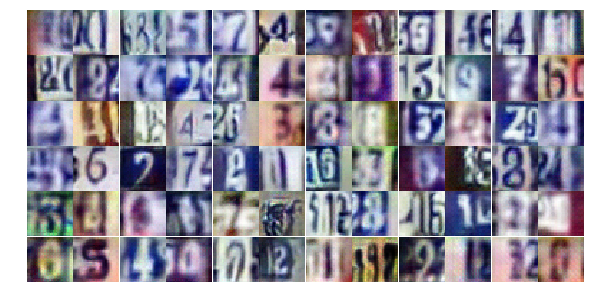

Epoch 24/25... Discriminator Loss: 0.6946... Generator Loss: 1.2950
Epoch 24/25... Discriminator Loss: 1.0647... Generator Loss: 0.9584
Epoch 24/25... Discriminator Loss: 0.9628... Generator Loss: 0.8503
Epoch 24/25... Discriminator Loss: 2.4773... Generator Loss: 0.3004
Epoch 24/25... Discriminator Loss: 0.6437... Generator Loss: 1.5545
Epoch 24/25... Discriminator Loss: 0.5224... Generator Loss: 1.3626
Epoch 24/25... Discriminator Loss: 0.2624... Generator Loss: 2.3268
Epoch 24/25... Discriminator Loss: 1.0302... Generator Loss: 0.9851
Epoch 24/25... Discriminator Loss: 0.8055... Generator Loss: 1.1834
Epoch 24/25... Discriminator Loss: 0.6238... Generator Loss: 1.3039


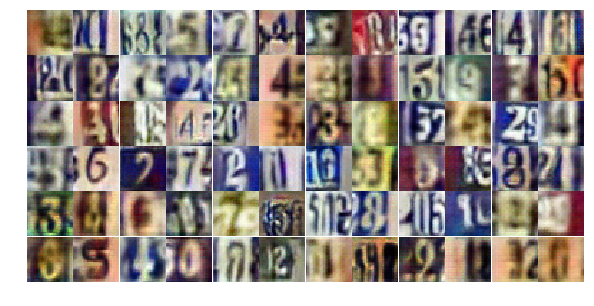

Epoch 24/25... Discriminator Loss: 0.1331... Generator Loss: 3.0661
Epoch 24/25... Discriminator Loss: 0.3273... Generator Loss: 2.0916
Epoch 24/25... Discriminator Loss: 0.8393... Generator Loss: 1.6891
Epoch 24/25... Discriminator Loss: 1.8431... Generator Loss: 0.4805
Epoch 24/25... Discriminator Loss: 0.7577... Generator Loss: 1.2991
Epoch 24/25... Discriminator Loss: 1.7800... Generator Loss: 0.4381
Epoch 24/25... Discriminator Loss: 1.6530... Generator Loss: 0.4808
Epoch 24/25... Discriminator Loss: 0.9282... Generator Loss: 1.0090
Epoch 24/25... Discriminator Loss: 1.1086... Generator Loss: 0.8400
Epoch 24/25... Discriminator Loss: 0.6860... Generator Loss: 1.2193


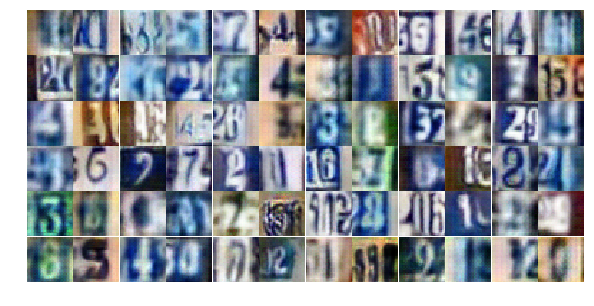

Epoch 24/25... Discriminator Loss: 0.8925... Generator Loss: 1.0433
Epoch 24/25... Discriminator Loss: 0.9158... Generator Loss: 2.5004
Epoch 24/25... Discriminator Loss: 2.0036... Generator Loss: 2.7734
Epoch 24/25... Discriminator Loss: 1.0822... Generator Loss: 1.1818
Epoch 24/25... Discriminator Loss: 2.1459... Generator Loss: 0.3107
Epoch 24/25... Discriminator Loss: 0.5711... Generator Loss: 1.6840
Epoch 24/25... Discriminator Loss: 0.4622... Generator Loss: 2.2160
Epoch 24/25... Discriminator Loss: 2.2118... Generator Loss: 5.2752
Epoch 24/25... Discriminator Loss: 1.4297... Generator Loss: 0.6323
Epoch 24/25... Discriminator Loss: 2.0352... Generator Loss: 0.2959


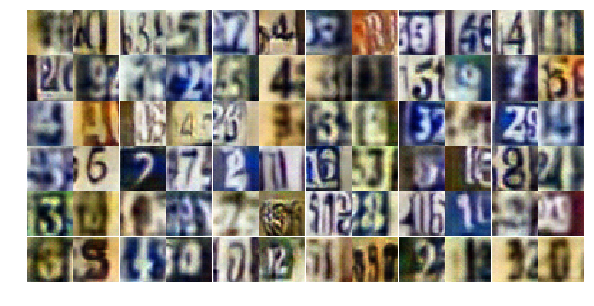

Epoch 24/25... Discriminator Loss: 1.2062... Generator Loss: 0.7425
Epoch 24/25... Discriminator Loss: 1.4482... Generator Loss: 0.6176
Epoch 24/25... Discriminator Loss: 0.9490... Generator Loss: 0.9666
Epoch 24/25... Discriminator Loss: 0.8101... Generator Loss: 0.9957
Epoch 24/25... Discriminator Loss: 1.1927... Generator Loss: 0.6813
Epoch 25/25... Discriminator Loss: 0.8599... Generator Loss: 1.0171
Epoch 25/25... Discriminator Loss: 0.4860... Generator Loss: 1.9248
Epoch 25/25... Discriminator Loss: 1.1563... Generator Loss: 0.9028
Epoch 25/25... Discriminator Loss: 0.7795... Generator Loss: 1.2910
Epoch 25/25... Discriminator Loss: 0.5156... Generator Loss: 1.6663


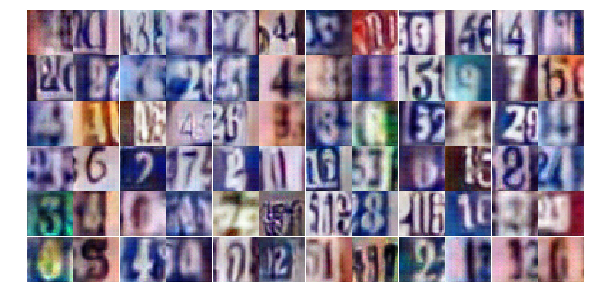

Epoch 25/25... Discriminator Loss: 0.7953... Generator Loss: 1.5969
Epoch 25/25... Discriminator Loss: 1.4144... Generator Loss: 0.5609
Epoch 25/25... Discriminator Loss: 0.9577... Generator Loss: 0.9305
Epoch 25/25... Discriminator Loss: 0.8002... Generator Loss: 1.7812
Epoch 25/25... Discriminator Loss: 0.6116... Generator Loss: 2.5743
Epoch 25/25... Discriminator Loss: 0.9492... Generator Loss: 0.9375
Epoch 25/25... Discriminator Loss: 1.4022... Generator Loss: 0.5355
Epoch 25/25... Discriminator Loss: 0.9617... Generator Loss: 0.9065
Epoch 25/25... Discriminator Loss: 0.7152... Generator Loss: 1.3215
Epoch 25/25... Discriminator Loss: 0.7609... Generator Loss: 1.4475


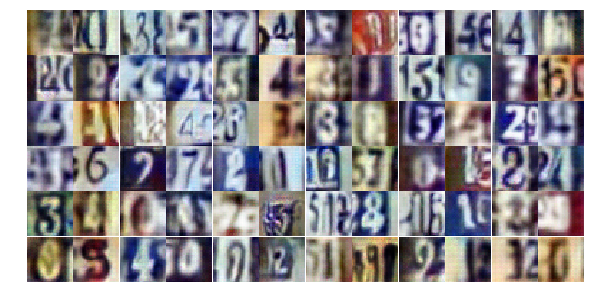

Epoch 25/25... Discriminator Loss: 0.6572... Generator Loss: 1.3177
Epoch 25/25... Discriminator Loss: 0.5183... Generator Loss: 1.7412
Epoch 25/25... Discriminator Loss: 0.8173... Generator Loss: 1.0812
Epoch 25/25... Discriminator Loss: 1.7053... Generator Loss: 0.4242
Epoch 25/25... Discriminator Loss: 0.5571... Generator Loss: 1.3579
Epoch 25/25... Discriminator Loss: 0.7741... Generator Loss: 1.0917
Epoch 25/25... Discriminator Loss: 0.8311... Generator Loss: 1.0482
Epoch 25/25... Discriminator Loss: 1.2628... Generator Loss: 0.8109
Epoch 25/25... Discriminator Loss: 0.5348... Generator Loss: 1.7768
Epoch 25/25... Discriminator Loss: 1.3711... Generator Loss: 0.7399


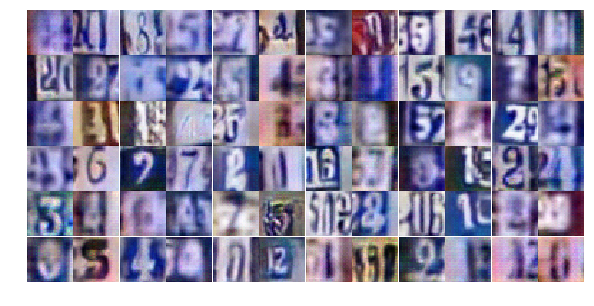

Epoch 25/25... Discriminator Loss: 1.0558... Generator Loss: 0.8238
Epoch 25/25... Discriminator Loss: 0.7032... Generator Loss: 1.1298
Epoch 25/25... Discriminator Loss: 1.6435... Generator Loss: 0.3678
Epoch 25/25... Discriminator Loss: 0.3545... Generator Loss: 2.1084
Epoch 25/25... Discriminator Loss: 2.4193... Generator Loss: 0.3752
Epoch 25/25... Discriminator Loss: 0.6977... Generator Loss: 1.4381
Epoch 25/25... Discriminator Loss: 1.4390... Generator Loss: 0.7583
Epoch 25/25... Discriminator Loss: 1.0995... Generator Loss: 0.7206
Epoch 25/25... Discriminator Loss: 1.1204... Generator Loss: 0.7987
Epoch 25/25... Discriminator Loss: 0.4498... Generator Loss: 1.9046


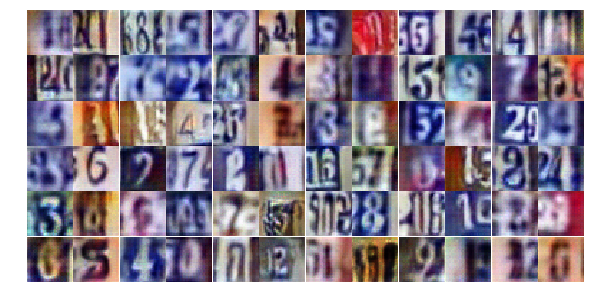

Epoch 25/25... Discriminator Loss: 1.1905... Generator Loss: 0.6419
Epoch 25/25... Discriminator Loss: 0.5528... Generator Loss: 1.5884
Epoch 25/25... Discriminator Loss: 0.3350... Generator Loss: 2.7995
Epoch 25/25... Discriminator Loss: 0.8215... Generator Loss: 0.9891
Epoch 25/25... Discriminator Loss: 1.6830... Generator Loss: 0.5071
Epoch 25/25... Discriminator Loss: 0.5812... Generator Loss: 1.5050
Epoch 25/25... Discriminator Loss: 0.6665... Generator Loss: 1.1900
Epoch 25/25... Discriminator Loss: 0.8311... Generator Loss: 1.0780
Epoch 25/25... Discriminator Loss: 0.7063... Generator Loss: 1.4676
Epoch 25/25... Discriminator Loss: 0.5883... Generator Loss: 1.5430


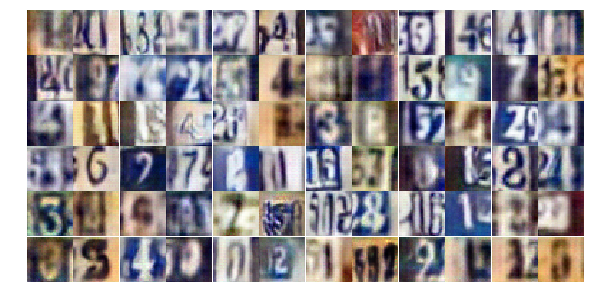

Epoch 25/25... Discriminator Loss: 0.7445... Generator Loss: 1.2104
Epoch 25/25... Discriminator Loss: 1.4836... Generator Loss: 0.6297
Epoch 25/25... Discriminator Loss: 0.9831... Generator Loss: 2.4131
Epoch 25/25... Discriminator Loss: 2.2670... Generator Loss: 0.3773
Epoch 25/25... Discriminator Loss: 1.9800... Generator Loss: 0.3633
Epoch 25/25... Discriminator Loss: 0.6419... Generator Loss: 2.3950
Epoch 25/25... Discriminator Loss: 2.6110... Generator Loss: 0.2405
Epoch 25/25... Discriminator Loss: 1.7360... Generator Loss: 0.4843
Epoch 25/25... Discriminator Loss: 0.8629... Generator Loss: 0.9329
Epoch 25/25... Discriminator Loss: 1.1052... Generator Loss: 0.8994


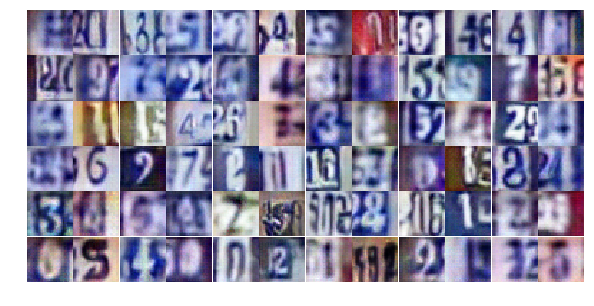

Epoch 25/25... Discriminator Loss: 0.3452... Generator Loss: 2.0849
Epoch 25/25... Discriminator Loss: 1.7137... Generator Loss: 0.4786


In [28]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

In [ ]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

In [ ]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))